Notes:

First: Is there a way to see if an image is "inverted" without using ML
Can plot "features" to see if the image is inverted or not

Can ML be used to better identify quantity of scales?

TODO: also figure out a way of reducing the number of scales

Using statistics run hypothesis tests

Overview:

    The goal of this project is to create a tool that can automatically count the number of scales in an image of anoles skin. So far out approach has been one of an initial Image Segmentation: analysis of the data collected from that intial image segmentation through attention to the mean of the scale size and the number of scales. After that,we preform an adaptive segmentation choosing a block size based on the original data analysis.
    
OTSU SEGMENTAION:

    It is an algorithm returns a single intensity threshold that separate pixels into two classes, foreground and background. The way OTSU does this is by iterating through all possible threshold values. It chooses the threshold value that minimizes the sum spread of the color values of the forground and the background after the spread of the forground and background have been multipled by their respective weights (the weights show what percentage of the image the forground and background occupy per threshold) This value is called the Within Class Variance.

<img src="Otsu_visualization1.png"> 
   
MORE:

    The main issue with OTSU is that there seems to be a huge amount of noise. OTSU also does not seem to work well for images where that due to image quality are much darker in some places and much lighter in others: in such cases OTSU is unable to distinguish bettween the foregorund and background in those darker regions and gives usually an undercount. The thresholding errors can be seen with the following images. 
    
    OTSU is a type of simple thresholding: "in simple thresholding, the threshold value is global, i.e., it is same for all the pixels in the image. Adaptive thresholding is the method where the threshold value is calculated for smaller regions and therefore, there will be different threshold values for different regions." "The assumption behind local thresholding is that smaller image regions are more likely to have approximately uniform illumination, thus being more suitable for thresholding."

OTHER TYPES OF THRESHOLDING ALGORITHIMS:

    Adaptive thesholdhing divides the image into subpart/neigborhoods and then applies either a ADAPTIVE_THRESH_MEAN or ADAPTIVE_THRESH_GAUSSIAN to the image: it either takes the mean pixel value of the neighborhood and uses it as the threshold values or takes the weighted sum of the pixel values. This is still not ideal: the neighborhood size has to be chosen carefully. Big niegborhoods may ignore the need for adaptive thresholding in the first place and result in the same issues that OTSU has with images that have uneven illumination. Small neighborhoods can result in a broken up image and in the case of scales, an overcount.
    



Data that may be useful to collect:
    The uniformity of the scales OTSU is able to detect
        - Can be measured by the SD of the distance between the scales: Can plot this
        - The SD of the size of the scales
        - 

The following code creates a heat map for each of the images. It attempts to see the distribution: the density, of the dots.

In [1]:
import cv2
import numpy as np
from datascience import *
import matplotlib as mpl
from matplotlib import pyplot as plt
import sys
import os
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi'] = 120
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
import pandas

In [2]:
images = []
labeled_imgs = []
original_img = []
original_img1 = []
filter_img = []
image_names = []

In [3]:
#access img directory
dirname = 'Anolis_cristatellus_images/'


#create an iterator object for img directory
directory = os.scandir(dirname)

In [4]:
def invert(img):
    return cv2.bitwise_not(img)

In [14]:
#a different approach: if image has gradient can we split the image up then merge them together: how would we 
#identify where to split the image? --> for loop
#how to measure "density"

heat_maps = []
for img in directory:
    img_name = img.name
    if (img_name != '.ipynb_checkpoints'):
        print(dirname + img_name + "")
        
        orig_img = cv2.imread(dirname + img_name)
        gray = cv2.cvtColor(orig_img, cv2.COLOR_BGR2GRAY)
        img = gray

        ret, thresh = cv2.threshold(img, 0 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        #true color of image in RGB
        color = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)

        img = thresh
        plt.imshow(img, "gray")
        images.append(img )        

In [15]:

def centroids(img, average_size, stds):
    average_size = []
    sizes_of_scales = []
    num_scales_and_average_size = []
    total_stats = []

    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S) 
    num_labels = output[0]

    # The second cell is the label matrix
    labels = output[1]
    # The third cell is the stat matrix
    stats = output[2]
    # The fourth cell is the centroid matrix
    centroids = output[3]

    sizes_of_scales.append((stats[1:,-1]))
    num_scales_and_average_size.append(([num_labels, np.average(stats[1:,-1])]))
    average_size.append(np.average(stats[1:,-1]))
    total_stats.append([num_labels, stats[1:,-1], stats[1:,-1]])
    
    return average_size, centroids, stats[1:,-1]
    

In [7]:
def heat_map(img, centroids):
    heat = np.zeros(img.shape)    
    img = heat
    for i in range(len(centroids)):## draw pixels
        x = centroids[i][1].astype(int)
        y = centroids[i][0].astype(int)
        heat[x - 3, y - 3] += 200
    return heat

In [8]:
def display(heat_maps):
    for img in heat_maps:
        plt.imshow(img)
    plt.show()

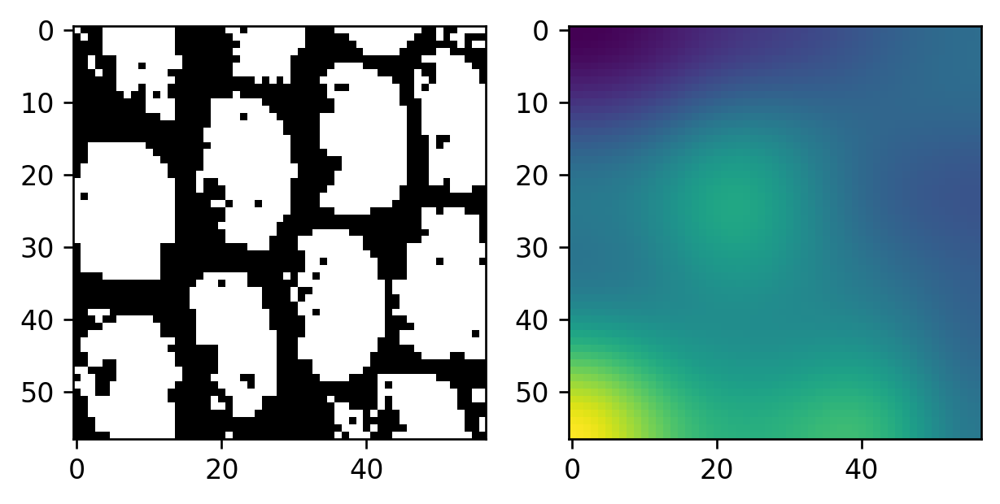

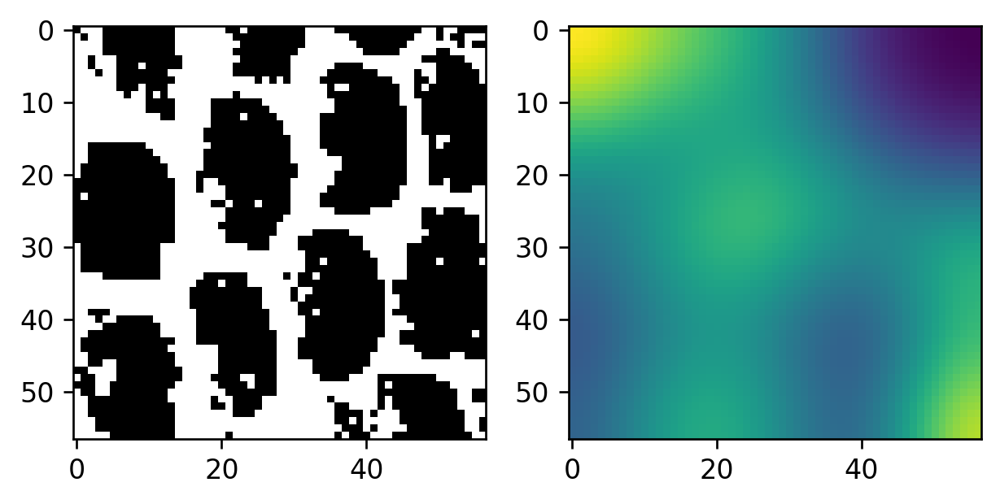

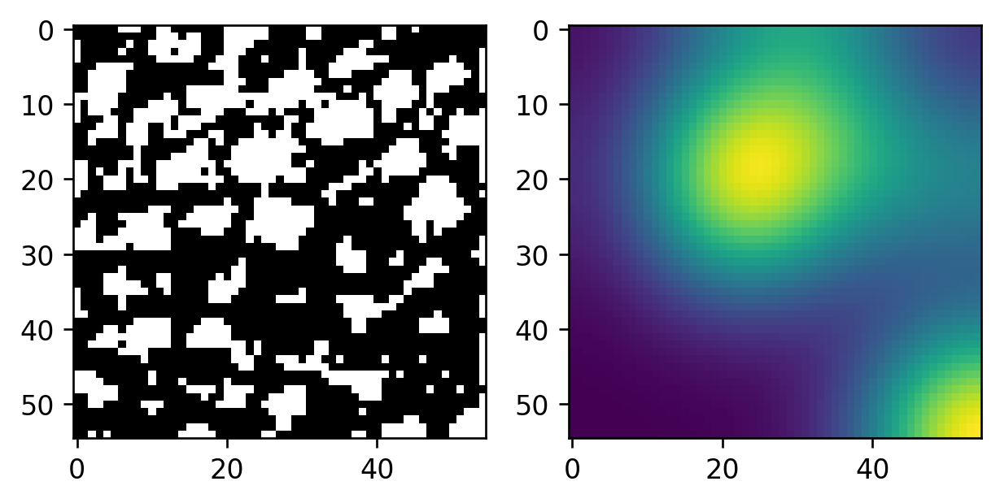

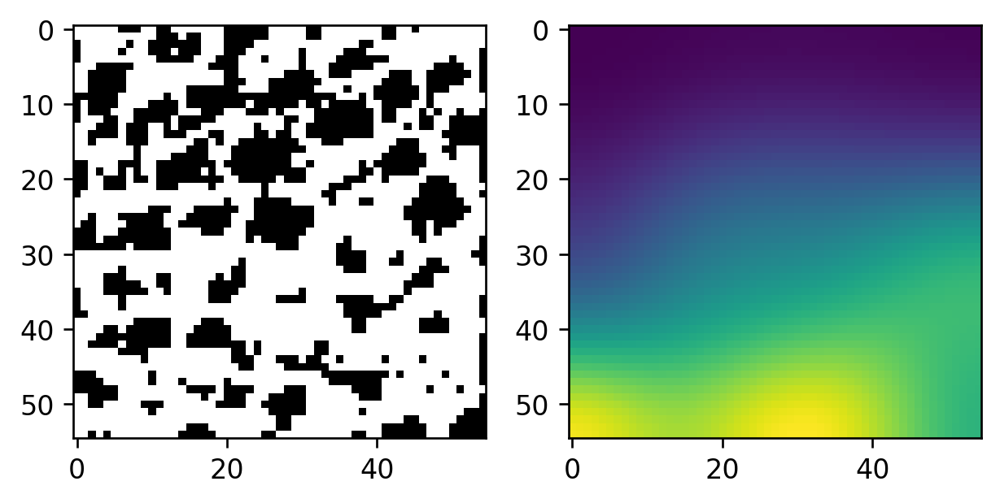

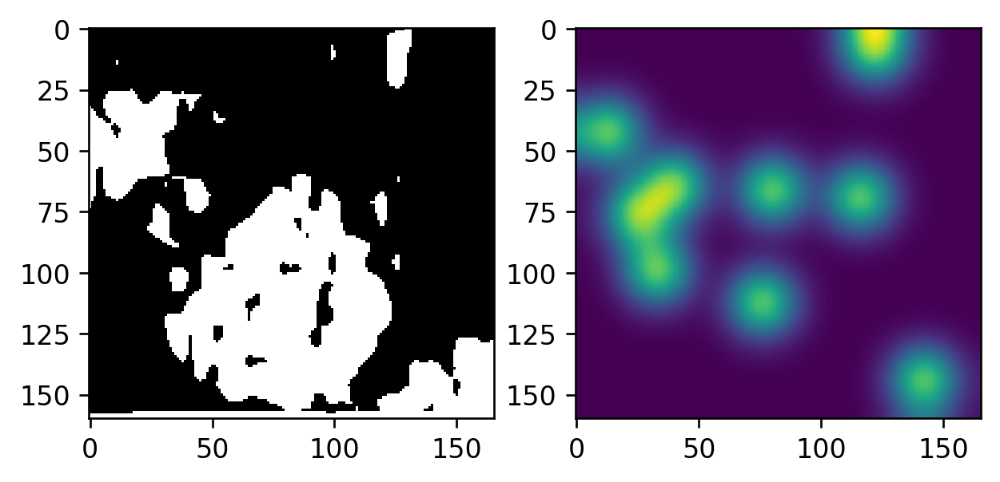

...

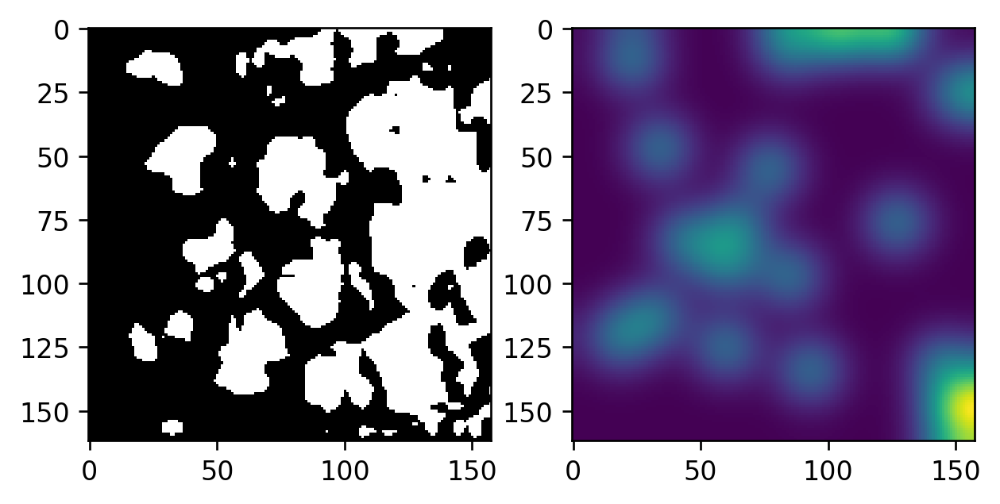

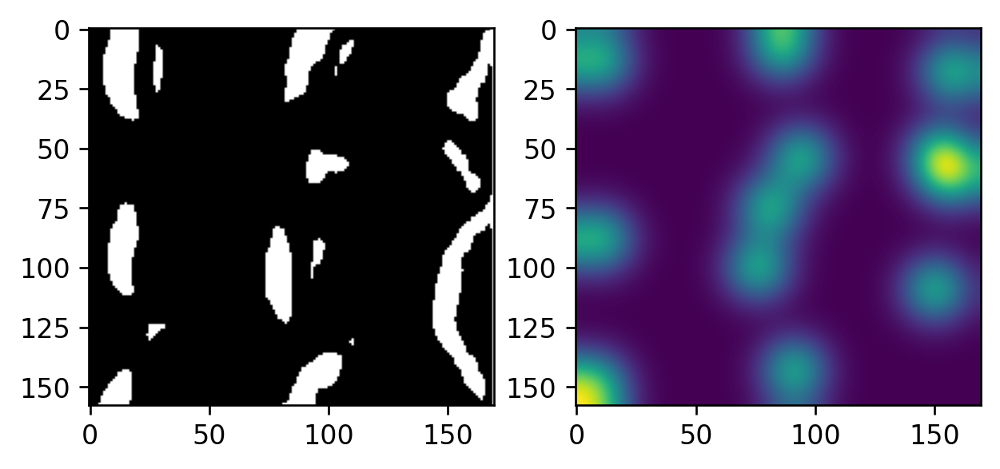

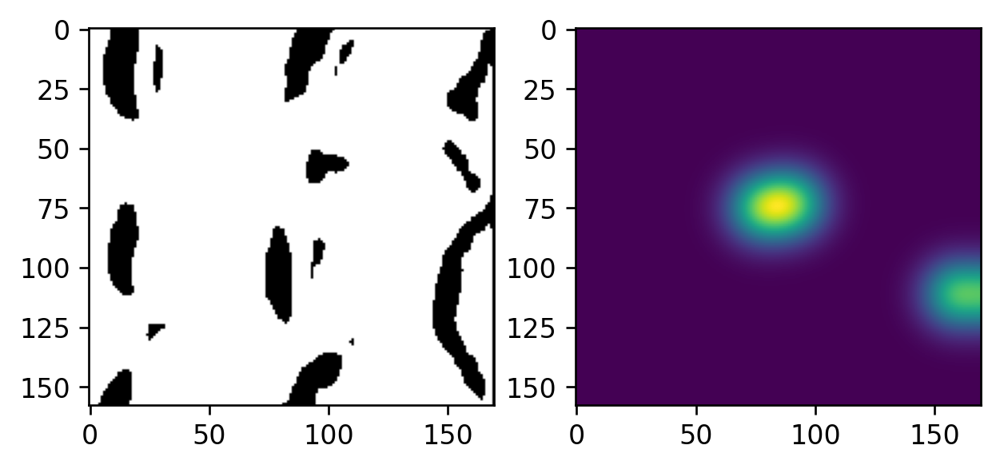

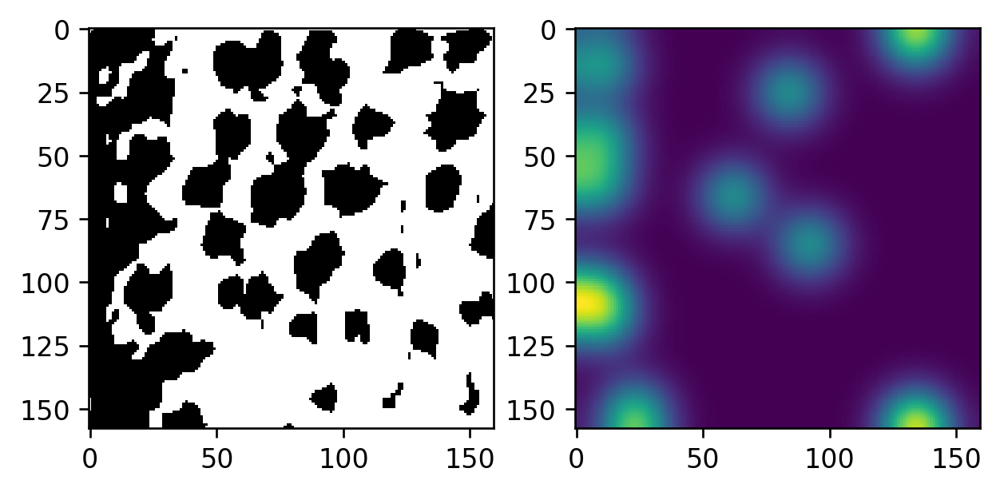

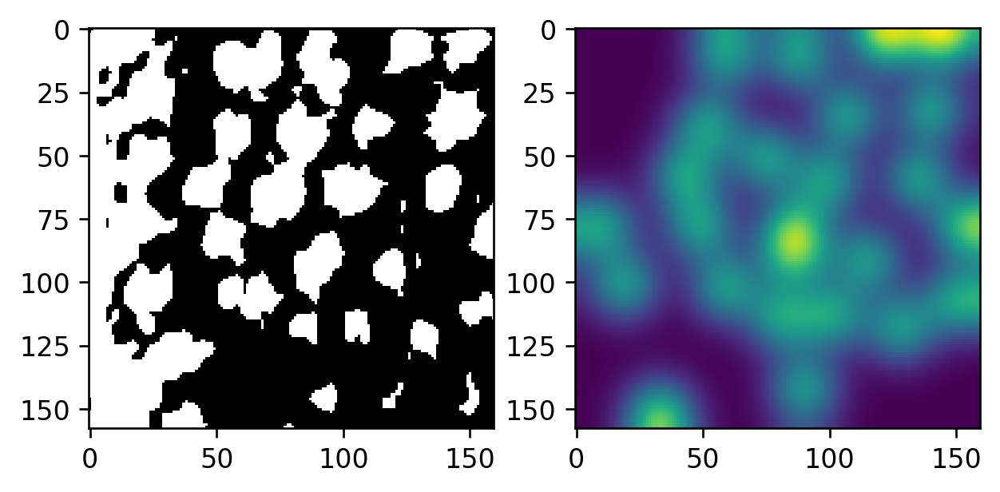

In [19]:
#access img directory
dirname = 'Anolis_cristatellus_images/'

from scipy.ndimage.filters import gaussian_filter

centers = []
inverted_centers = []
thr_images = []
inverted_thr_images = []
average_sizes = []
inverted_average_sizes = []
size_stds = []
inverted_size_stds = []
        
        
#create an iterator object for img directory
directory = os.scandir(dirname)
for img in directory:
    img_name = img.name
    if (img_name != '.ipynb_checkpoints'):
        average_size=[]
        inverted_average_size = []
        size_std = []
        inverted_size_std = []
        
        orig_img = cv2.imread(dirname + img_name)
        inverted_img = invert(orig_img)
        
        gray = cv2.cvtColor(orig_img, cv2.COLOR_BGR2GRAY)
        img = gray
        inverted_img = cv2.cvtColor(inverted_img, cv2.COLOR_BGR2GRAY)

        ret, thresh = cv2.threshold(img, 0 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        kernel = np.ones((3,3),np.uint8)
        
        inverted_ret, inverted_thresh = cv2.threshold(inverted_img, 0 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        kernel = np.ones((3,3),np.uint8)
        

        #if the customized iteration number has not yet been determined this if statement will run

        opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 2)
        inverted_opening = cv2.morphologyEx(inverted_thresh,cv2.MORPH_OPEN,kernel, iterations = 2)


        # sure background area
        sure_bg = cv2.dilate(opening,kernel,iterations=1)
        inverted_sure_bg = cv2.dilate(inverted_opening,kernel,iterations=1)


        dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
        ret, sure_fg = cv2.threshold(dist_transform, 1.5, 255, 0) 
        inverted_dist_transform = cv2.distanceTransform(inverted_opening,cv2.DIST_L2,5)
        inverted_ret, inverted_sure_fg = cv2.threshold(inverted_dist_transform, 1.5, 255, 0) 

        # Finding unknown region
        sure_fg = np.uint8(sure_fg)
        unknown = cv2.subtract(sure_bg,sure_fg)
        inverted_sure_fg = np.uint8(inverted_sure_fg)
        inverted_unknown = cv2.subtract(inverted_sure_bg,inverted_sure_fg)

        average_size, c, size_std = centroids(sure_fg, average_size, size_std)
        inverted_average_size, inverted_c, inverted_size_std = centroids(inverted_sure_fg, inverted_average_size, inverted_size_std)
        average_sizes.append(average_size)
        inverted_average_sizes.append(inverted_average_size)
        size_stds.append(np.std(size_stds))
        inverted_size_stds.append(np.std(inverted_size_stds))

       
        
        hm = heat_map(sure_fg, c)
        inverted_hm = heat_map(inverted_sure_fg, inverted_c)

        
        thr_images.append(thresh)
        inverted_thr_images.append(inverted_thresh)
        
        plt.subplot(1,2,1), plt.imshow(thresh, 'gray')

        hm = gaussian_filter(hm, (10, 10))
        inverted_hm = gaussian_filter(inverted_hm, (10, 10))
        plt.subplot(1,2,2), plt.imshow(hm)
        plt.show()
        plt.subplot(1,2,1), plt.imshow(inverted_thresh, 'gray')
        plt.subplot(1,2,2), plt.imshow(inverted_hm)
        
        centers.append(c)
        inverted_centers.append(inverted_c)
        
        plt.show()



            
            
            


In [20]:
#to see uniformity can look at the distribution of the surrounding points

In [21]:
#ideas?

#split an image until it is uniform??
#Then use that to determine block size?

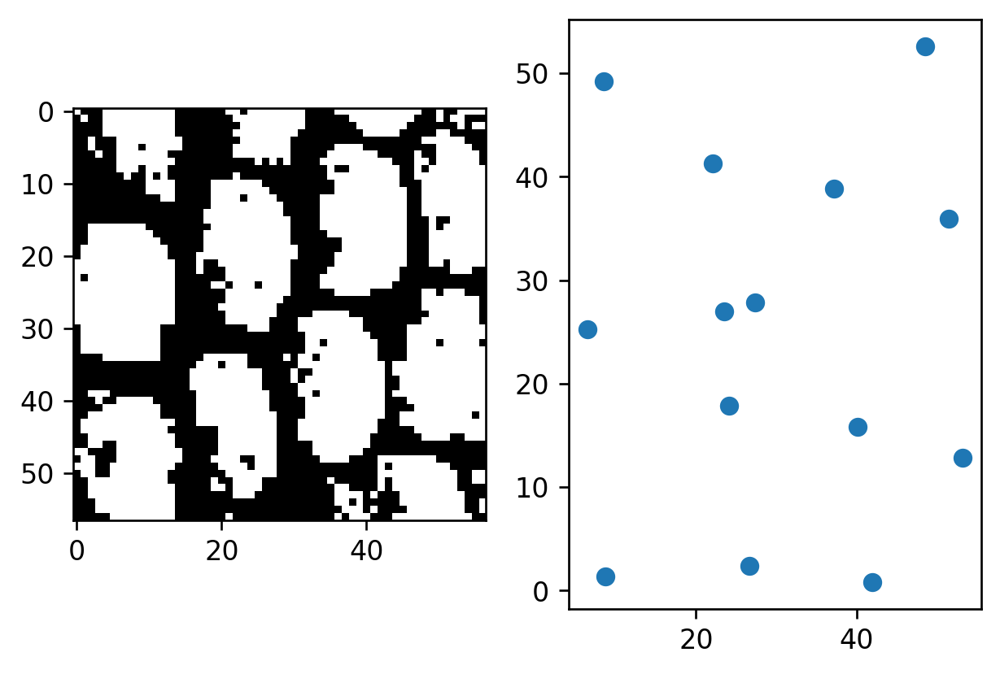

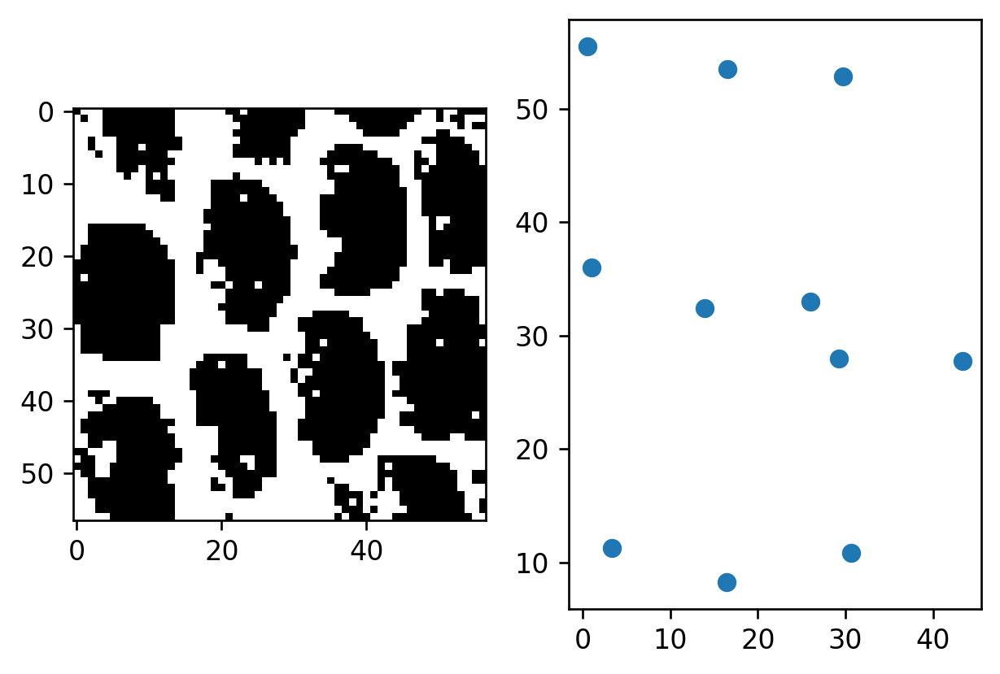

4.316554146291316
[13.247185549746275]
[9.570454660866675]


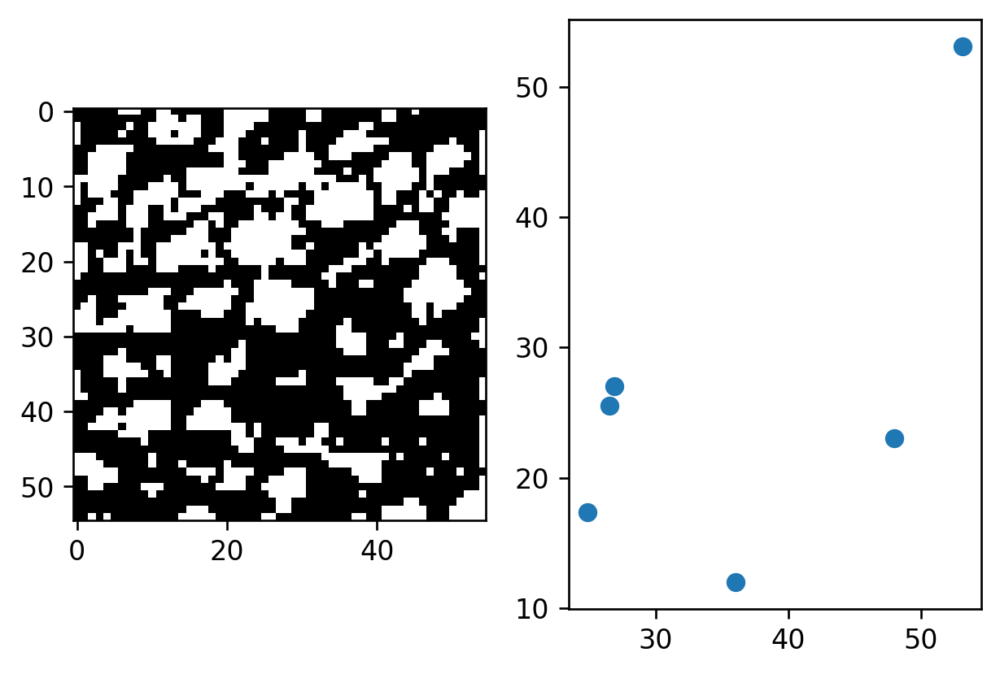

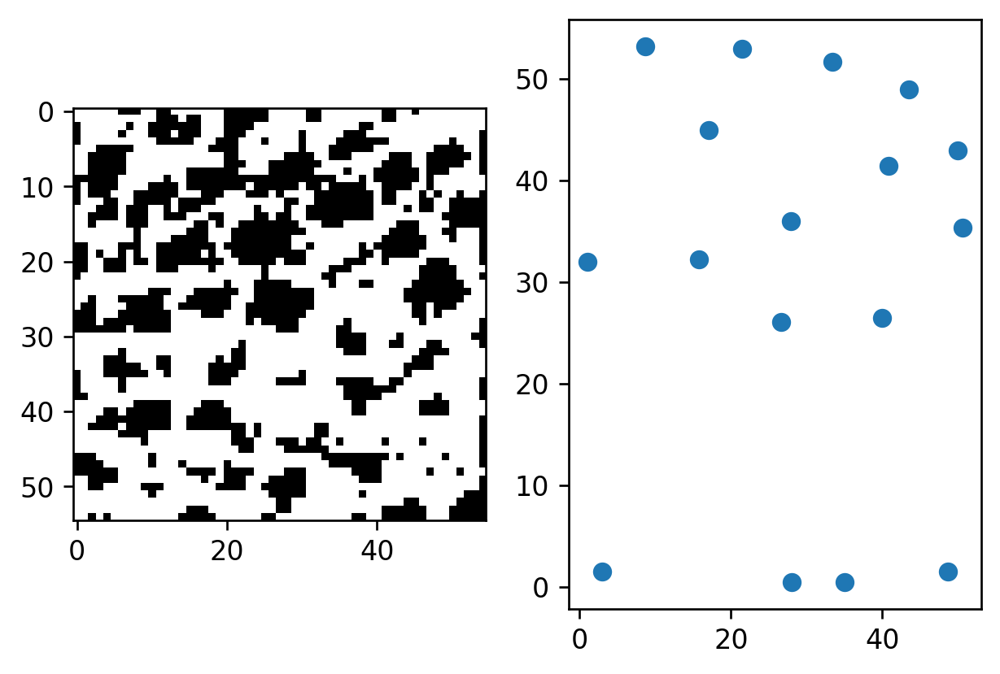

9.938371901100407
[13.247185549746275, 11.788686357456456]
[9.570454660866675, 16.196749921268434]


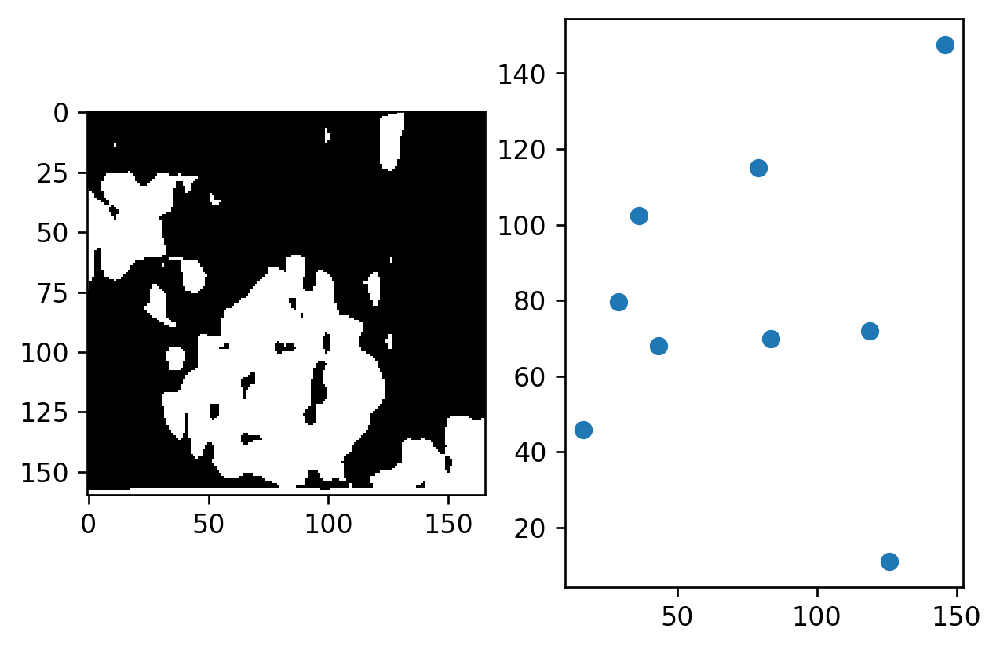

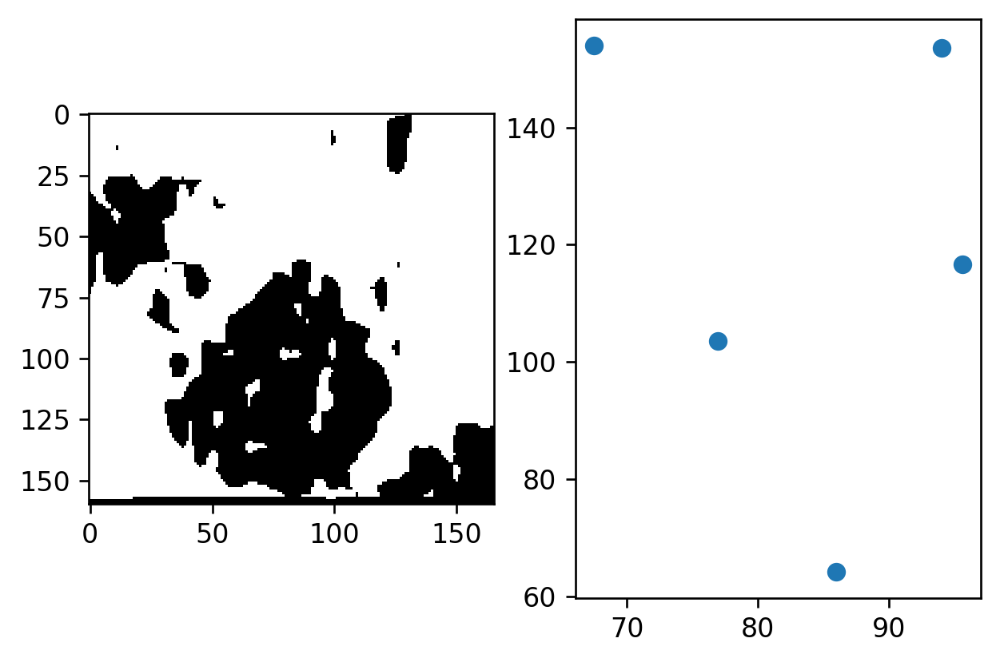

17.849297487930706
[13.247185549746275, 11.788686357456456, 38.59394849705544]
[9.570454660866675, 16.196749921268434, 23.24440056960923]


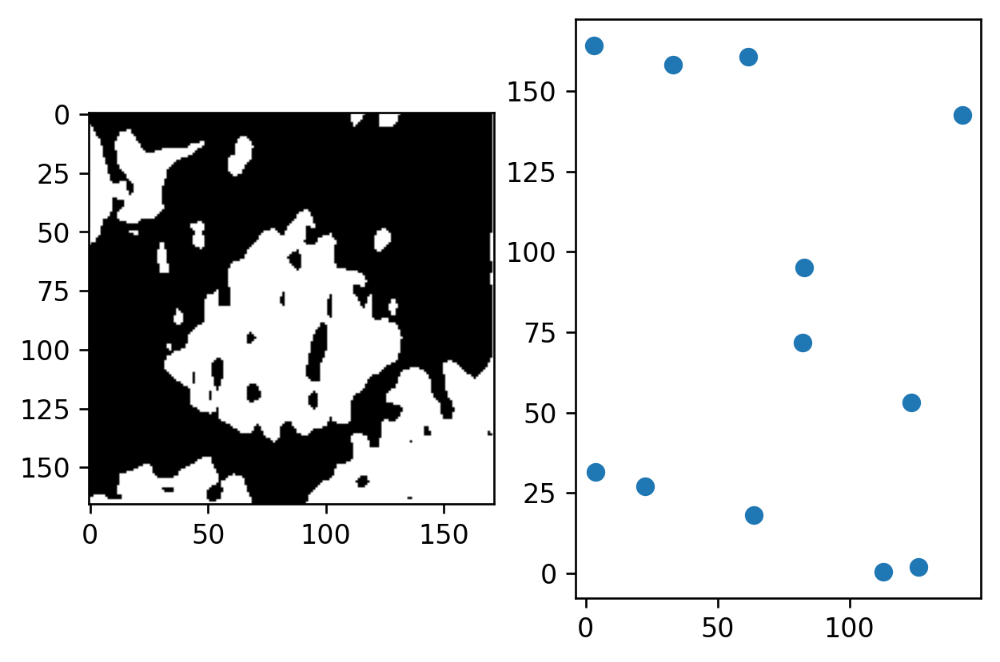

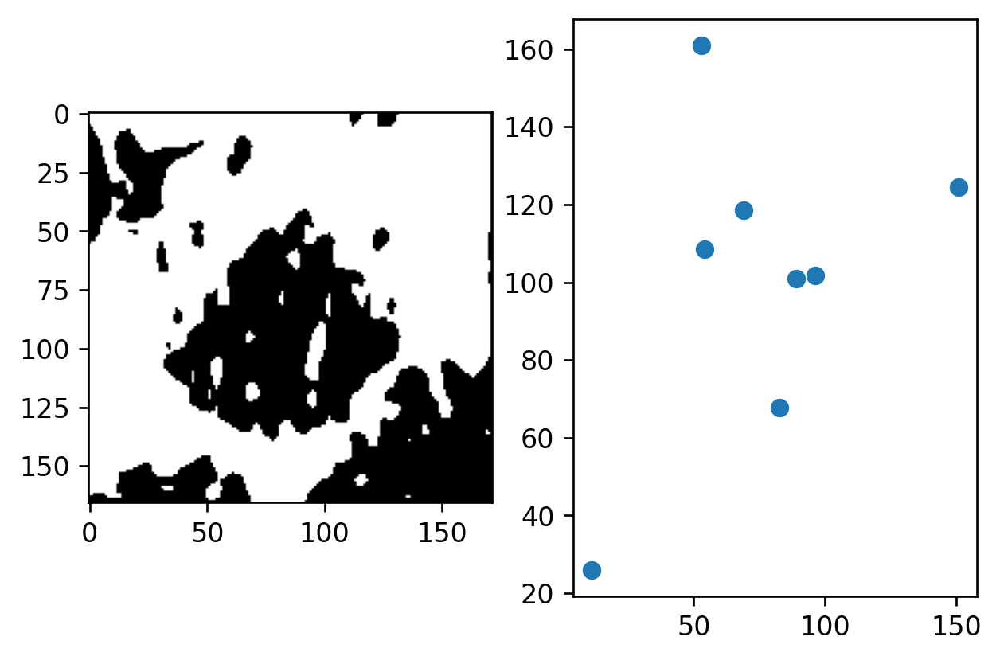

16.858605757152873
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946]


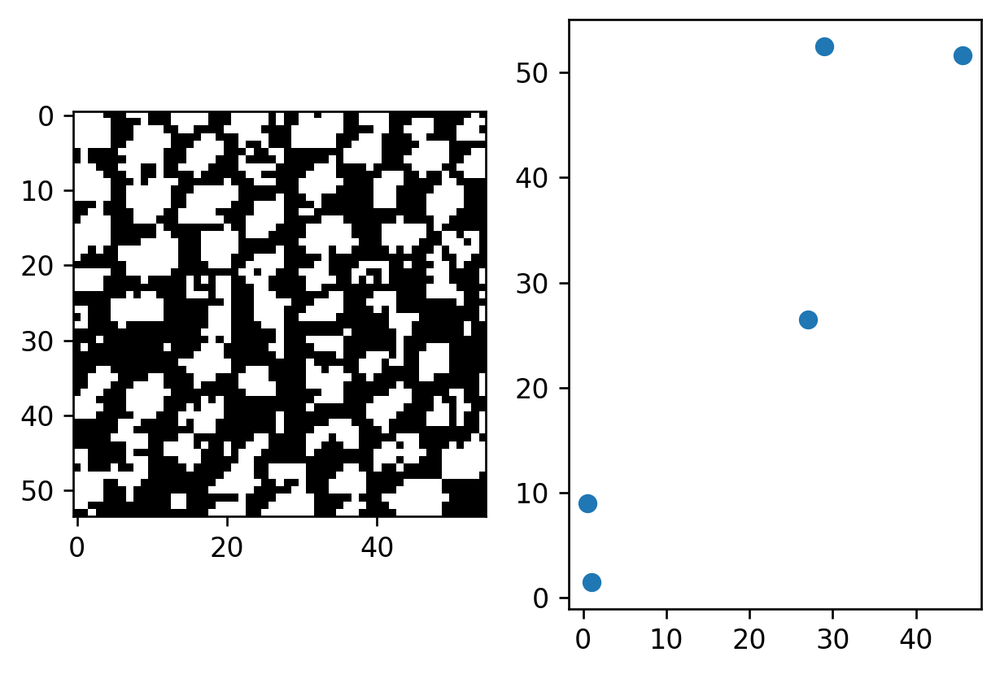

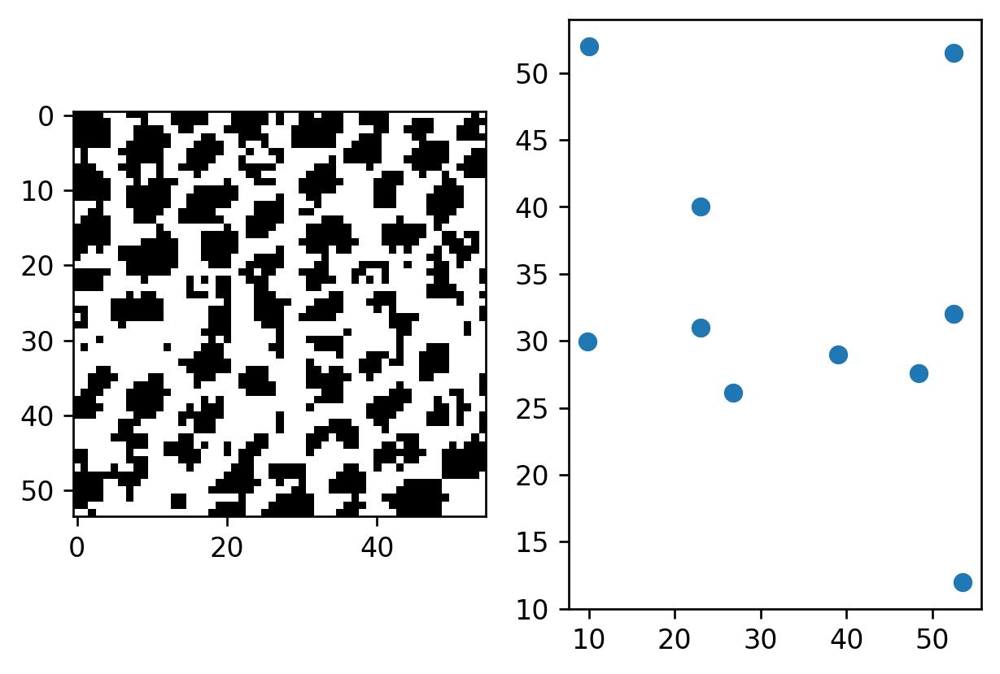

6.9391821069306285
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897]


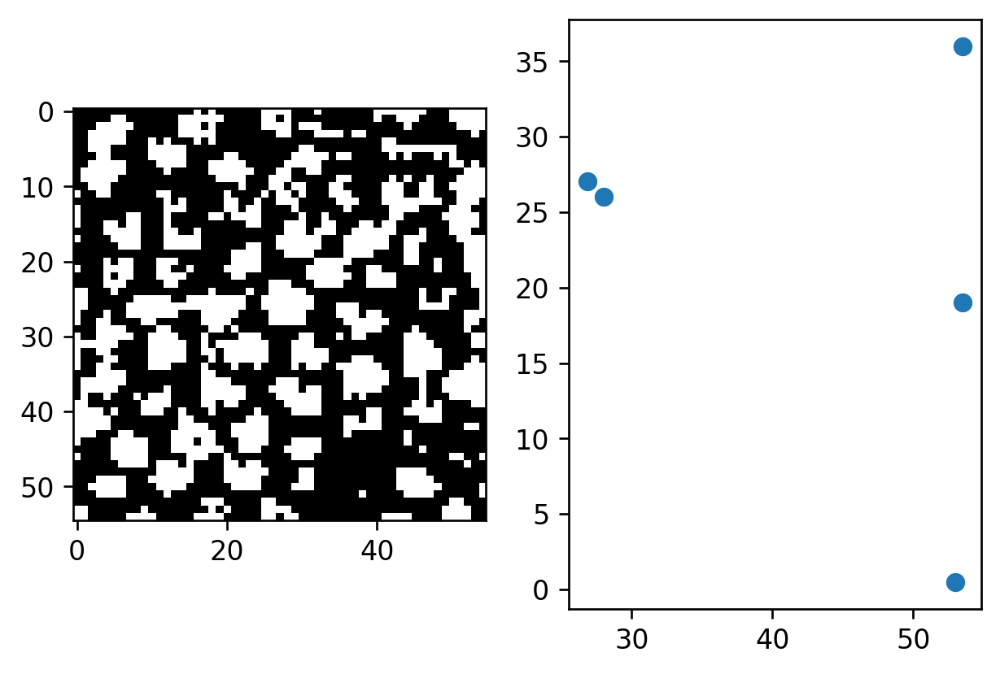

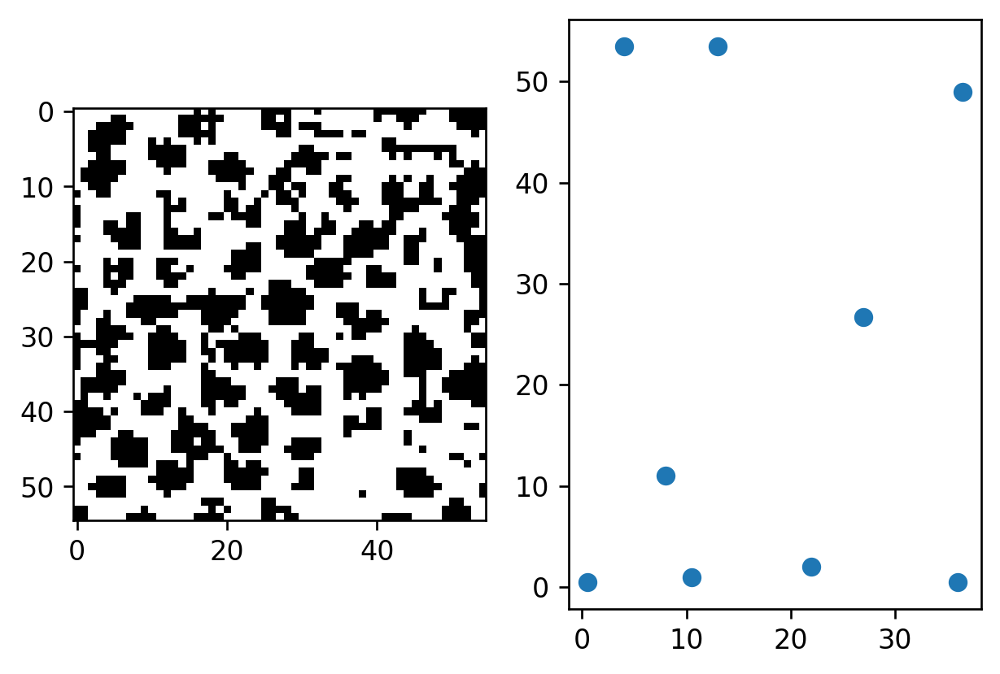

10.27446590550929
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329]


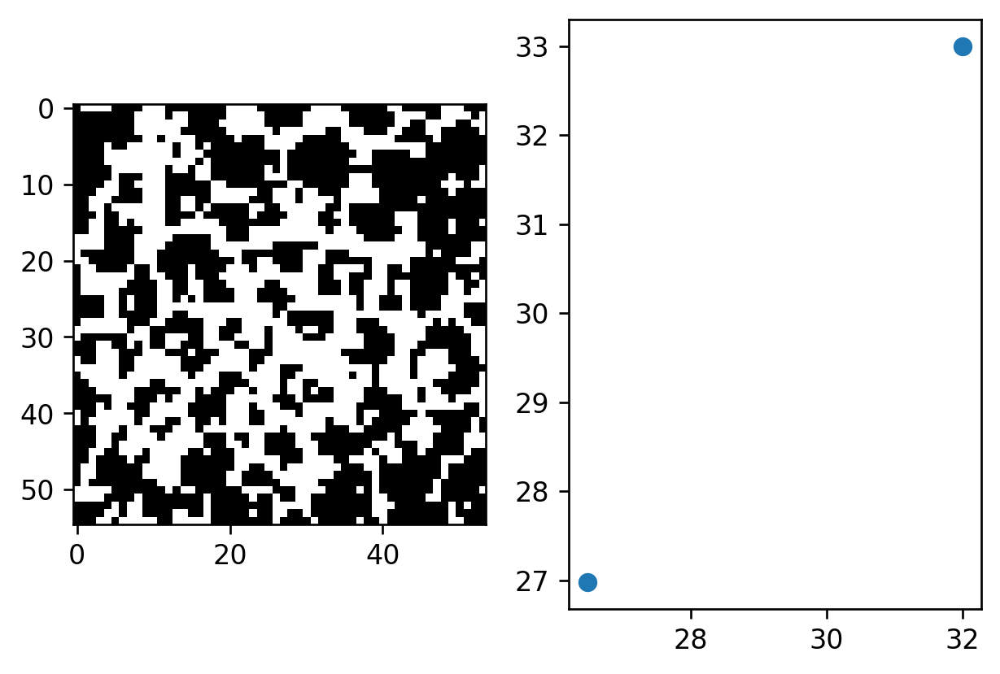

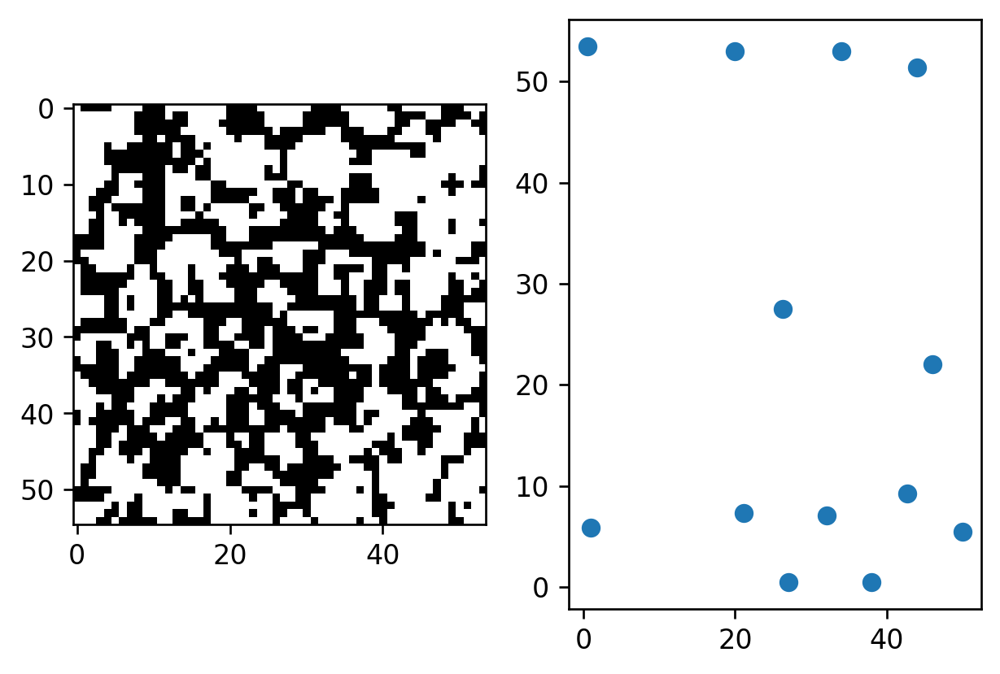

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226]


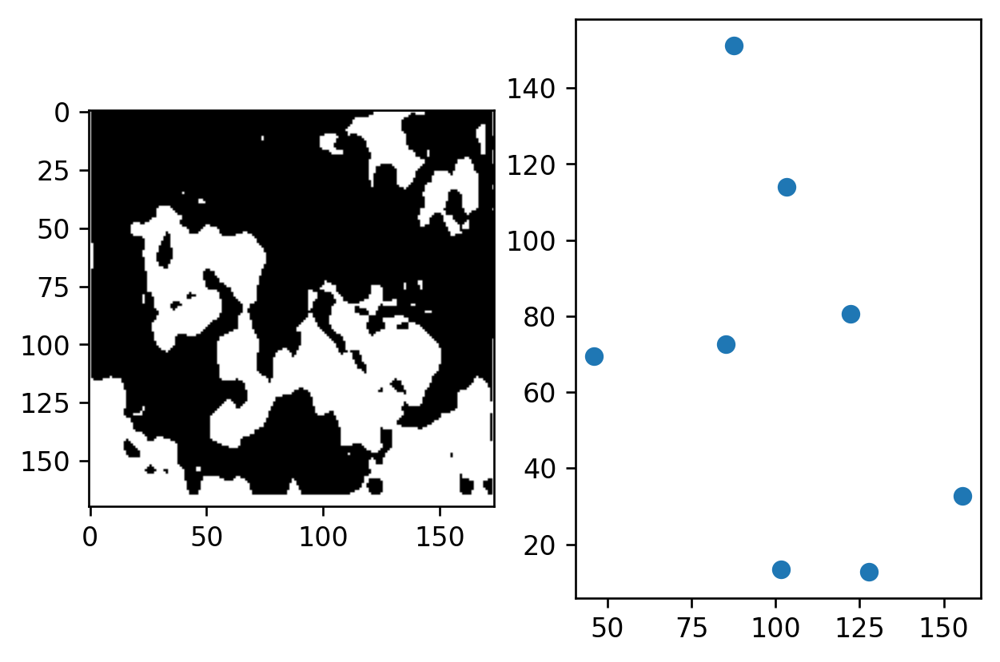

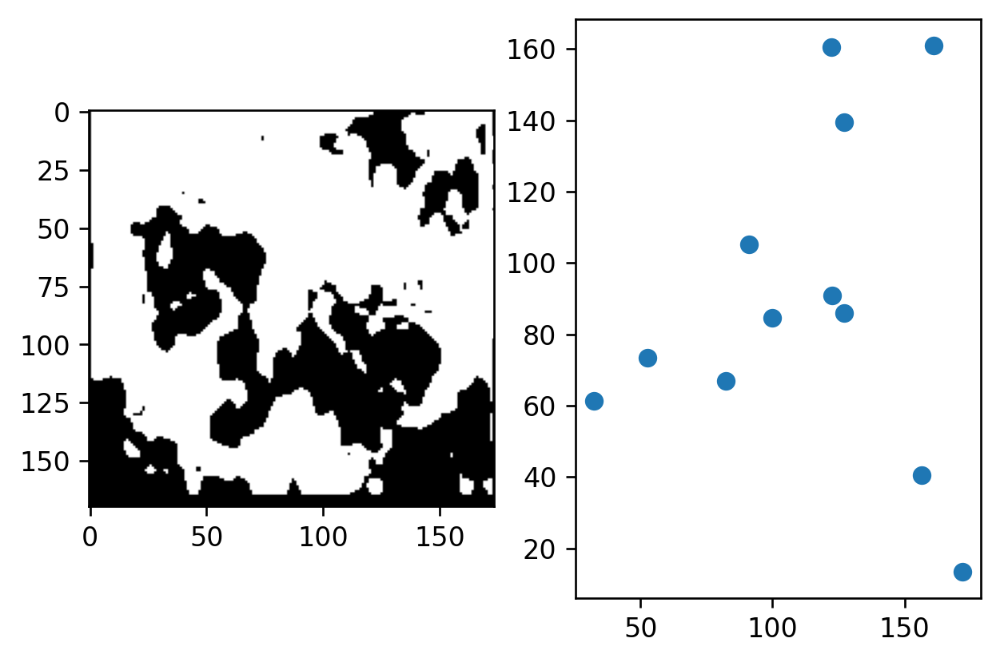

5.339567457898592
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663]


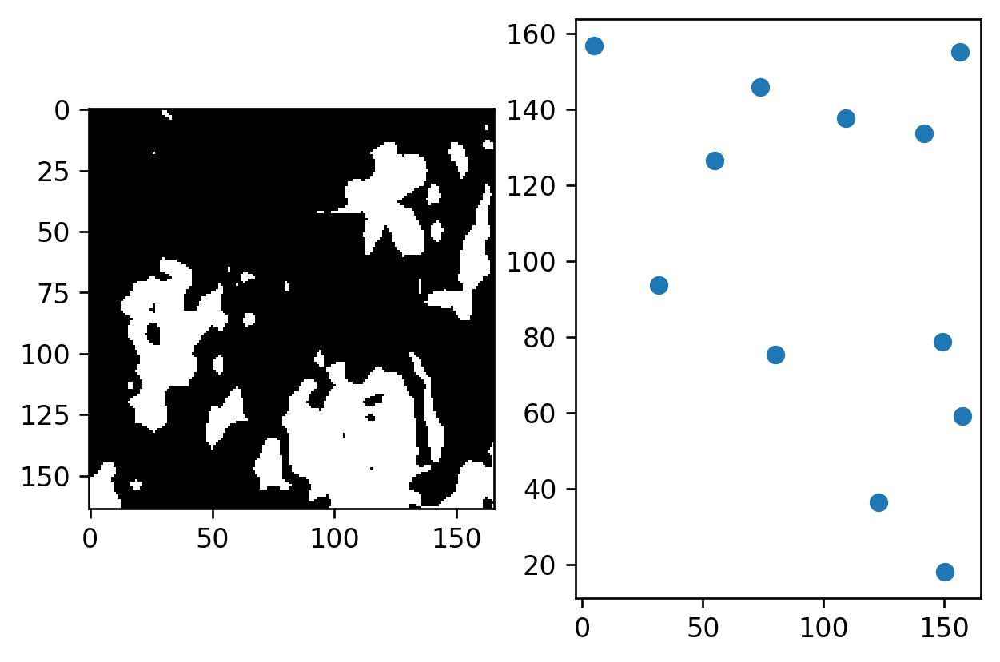

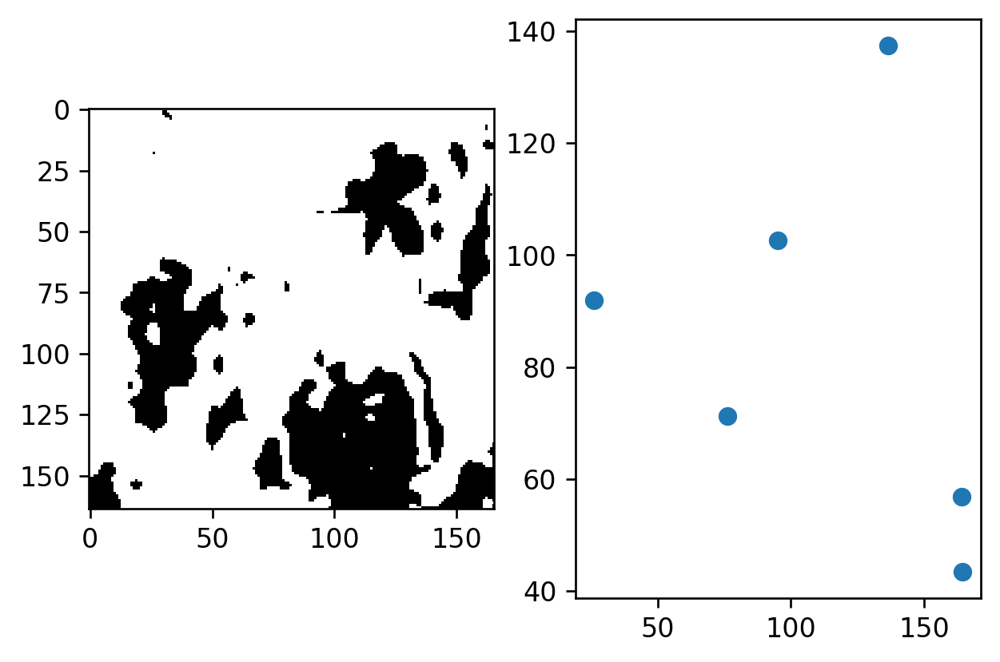

11.106955174014542
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208]


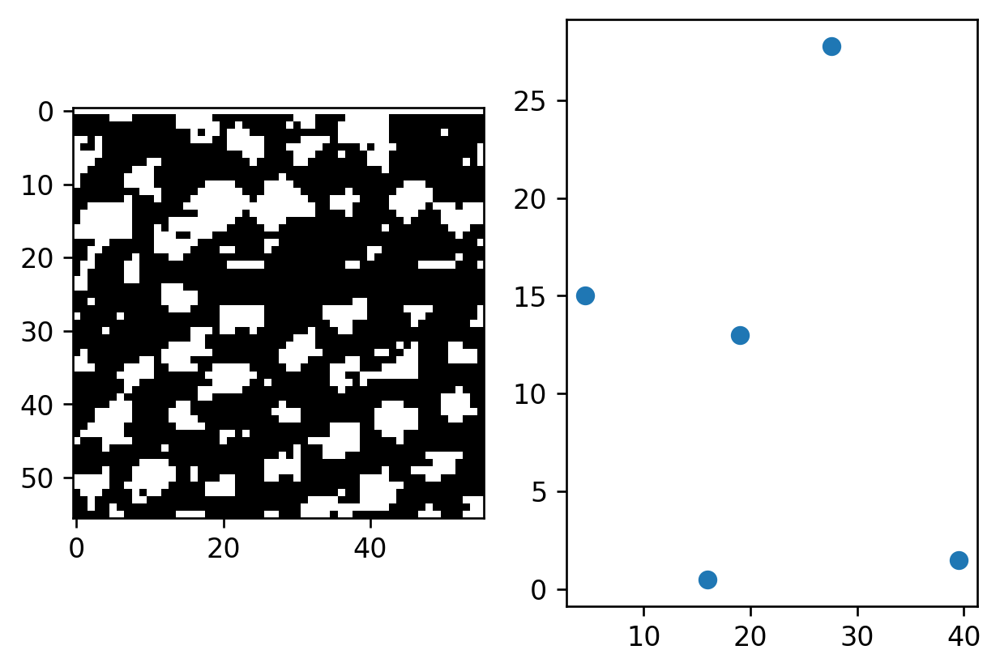

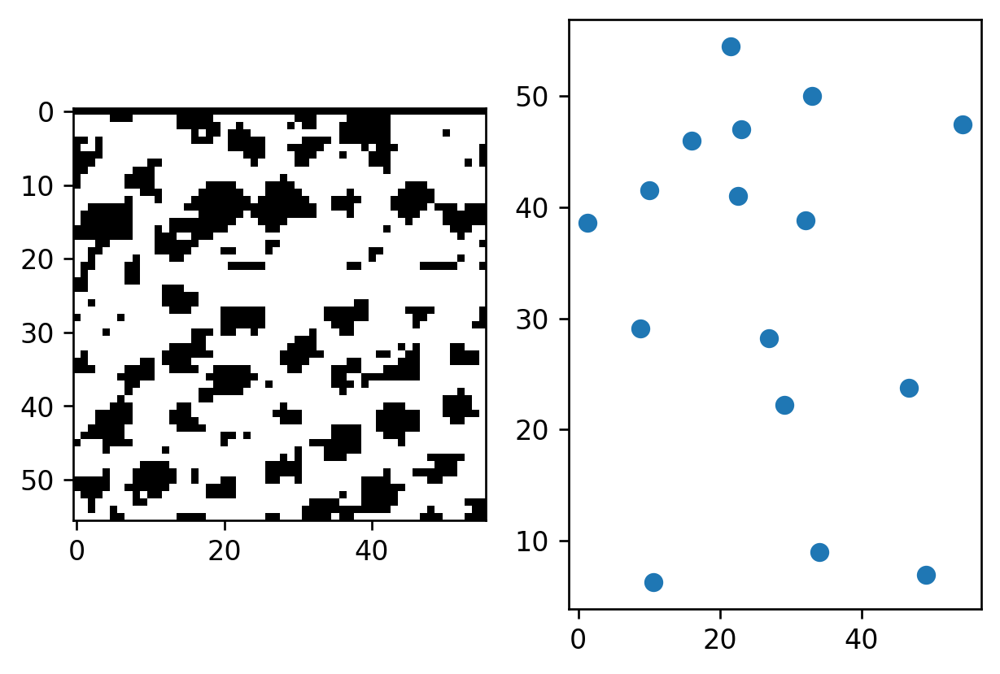

3.9741813747814057
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658]


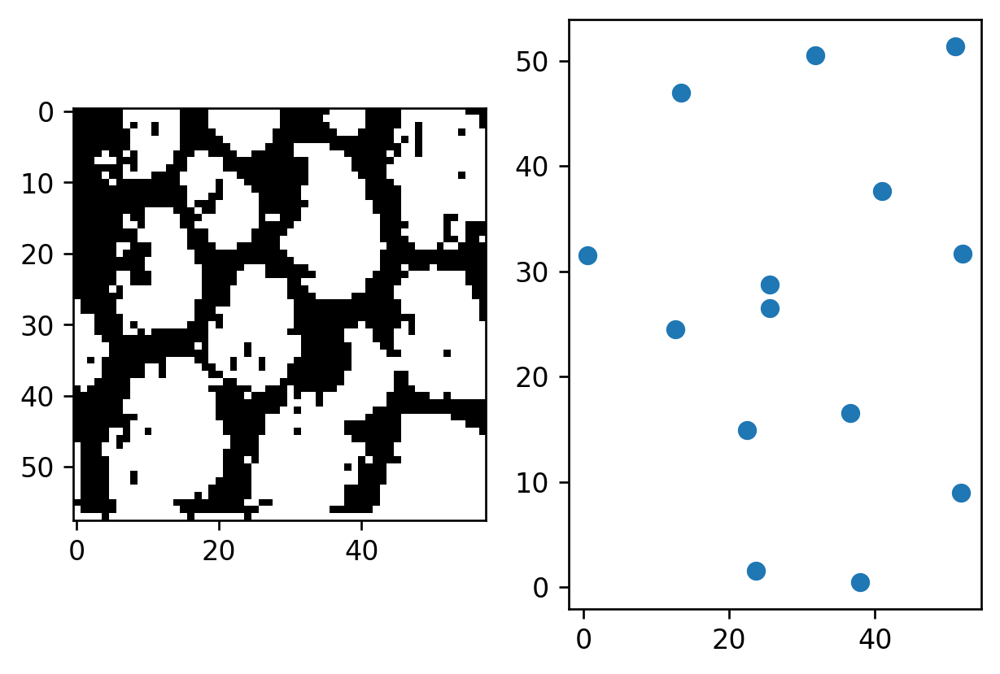

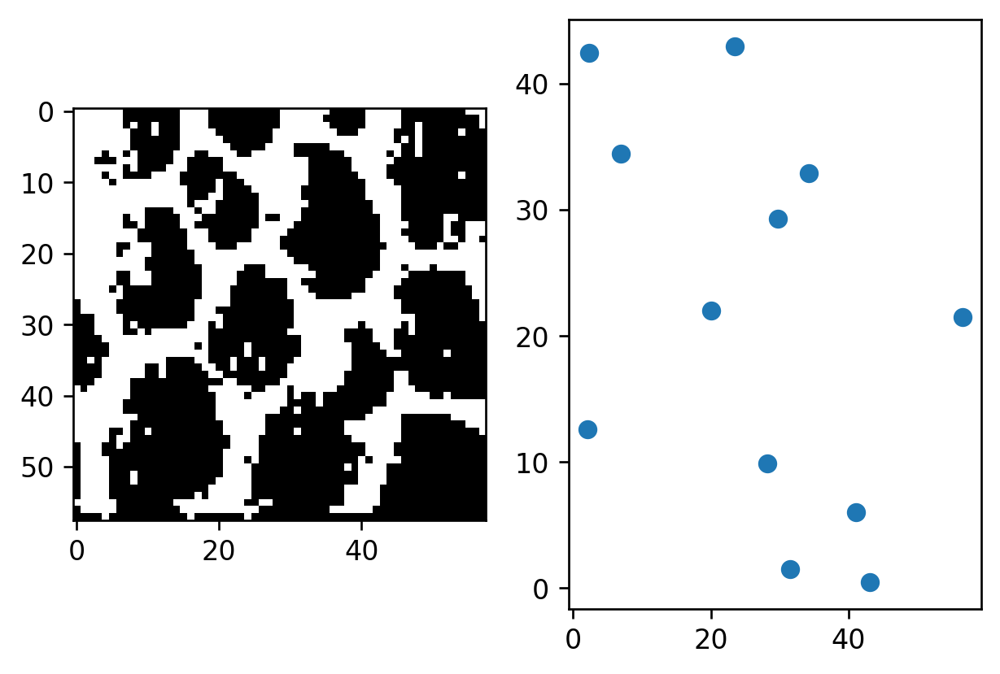

4.674485438216565
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567]


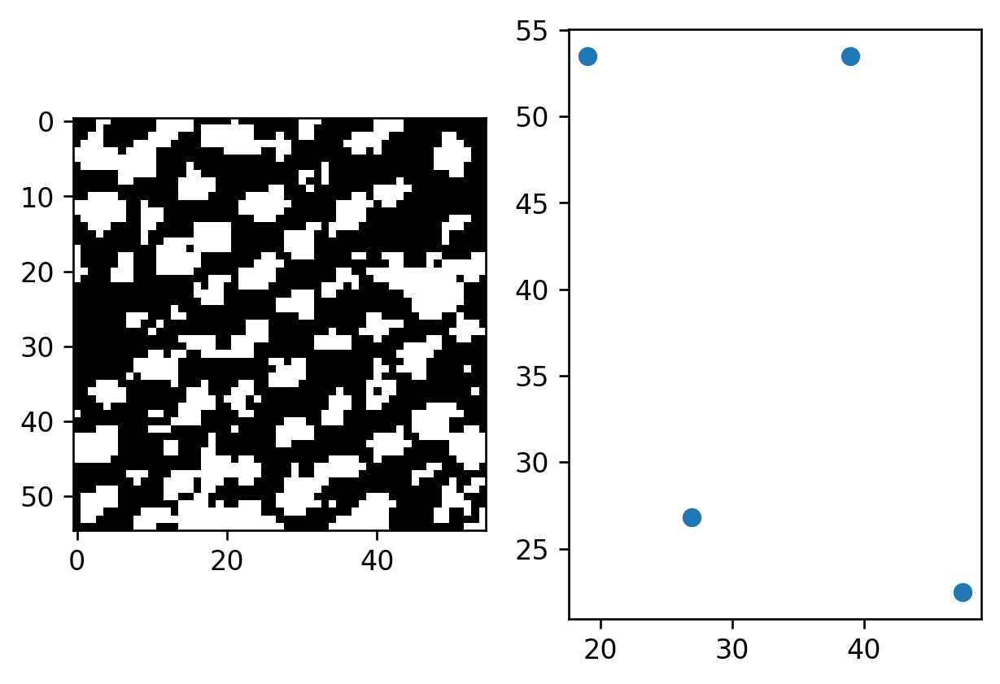

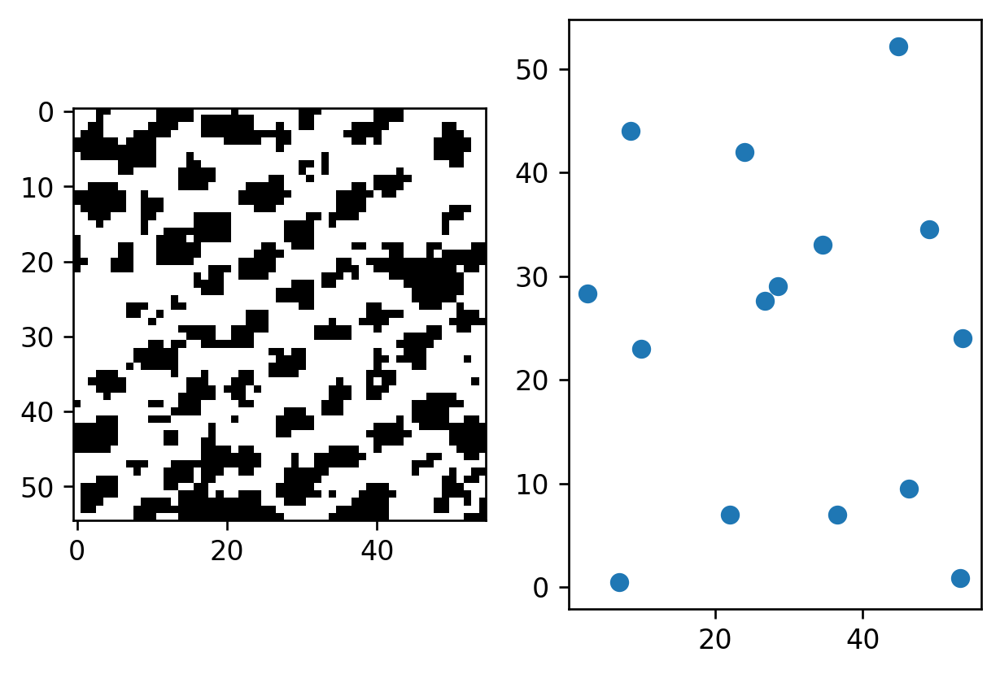

3.8029238202764826
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465]


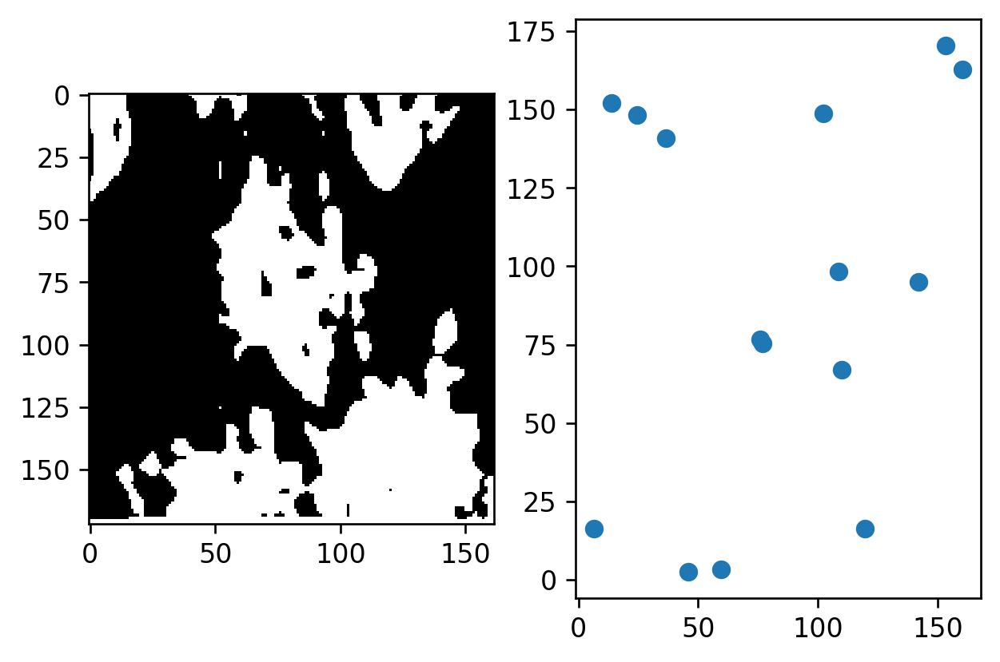

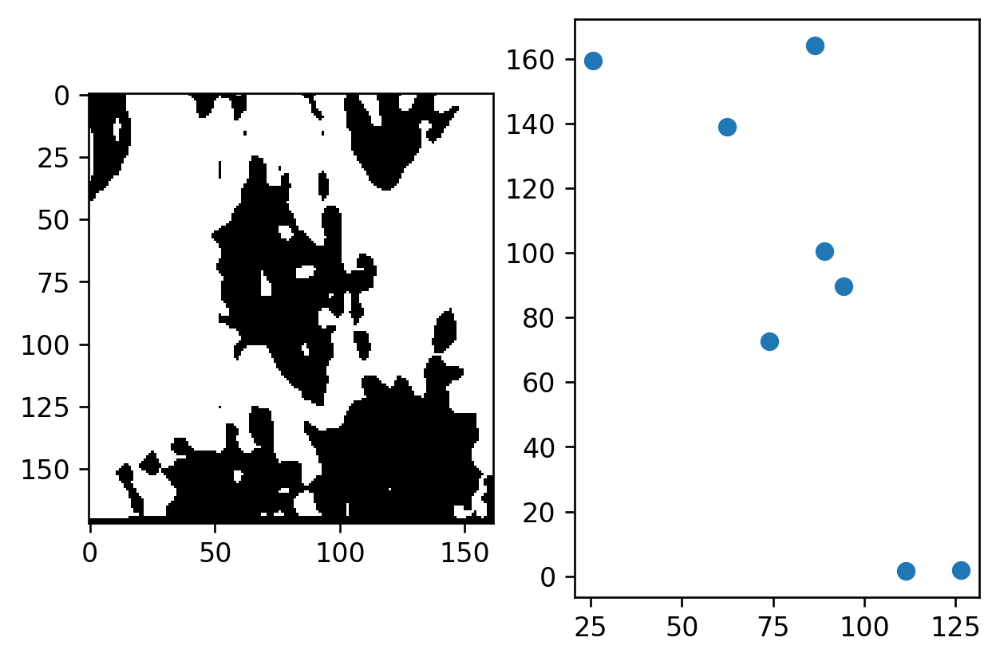

16.20491316395345
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816]


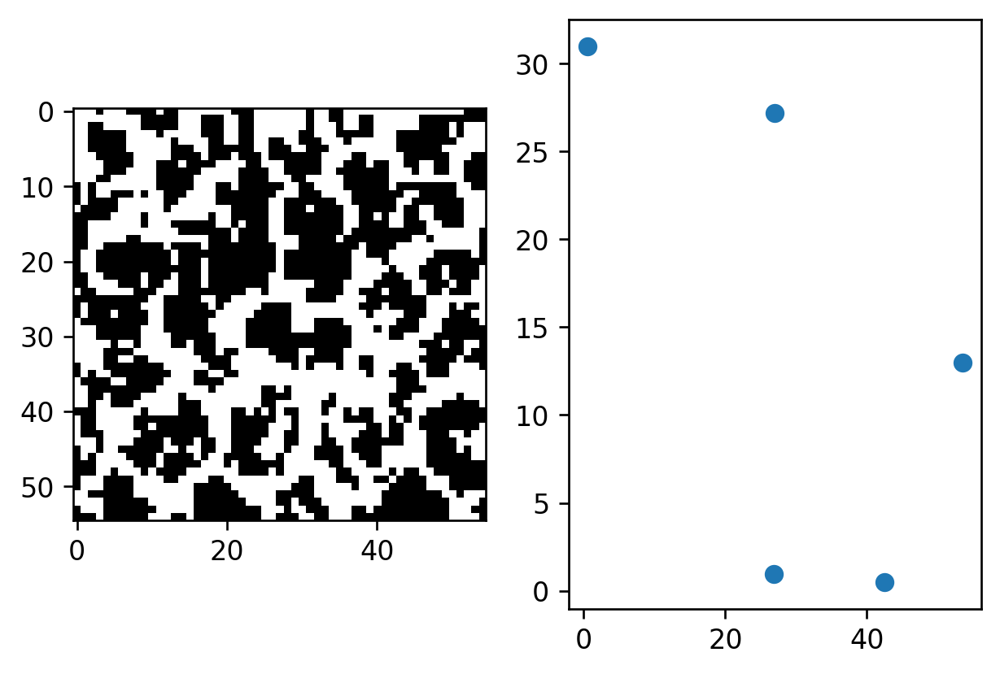

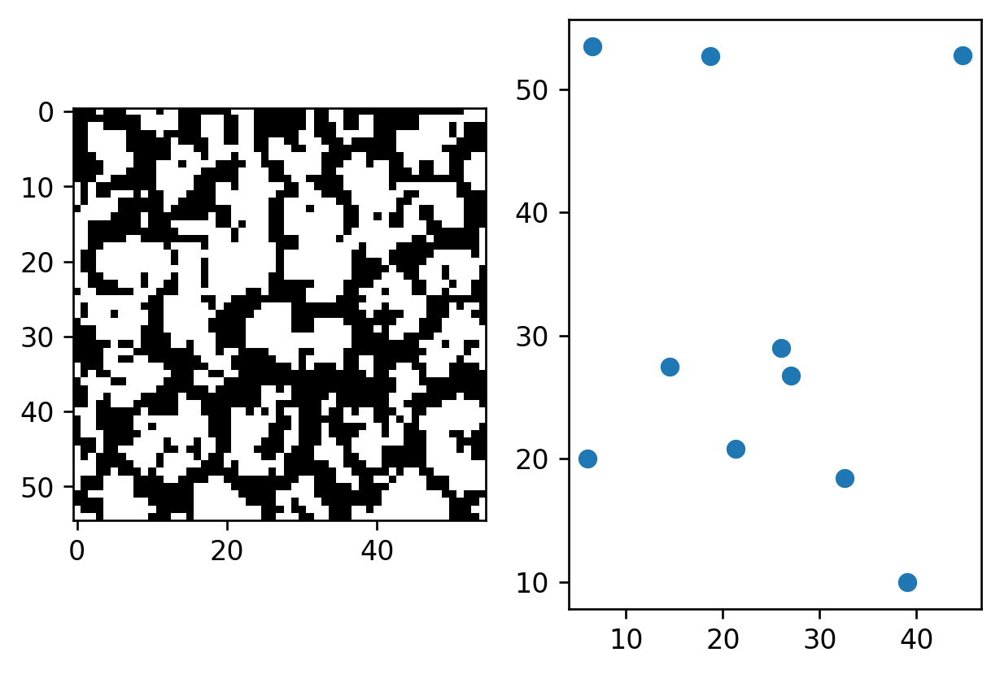

5.170546319600253
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452]


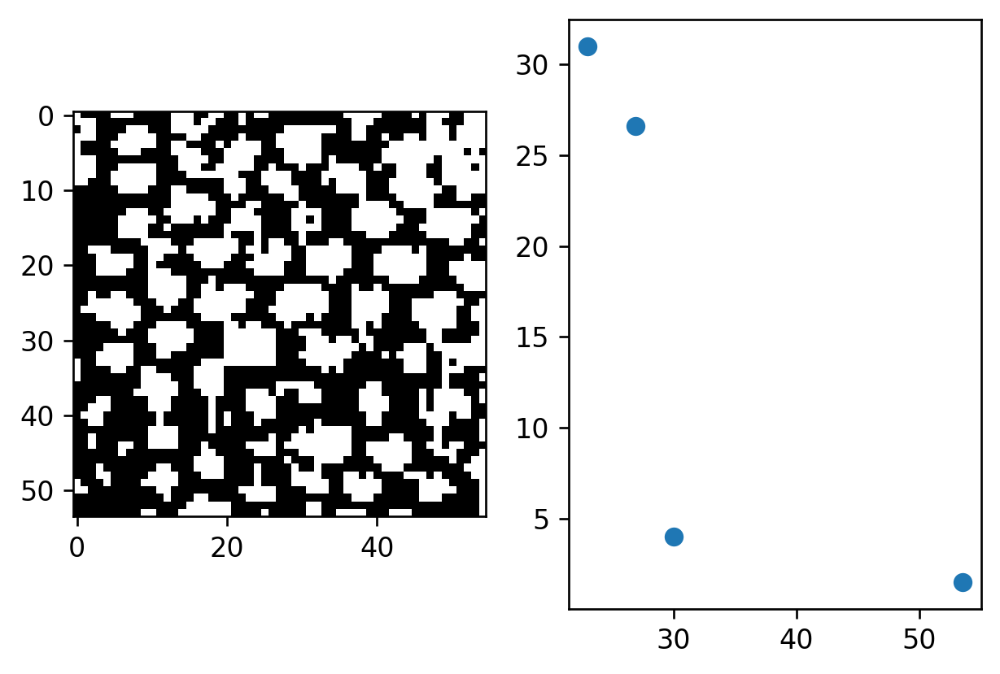

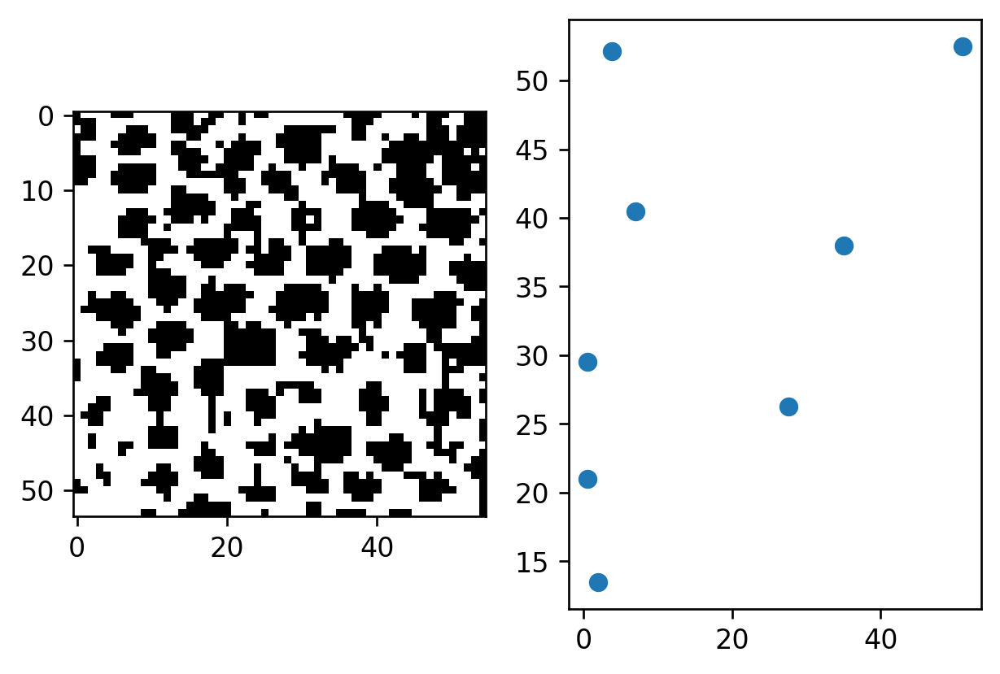

8.670381406564546
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562]


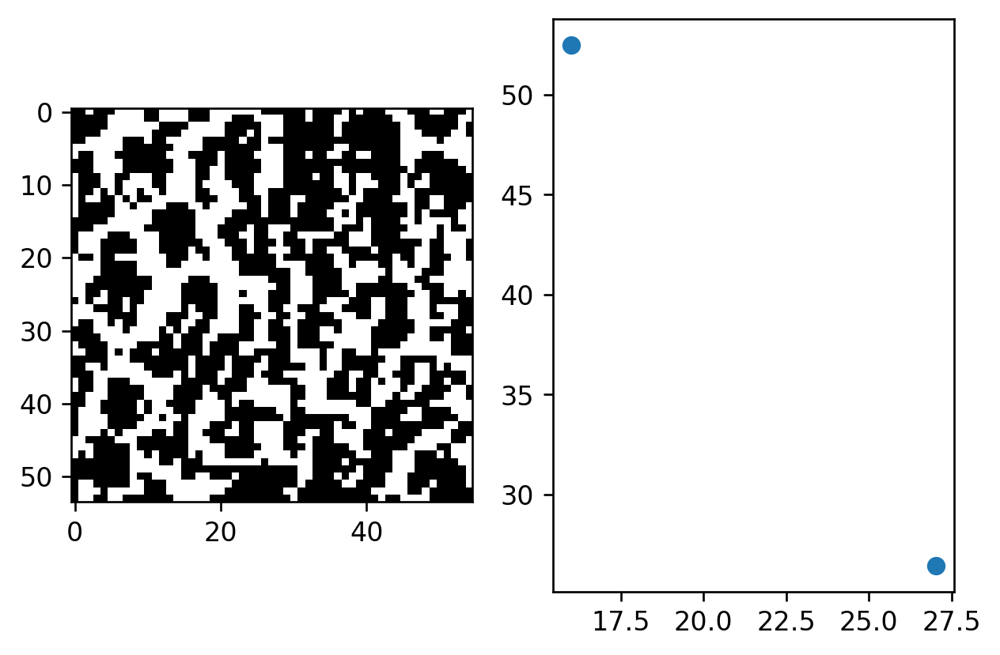

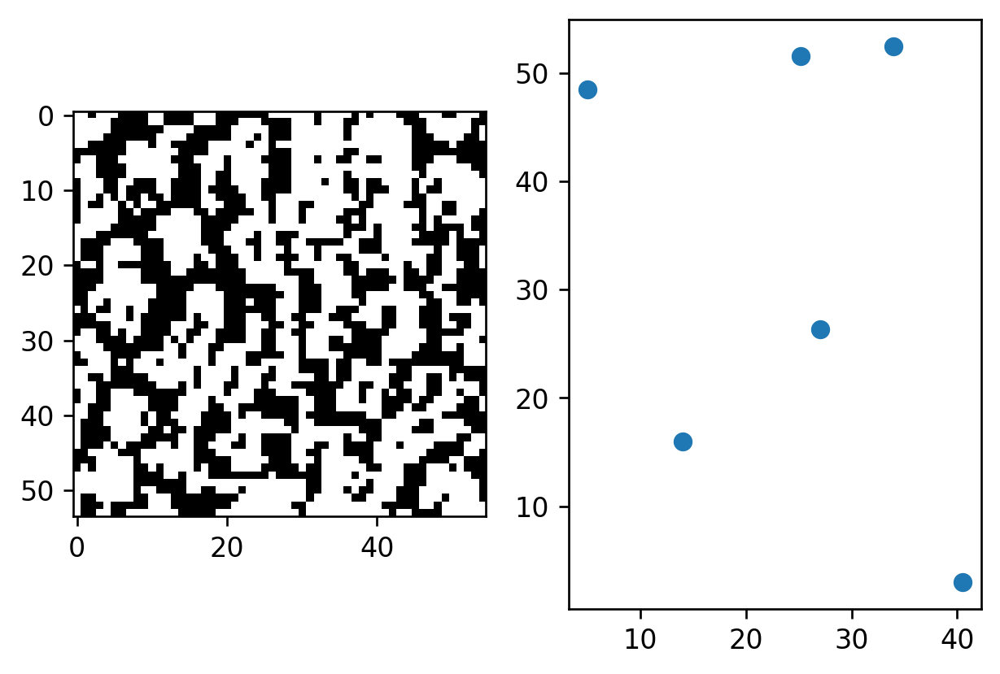

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854]


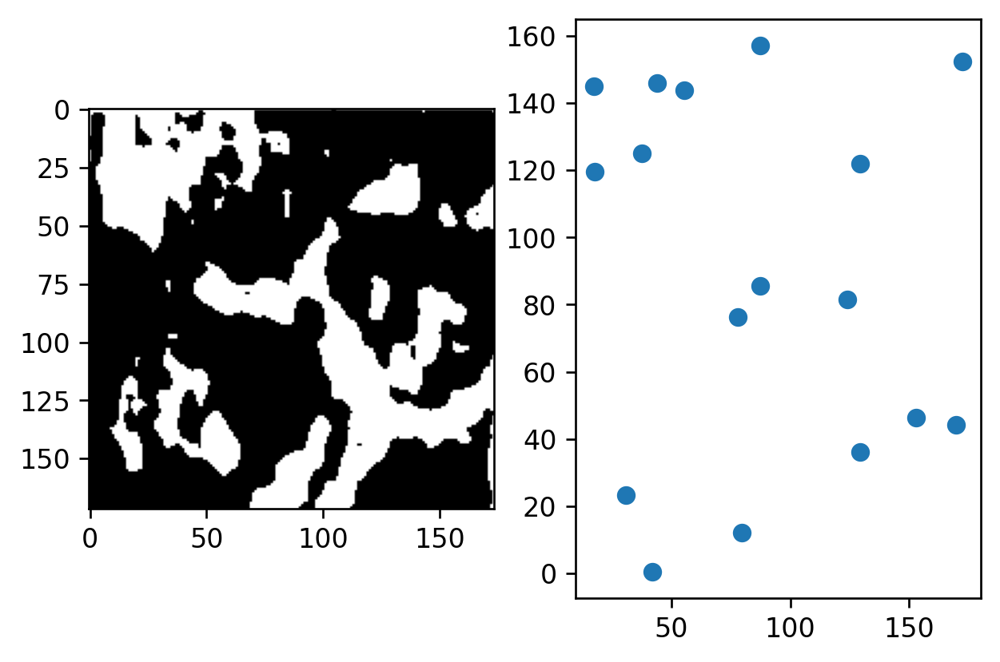

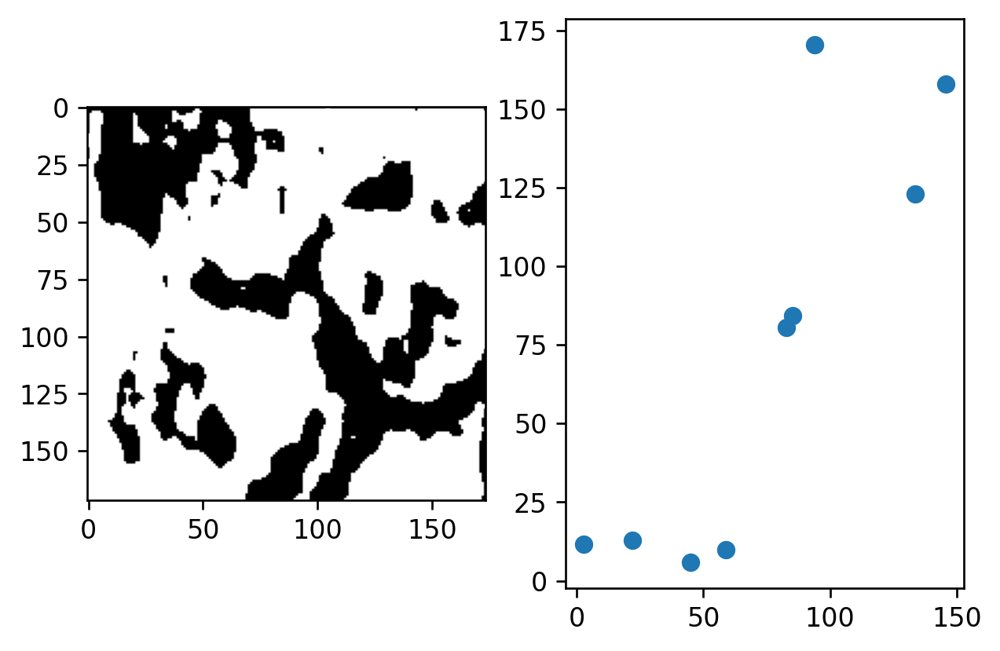

11.54842353019211
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962]


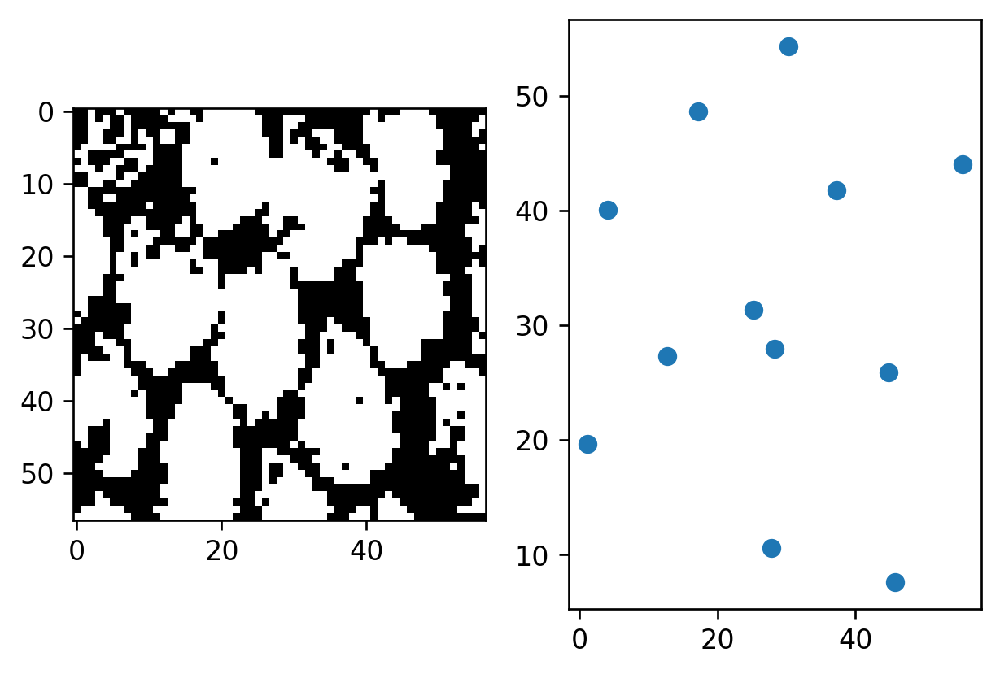

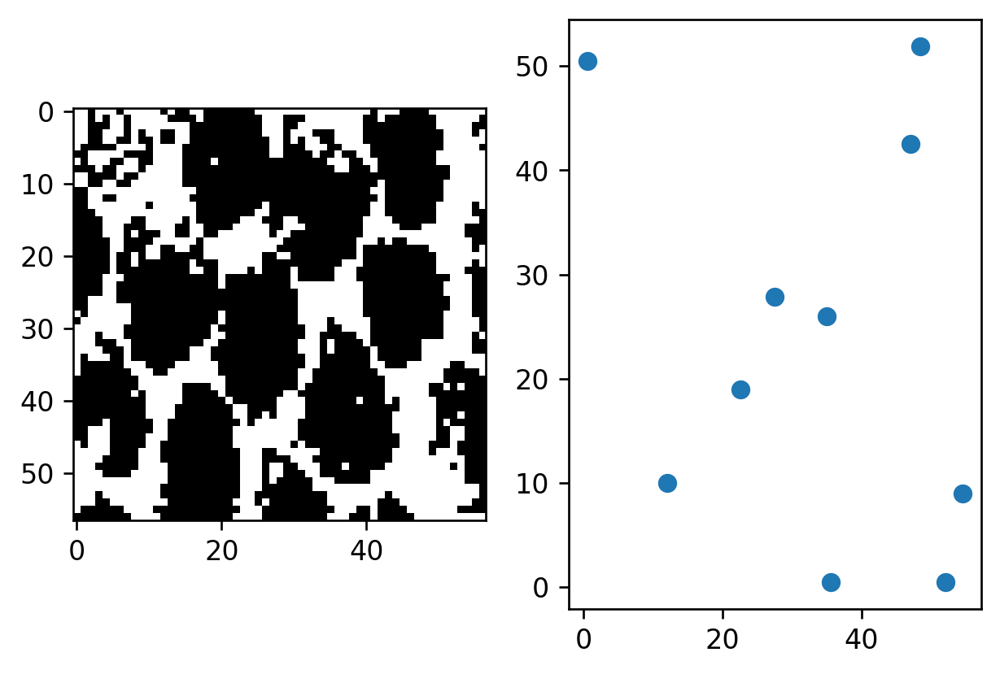

4.4713075404799705
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737]


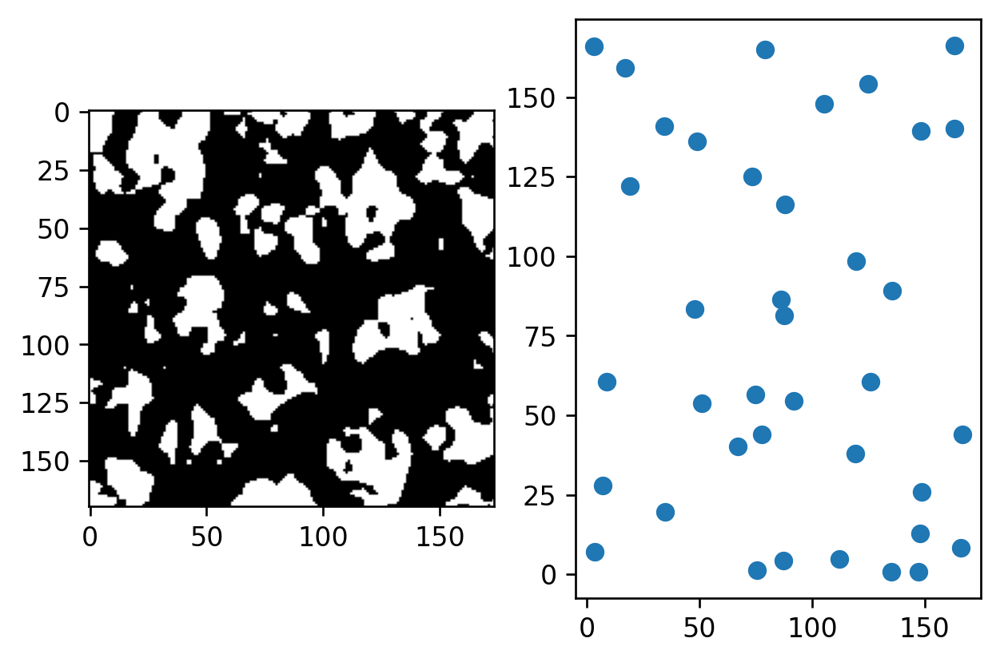

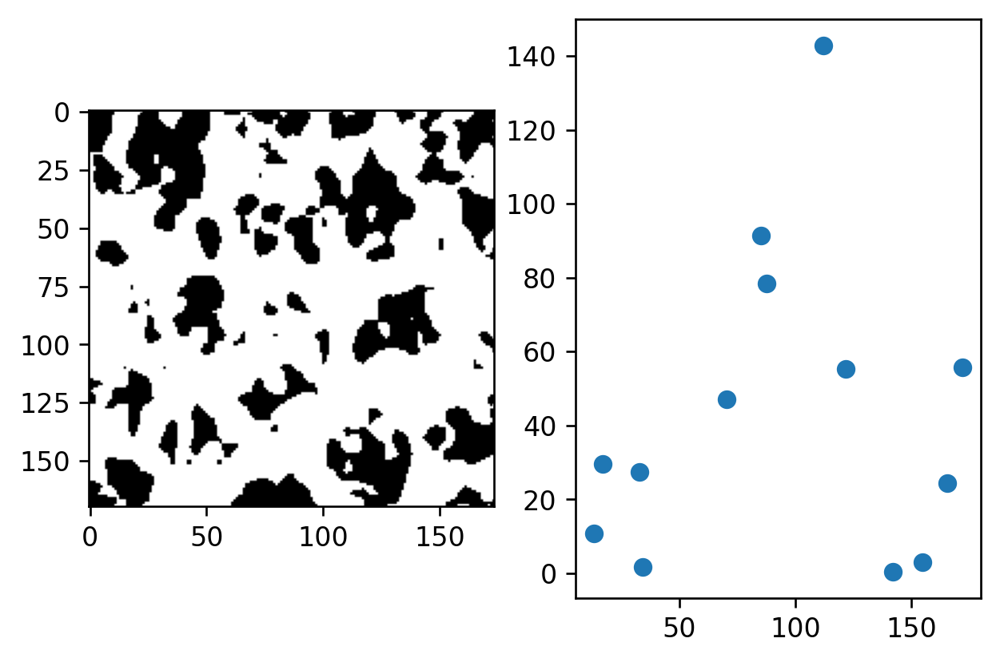

6.581999205916344
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795]


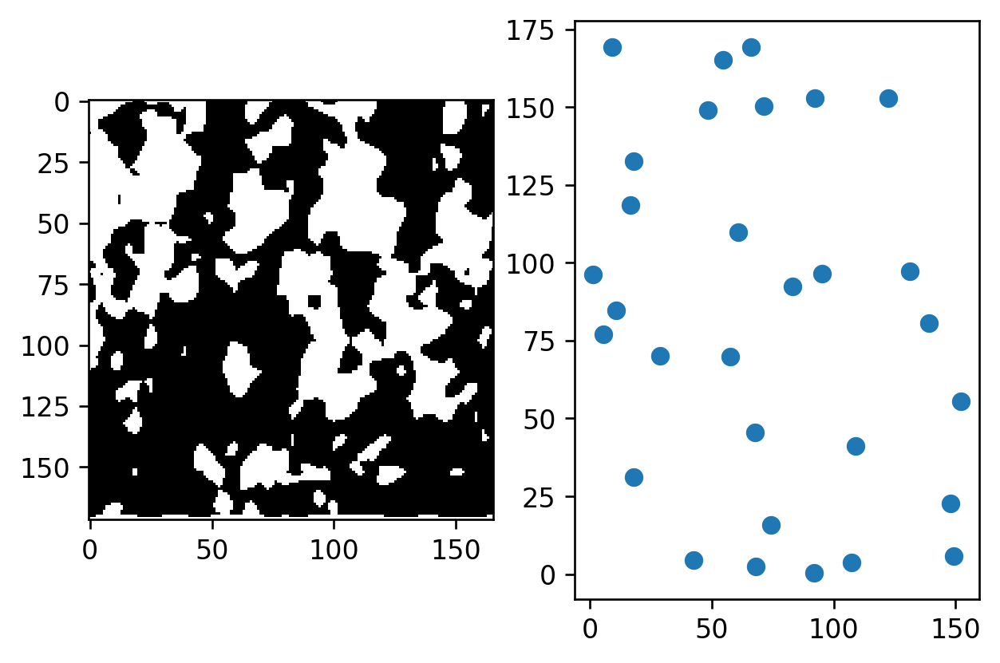

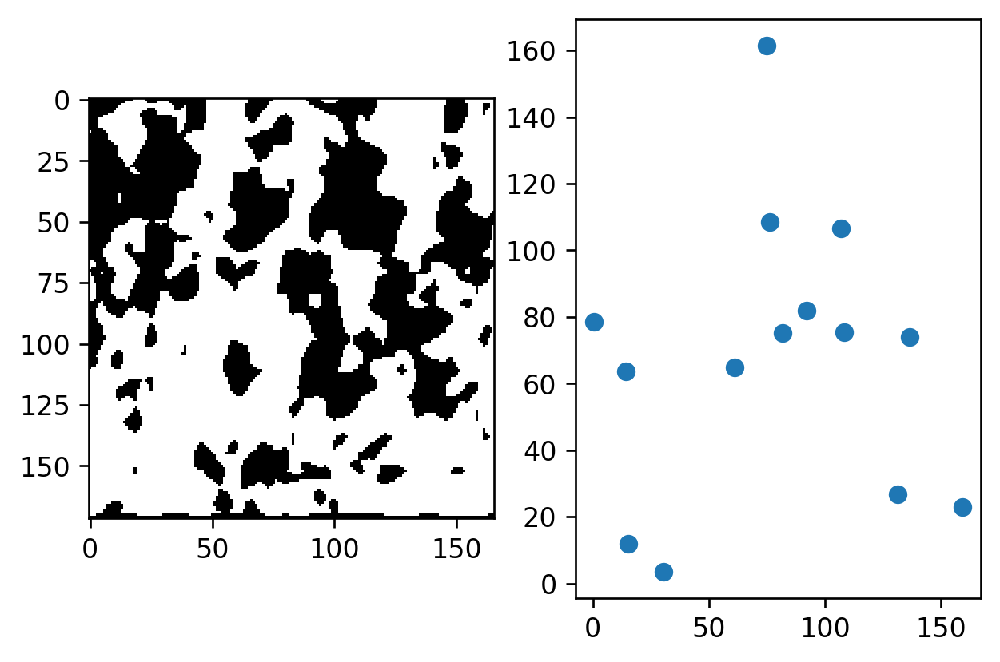

8.003708125482182
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725]


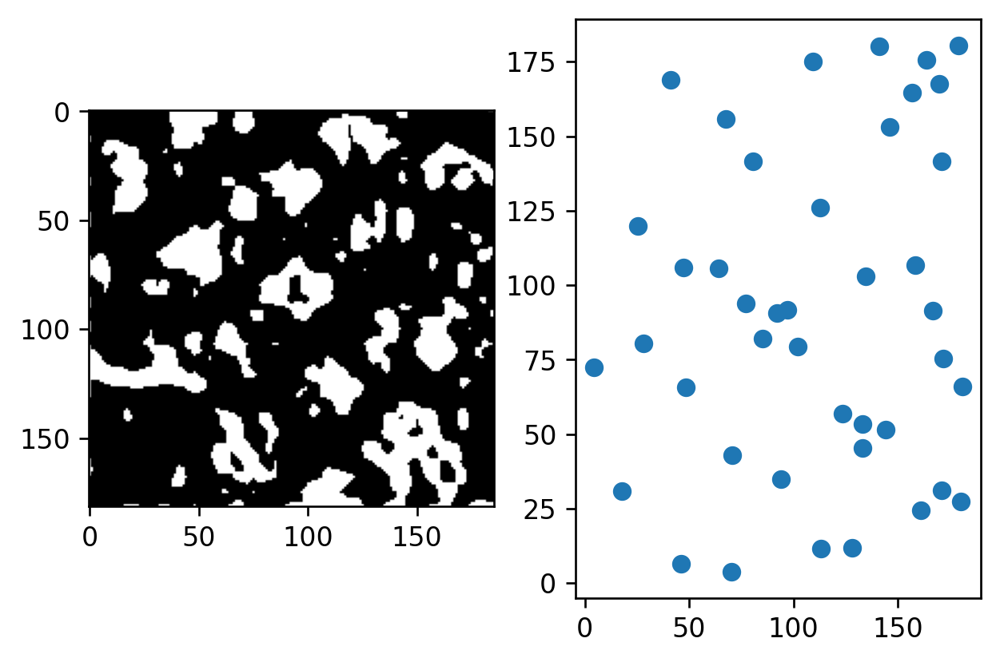

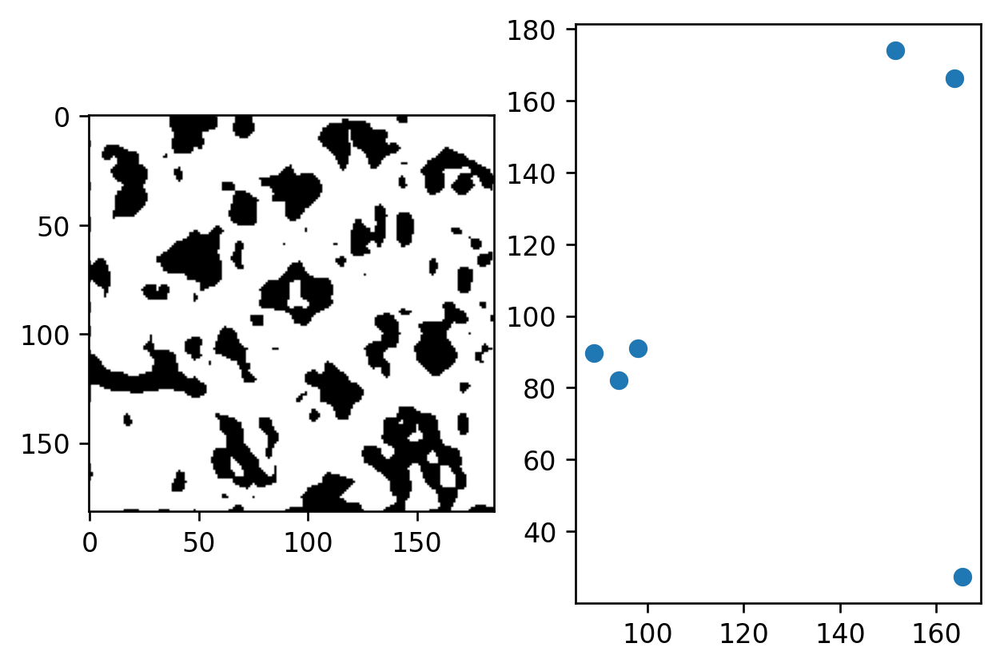

7.595813980486045
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741]


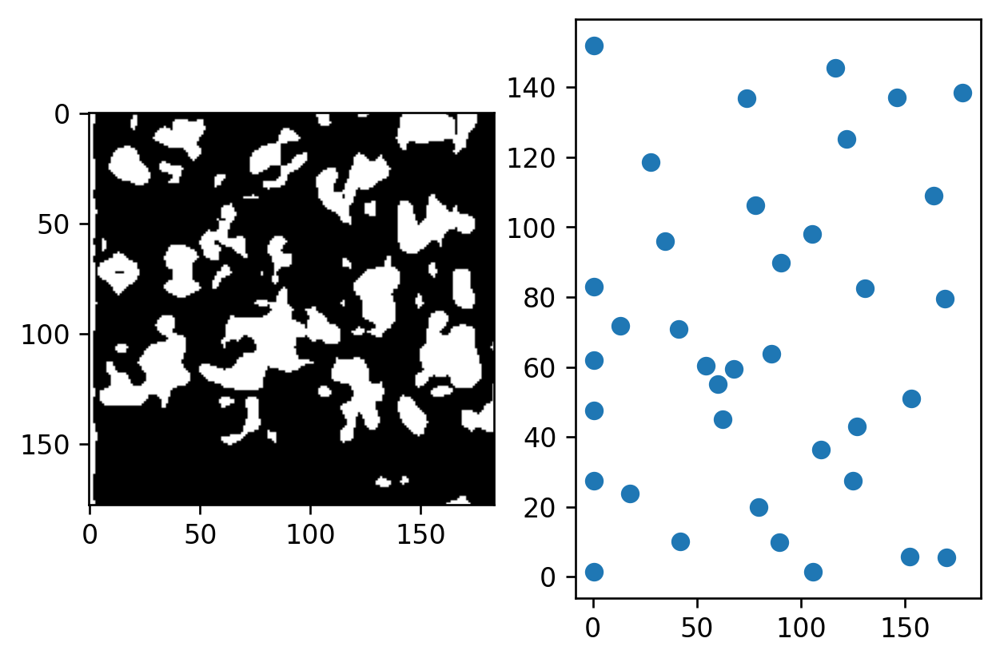

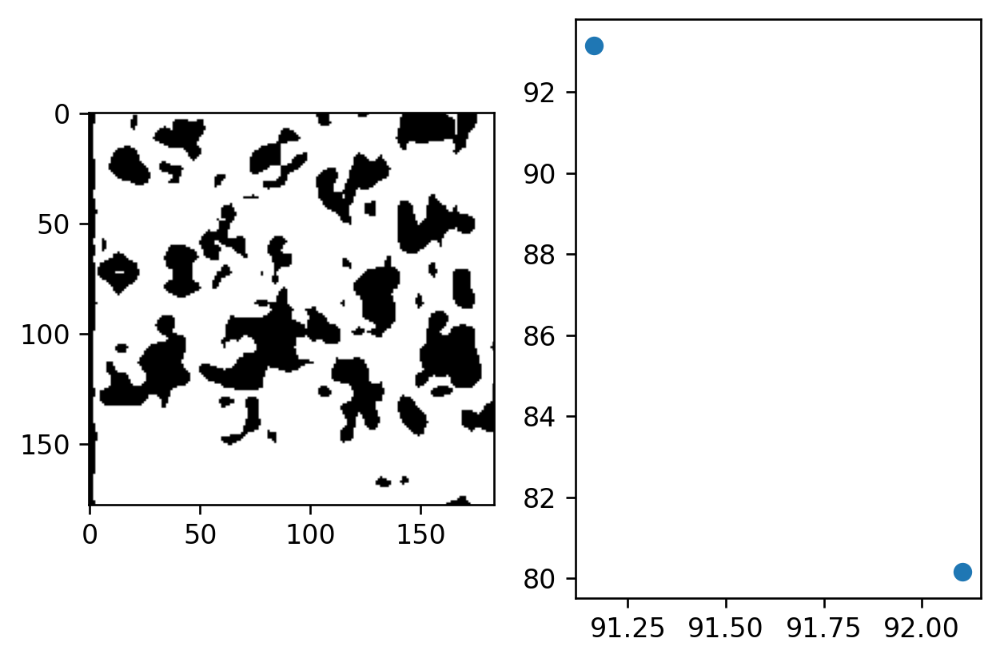

7.5851986022152555
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375]


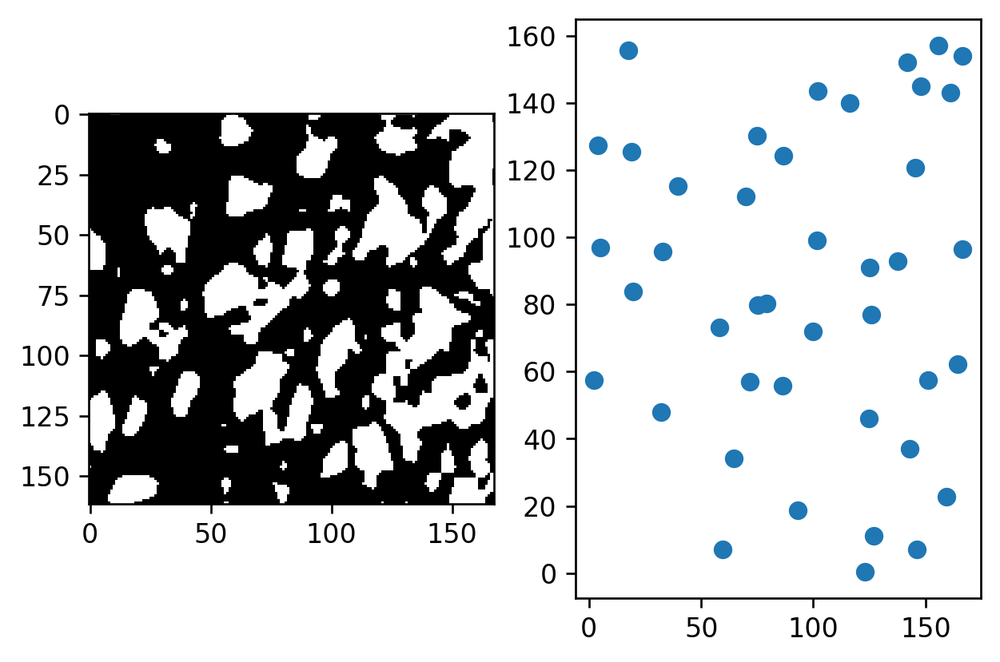

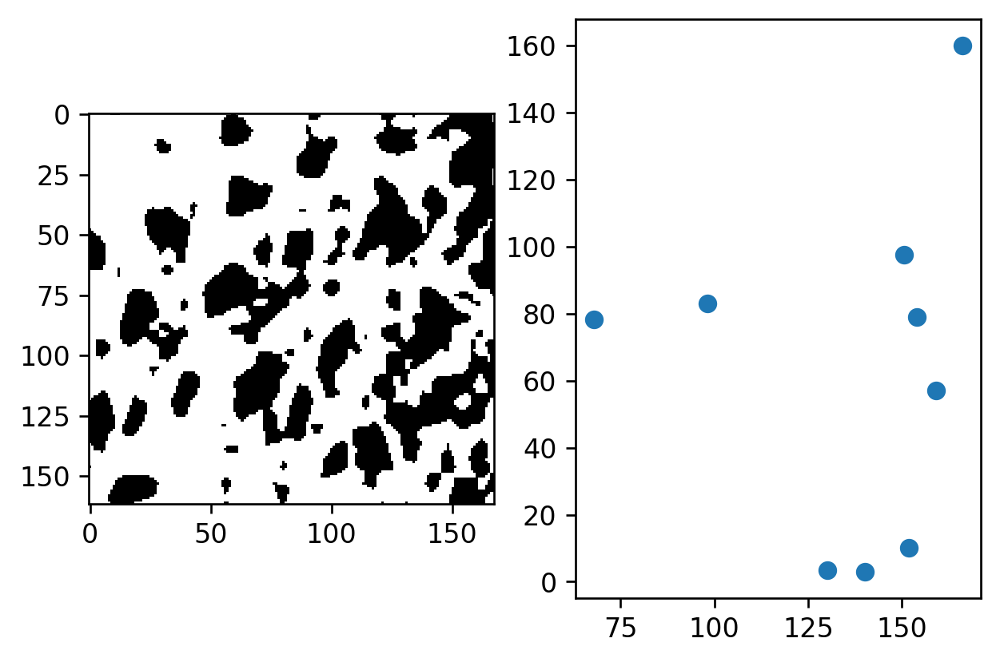

7.032229388638562
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345]


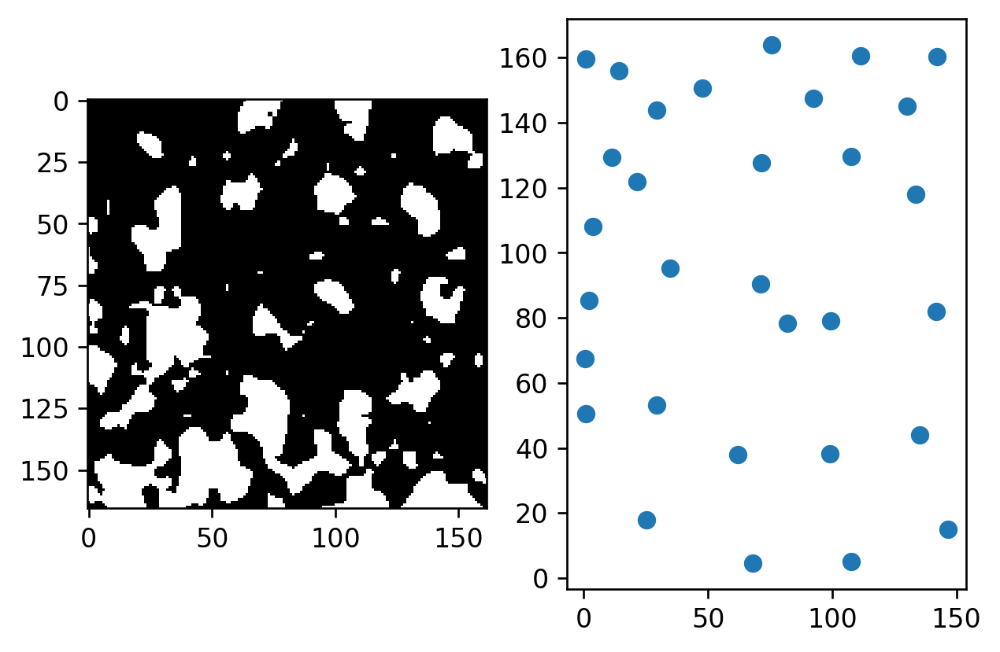

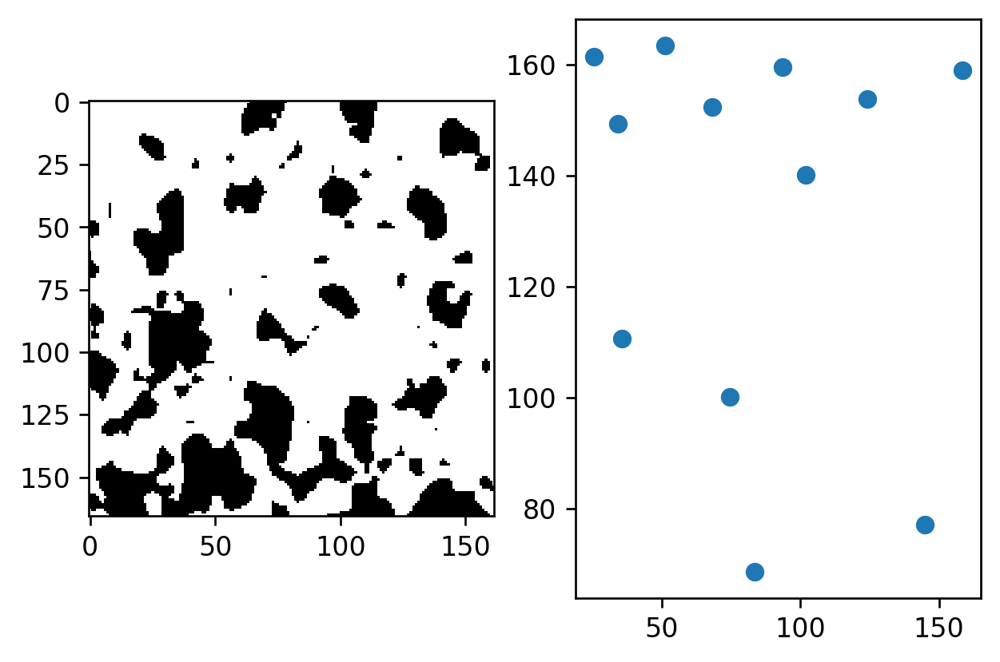

7.521037537781752
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591805219270285]


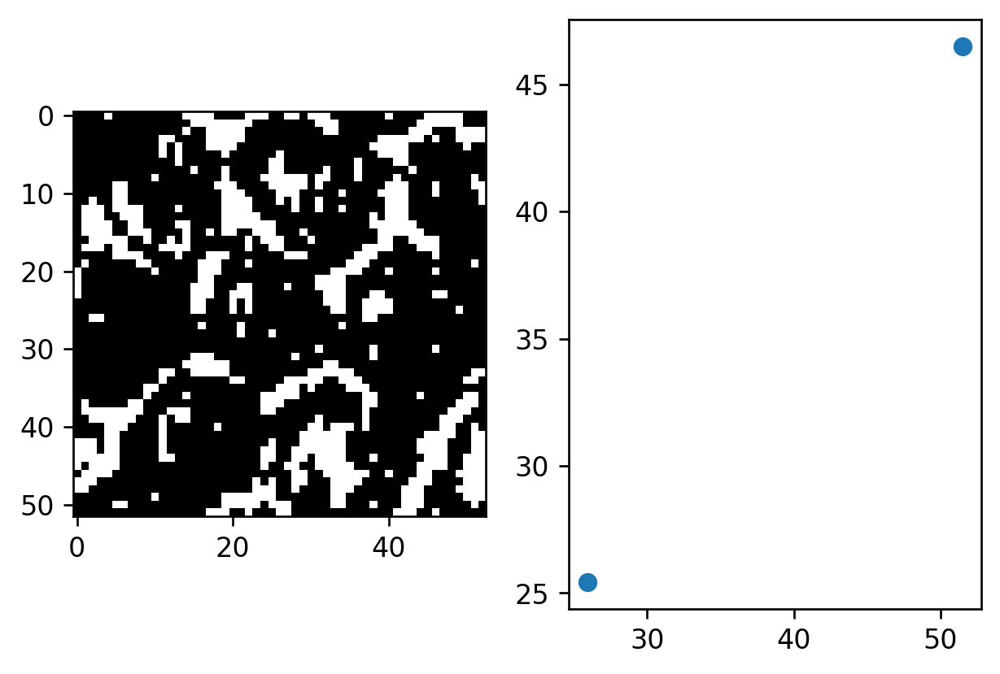

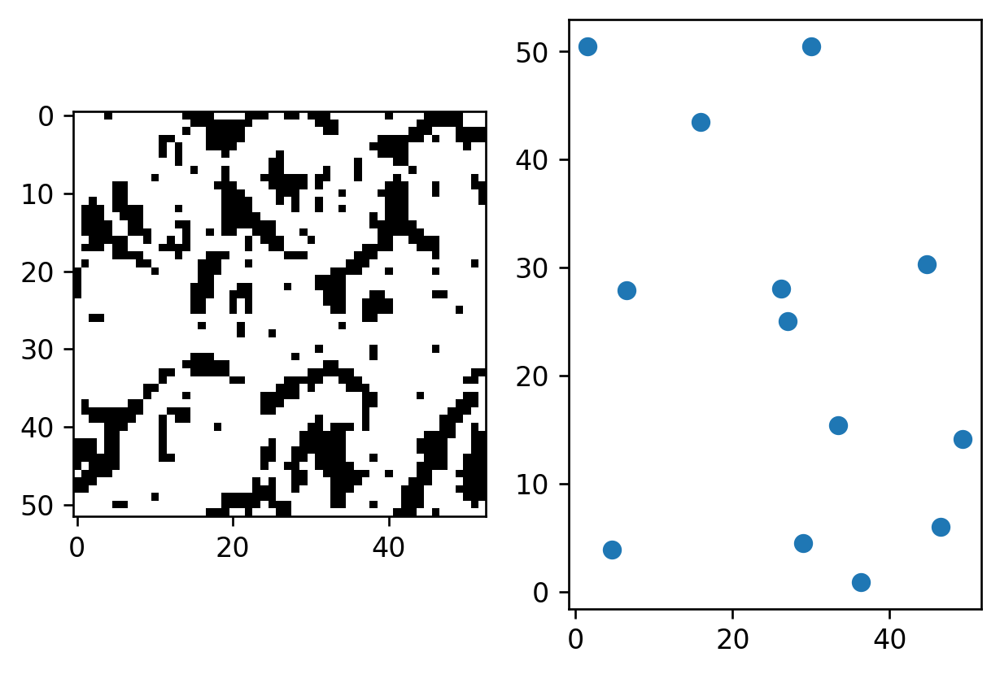

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591805219270285, 20.252864626743374]


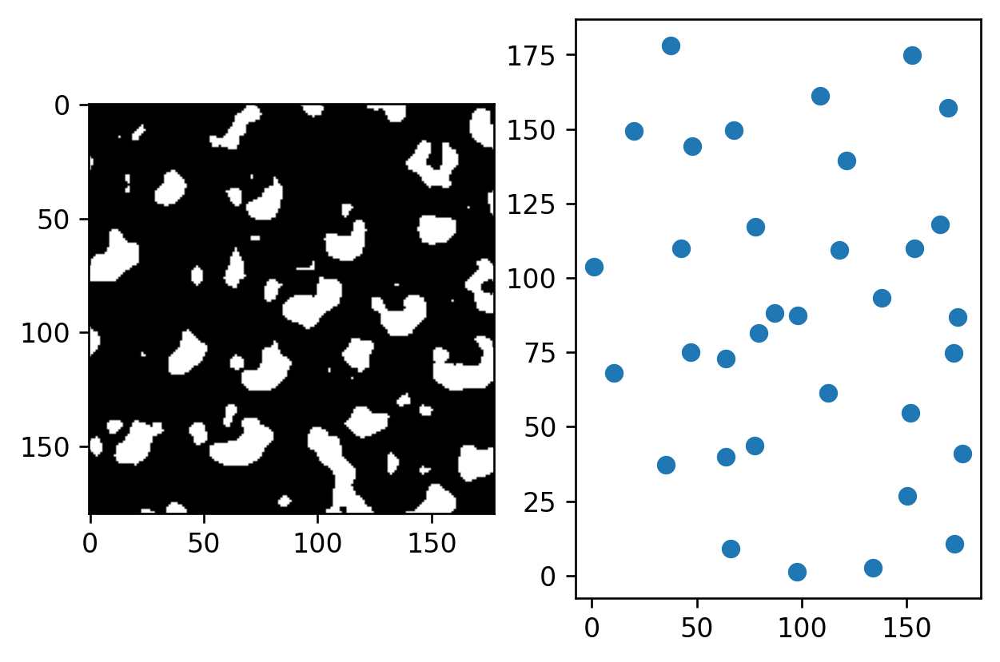

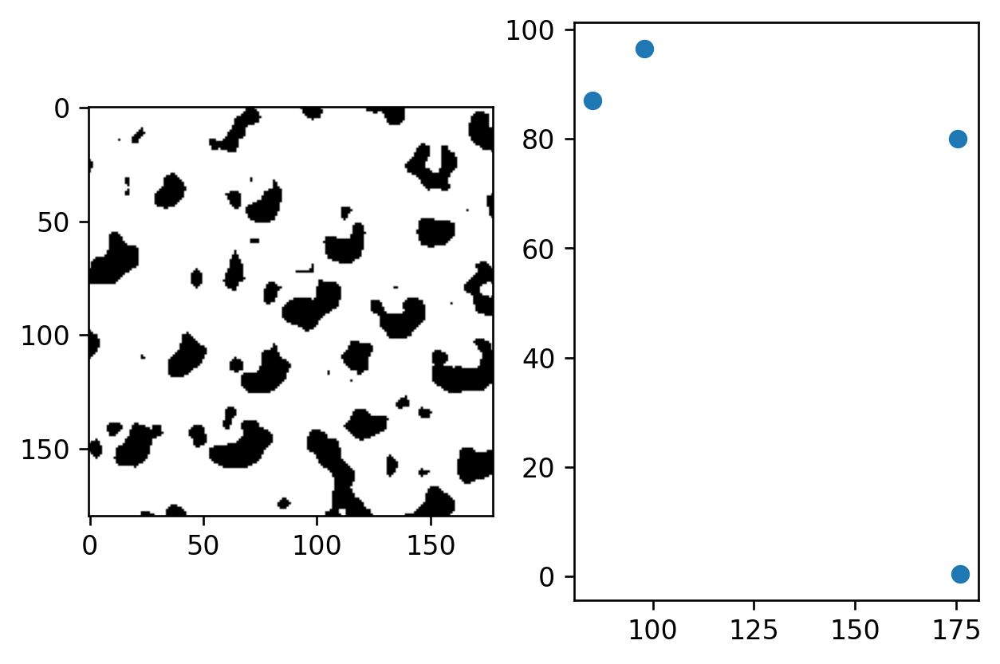

8.038109555716424
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591805219270285, 20.252

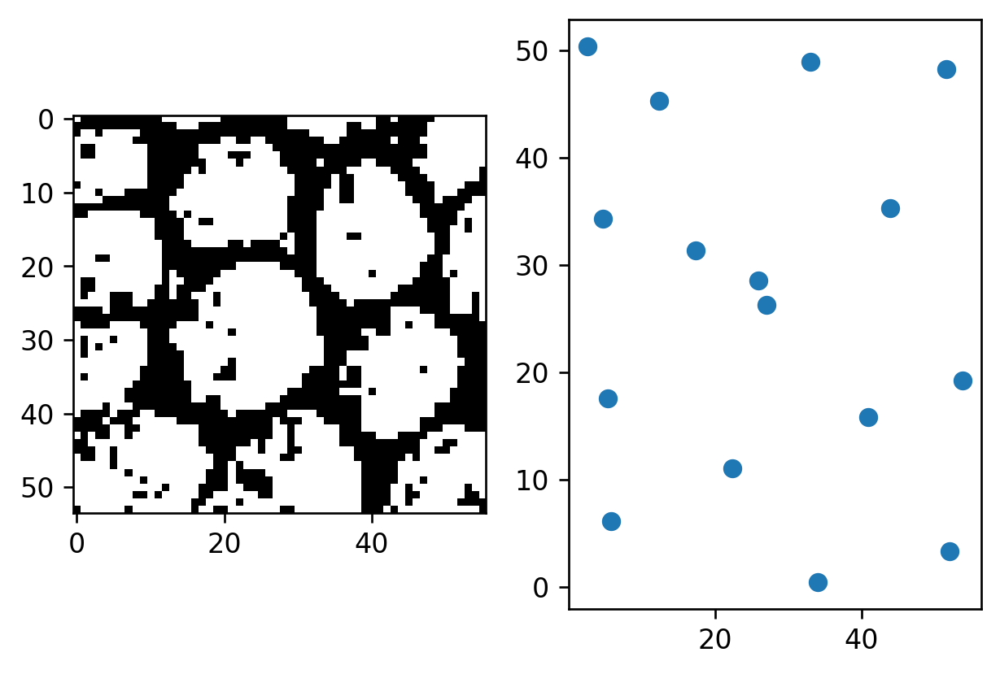

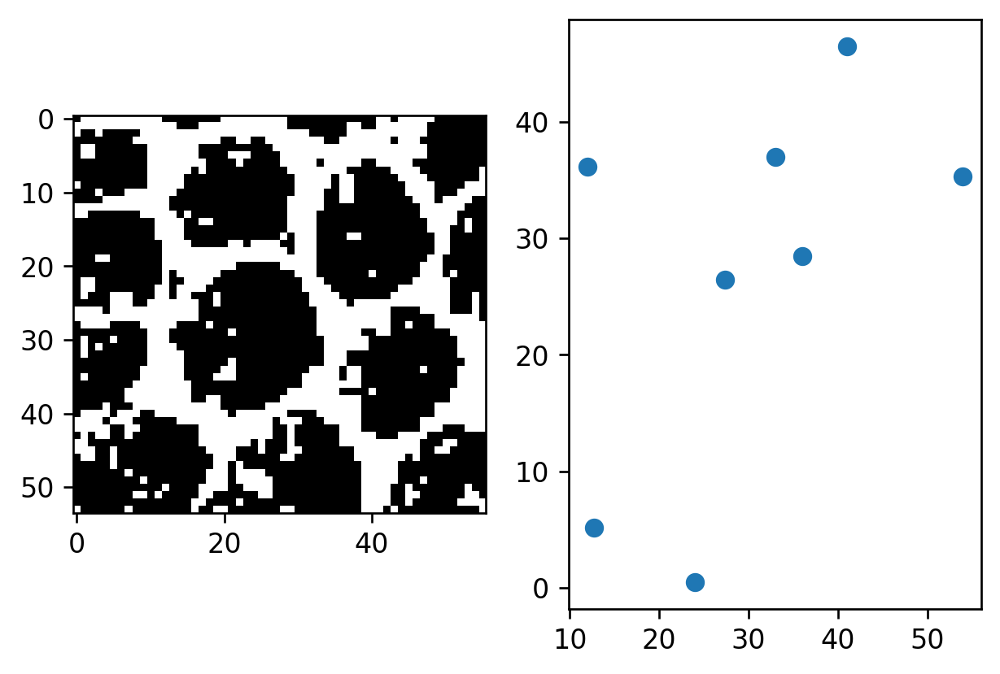

4.239694483842127
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.703496852612345, 11.591

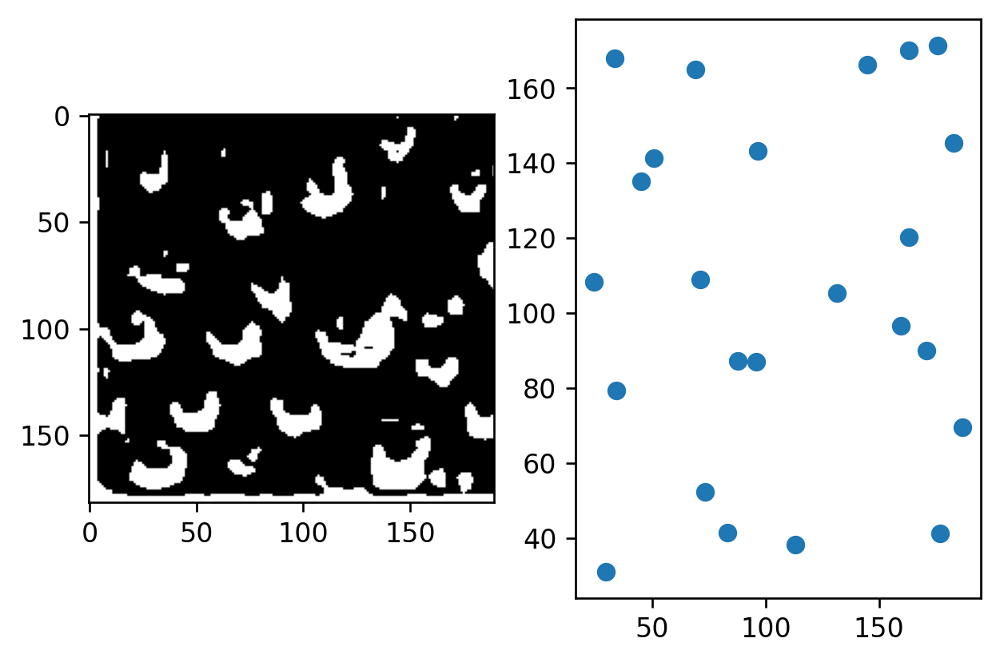

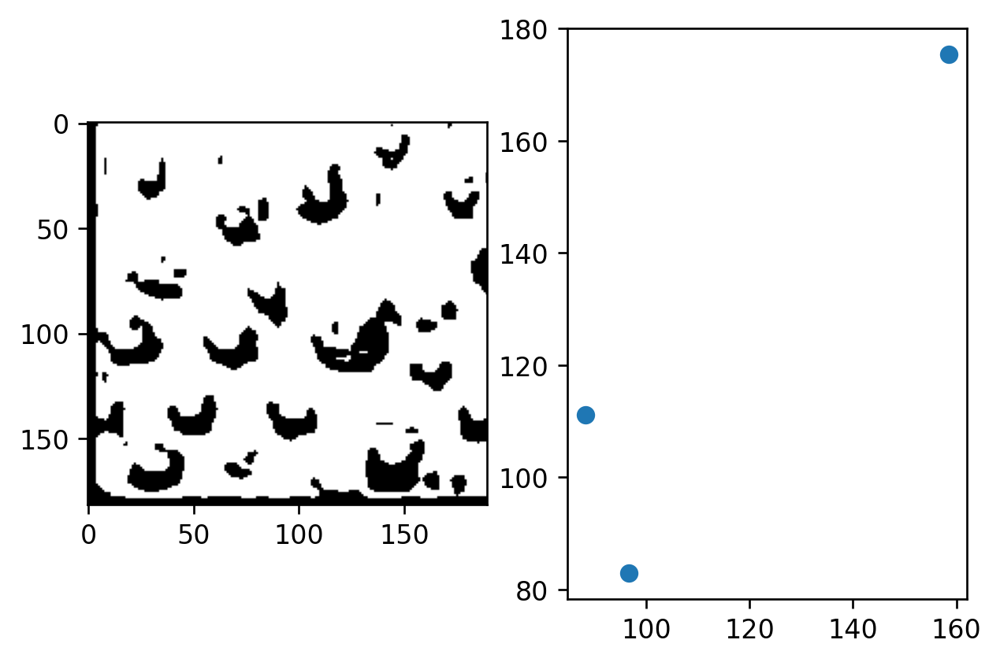

10.511433148146125
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.599911834571375, 9.70

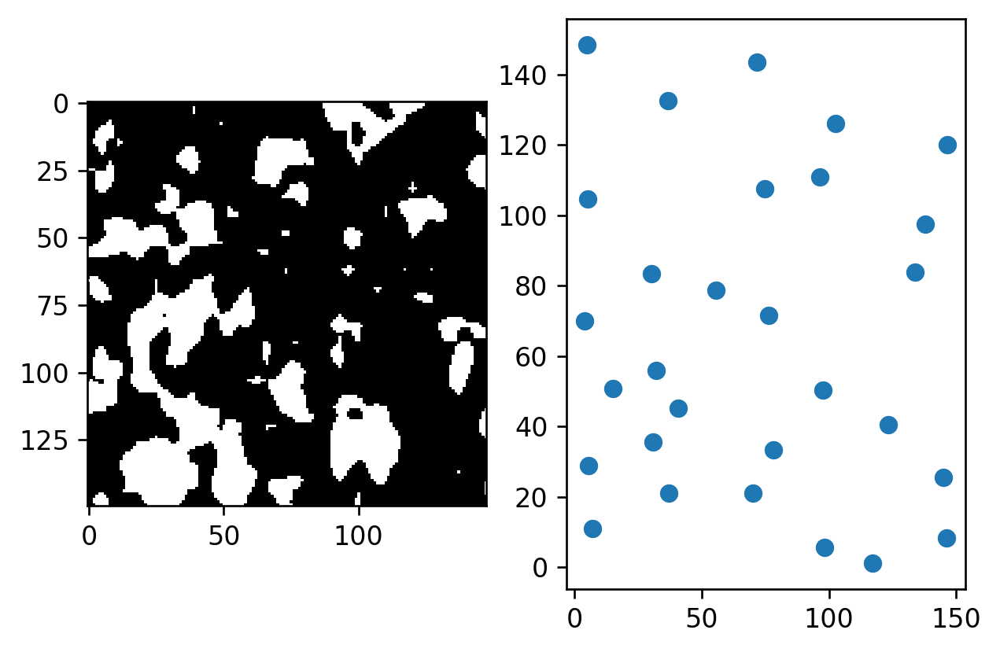

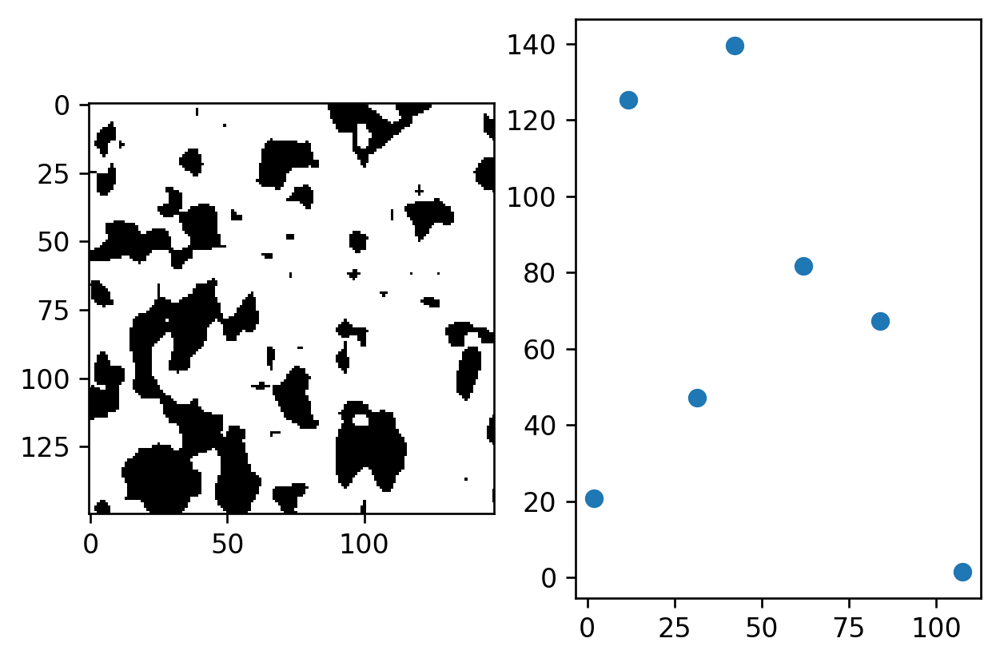

6.732590447445098
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.907303354207741, 6.59

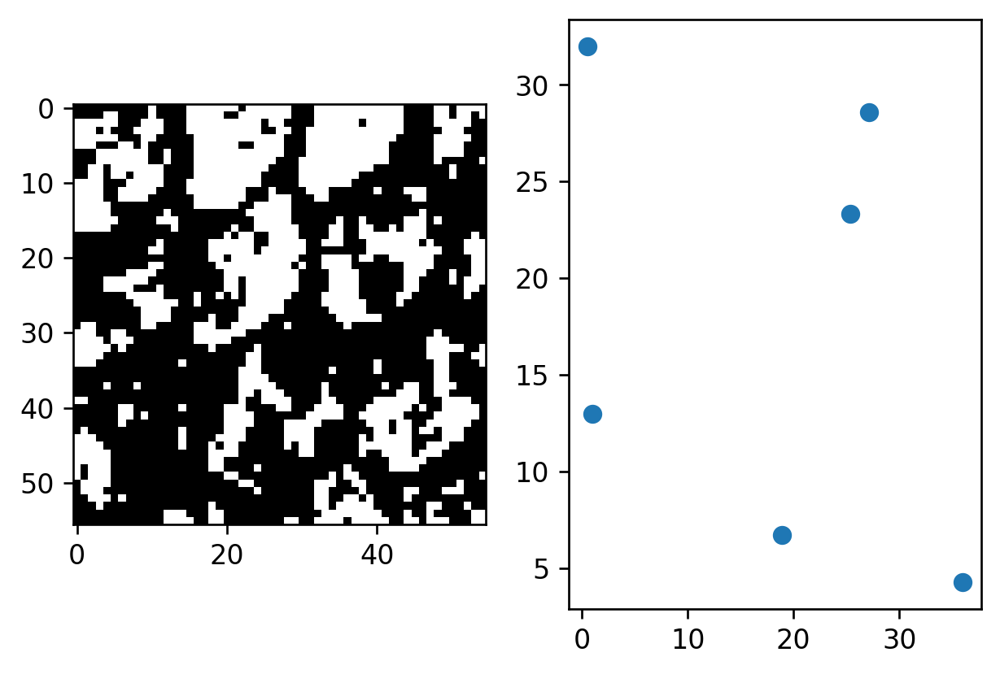

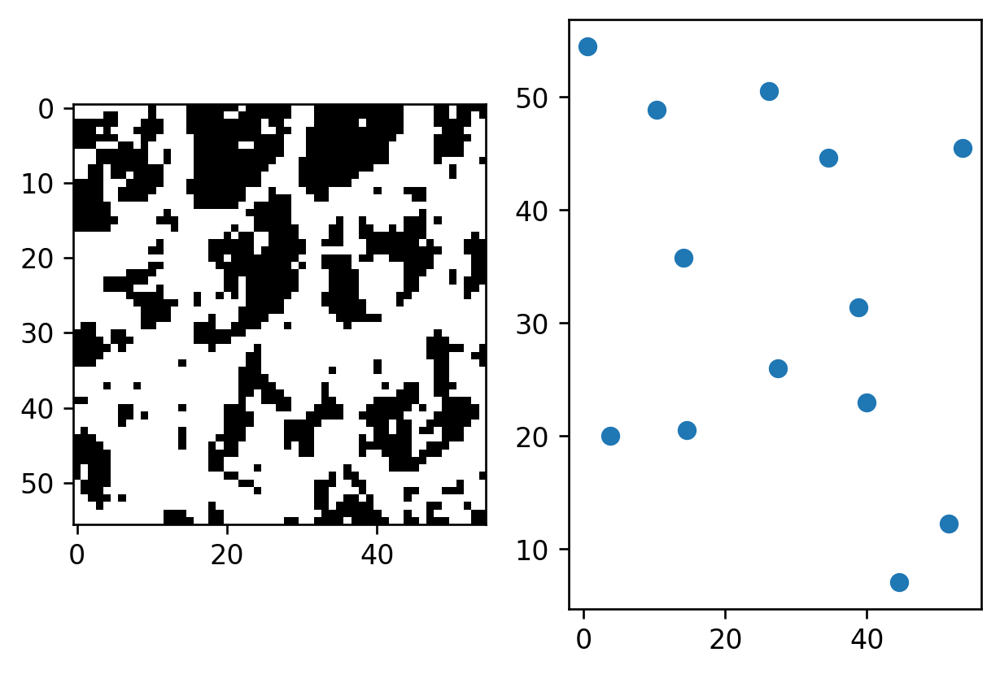

5.964718620080735
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.667212499668725, 5.9

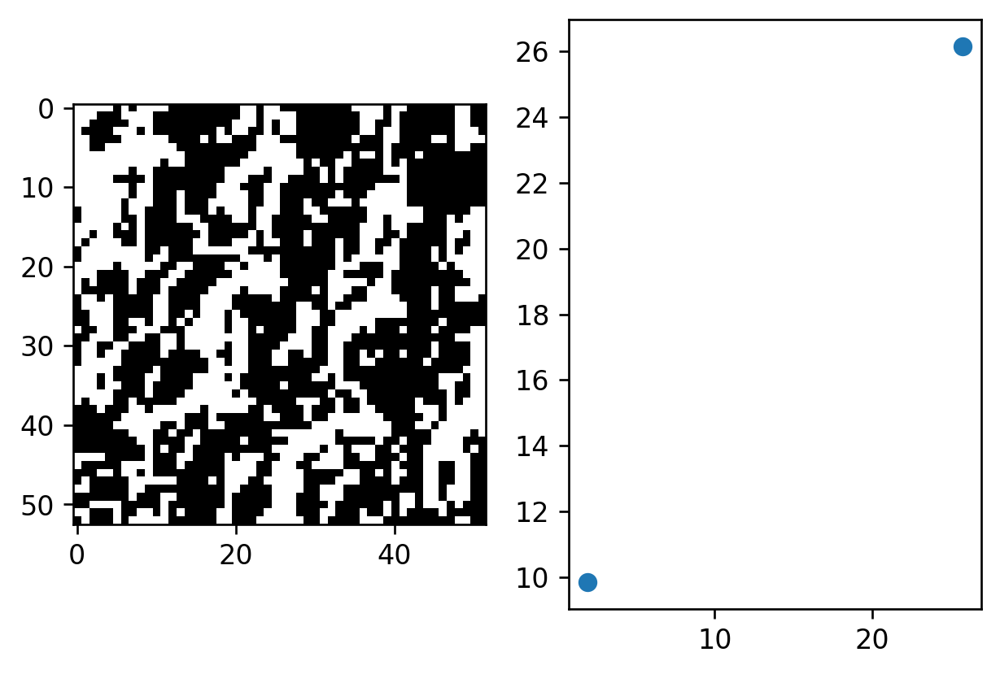

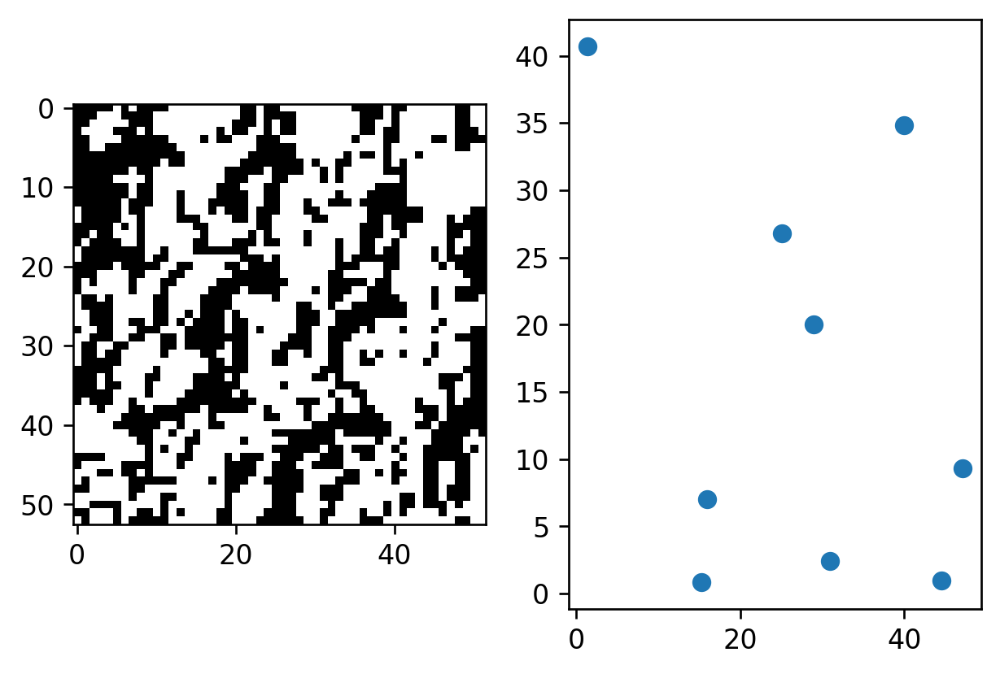

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.149054860437795, 13.66721249966872

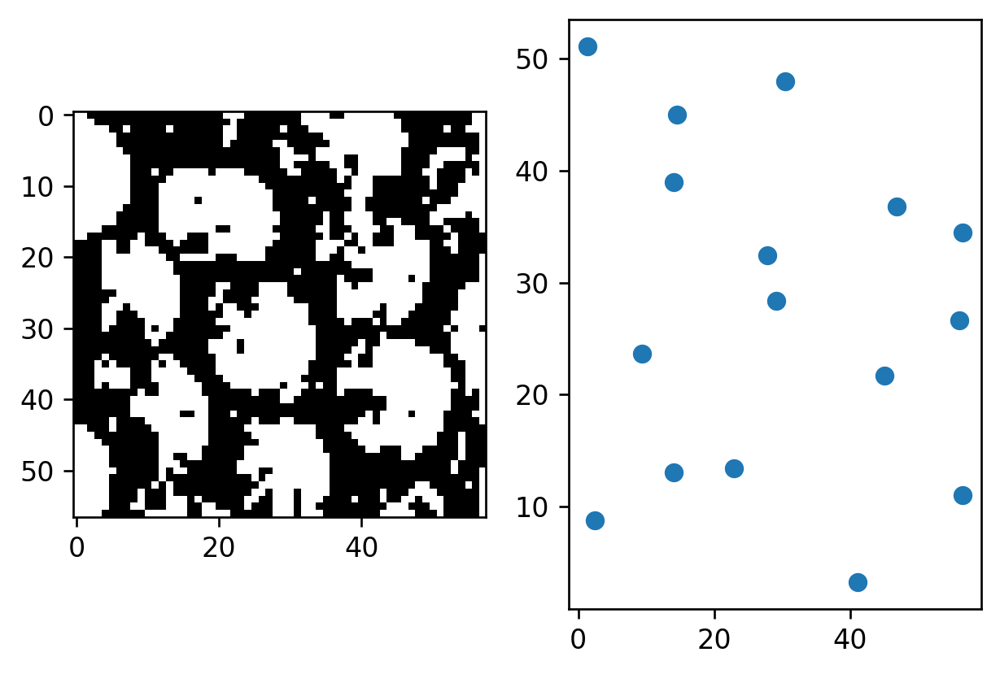

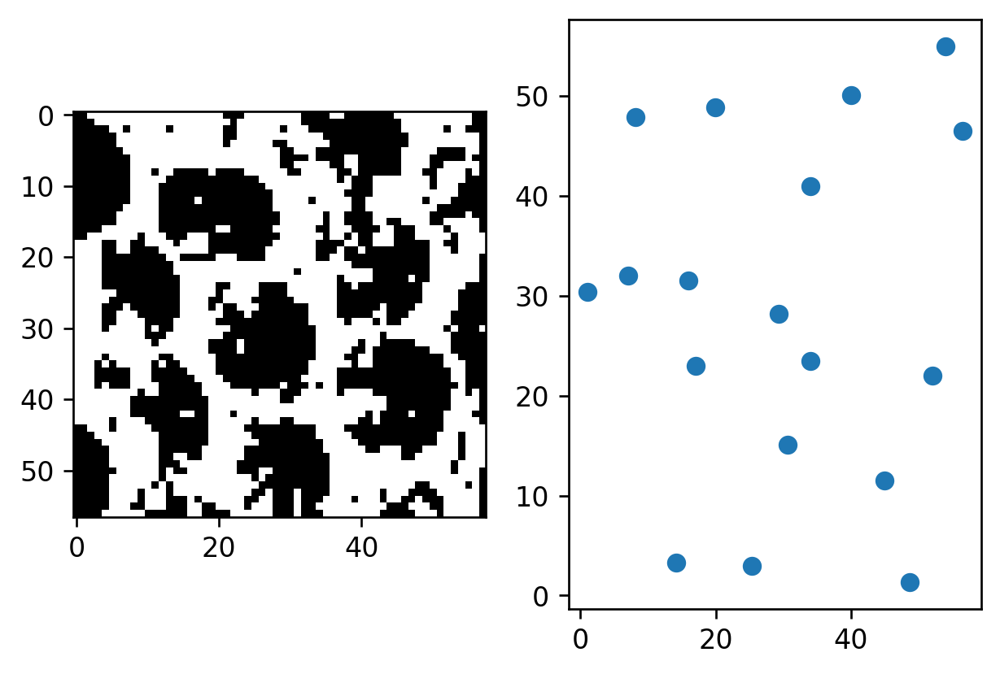

4.024311891383629
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.33960848226737, 9.1

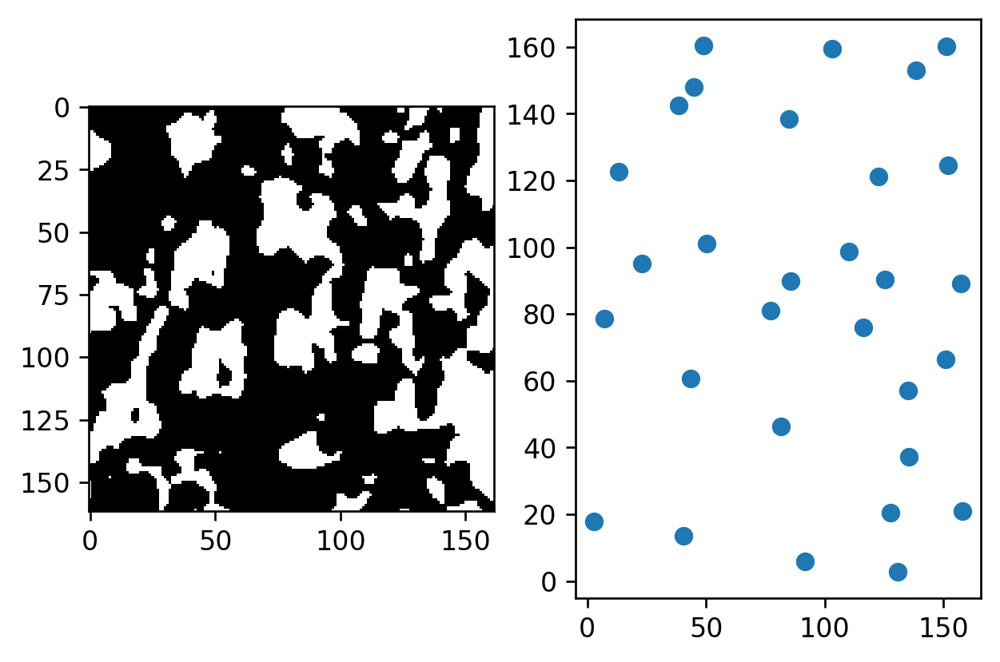

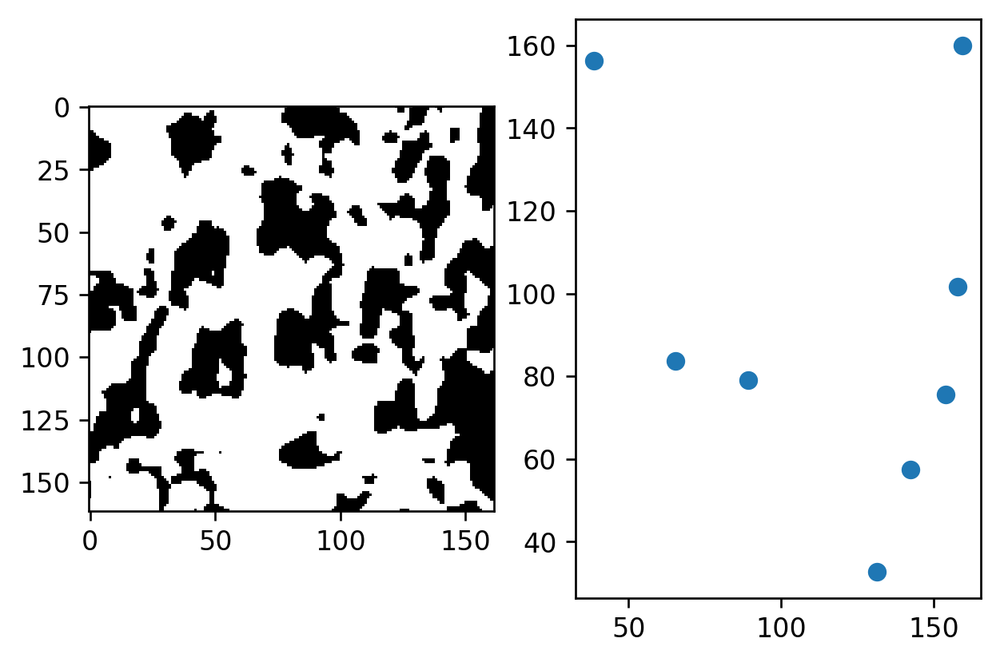

9.00078461189411
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 13.890481232458962, 9.3

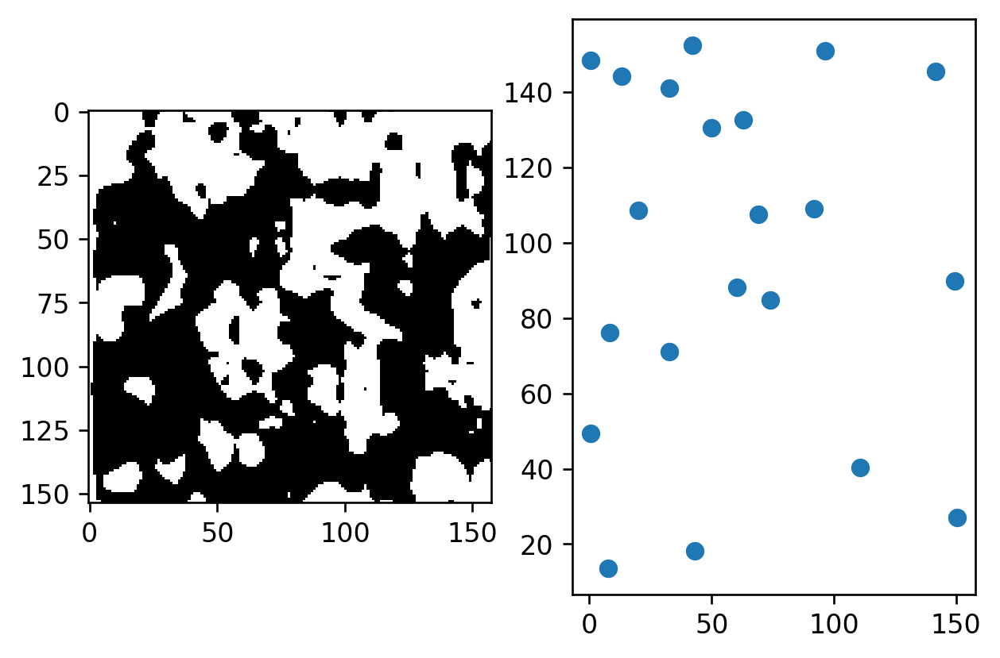

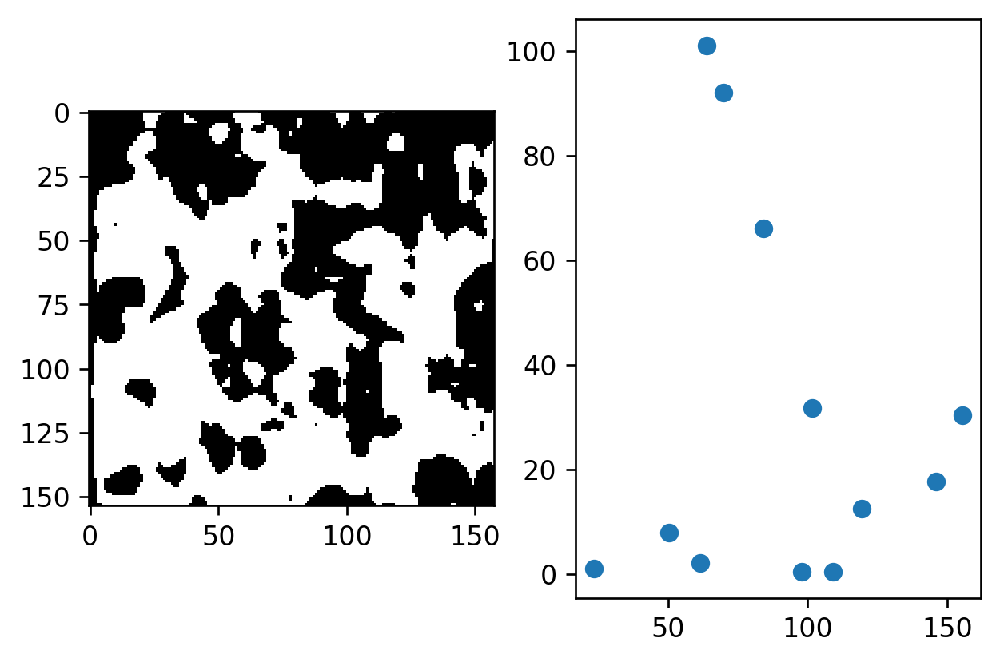

12.754656378436701
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15.301342464039854, 1

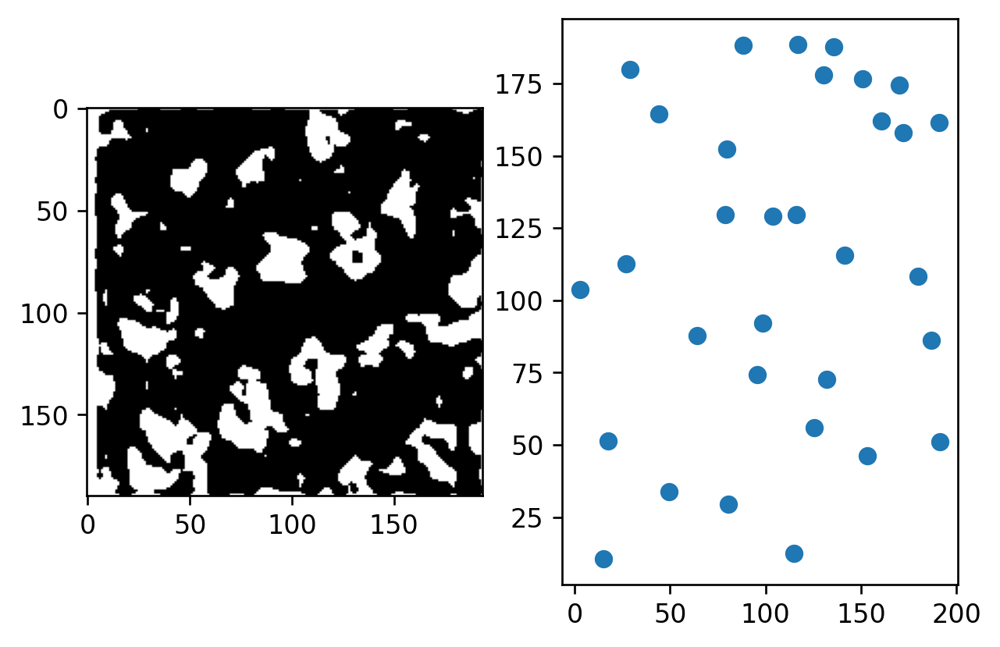

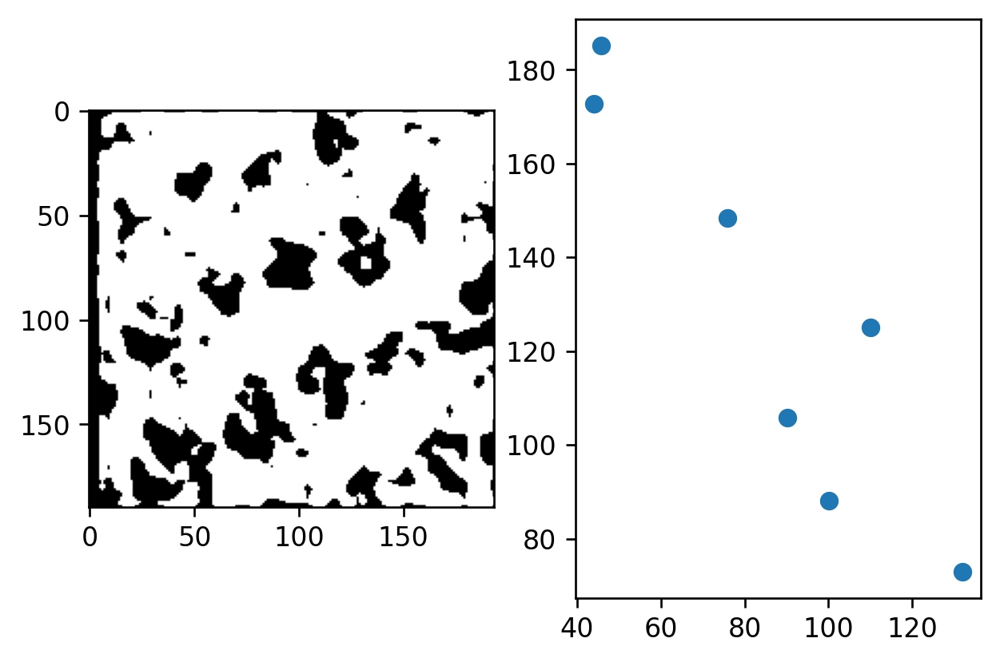

8.423312564400279
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.441232874901562, 15

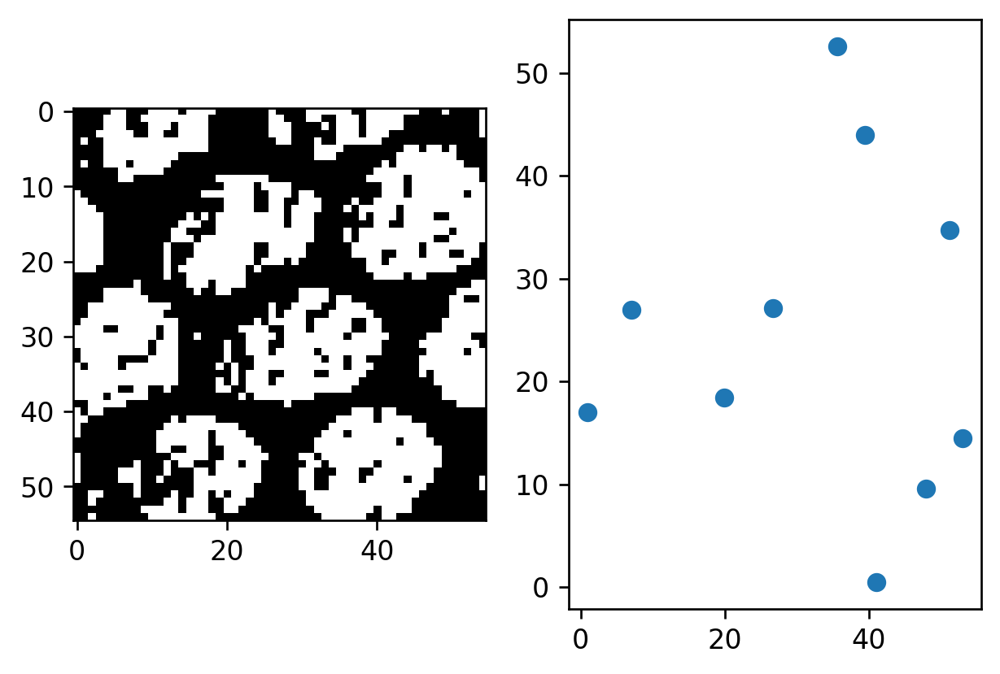

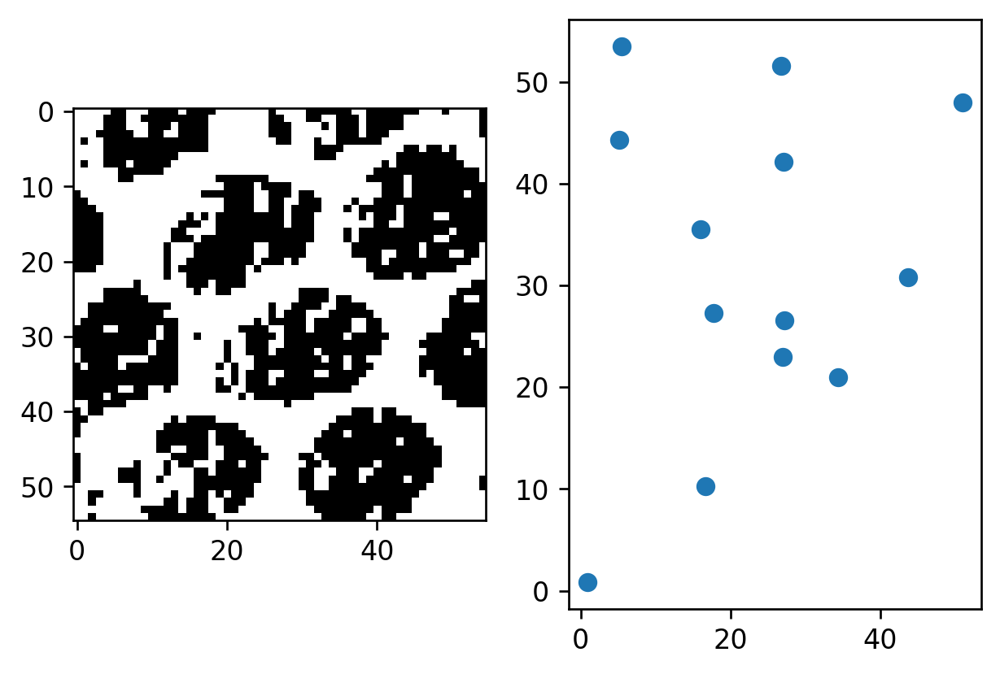

2.23946439962704
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.753880842919452, 21.4

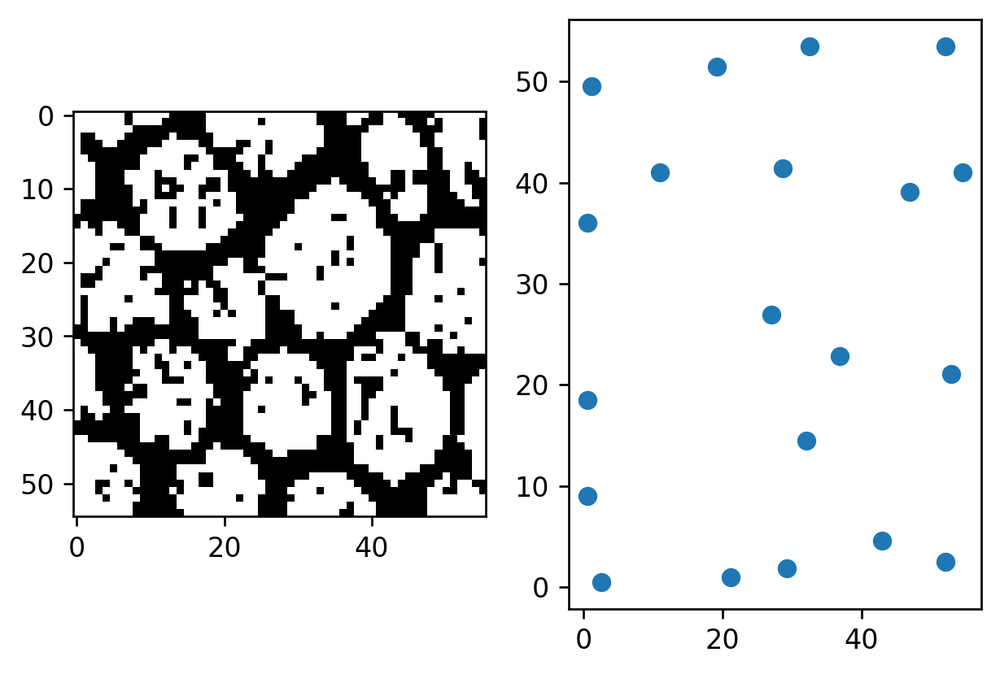

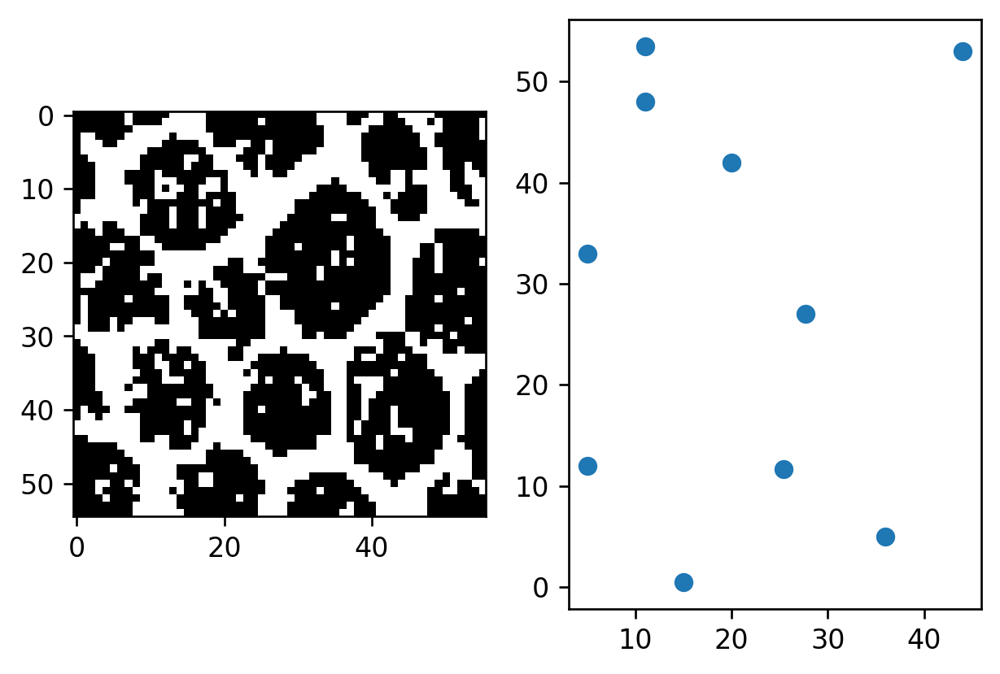

2.757442829542871
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.530771415969816, 13.7

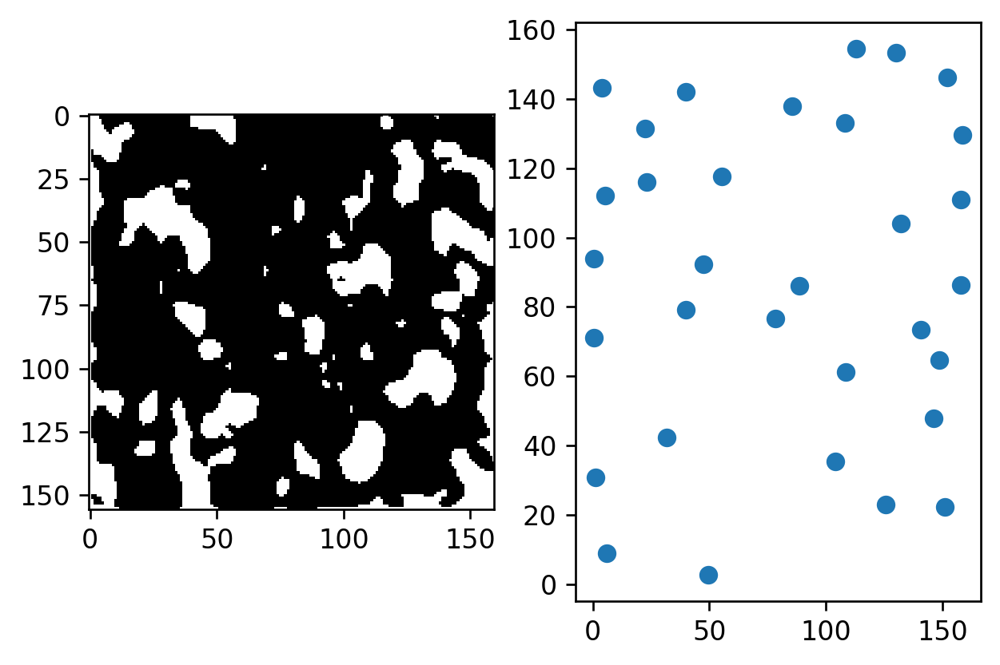

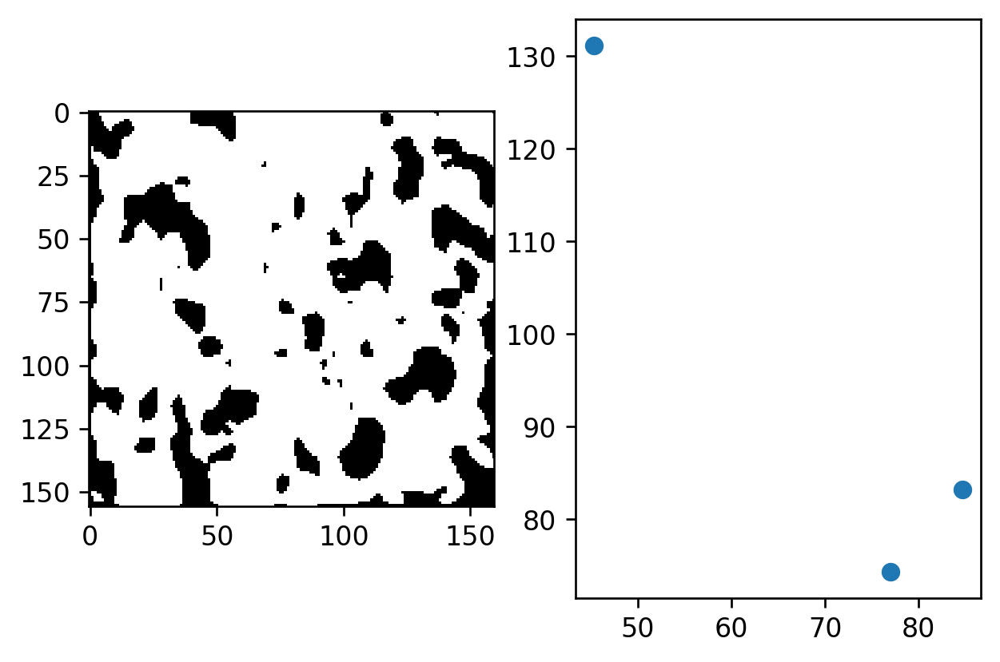

7.184056620428285
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.244174025625465, 16.5

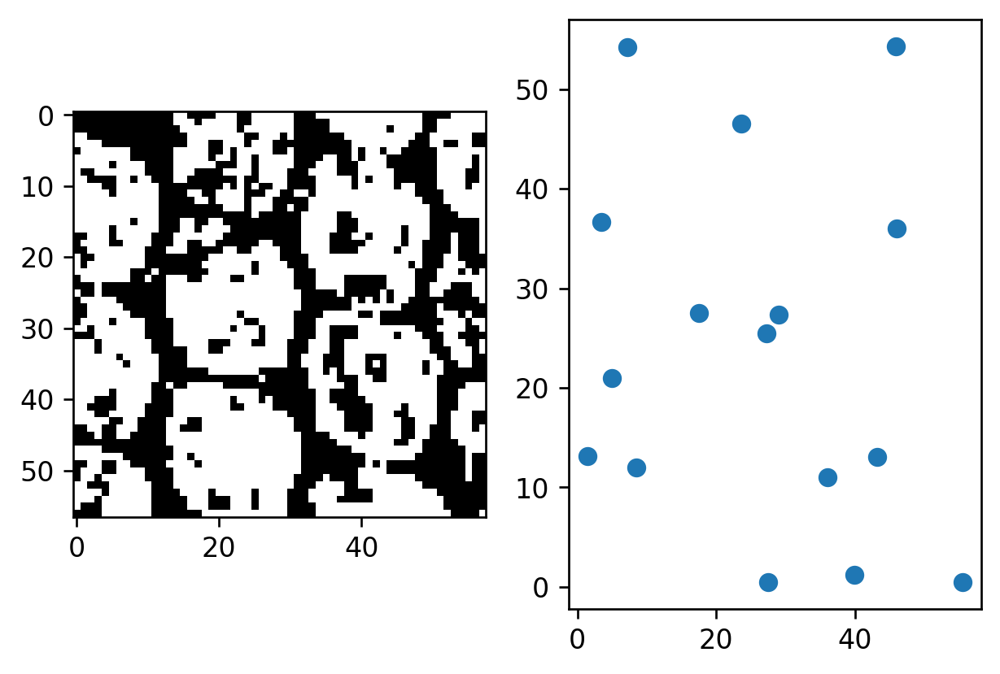

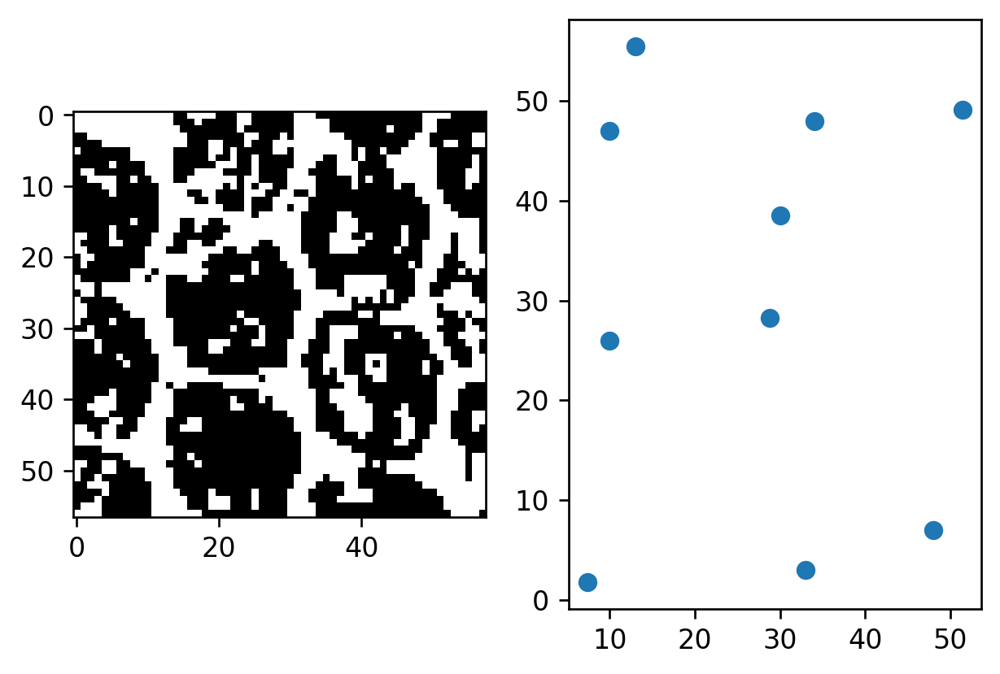

5.326531612081249
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 9.0517526458567, 14.2

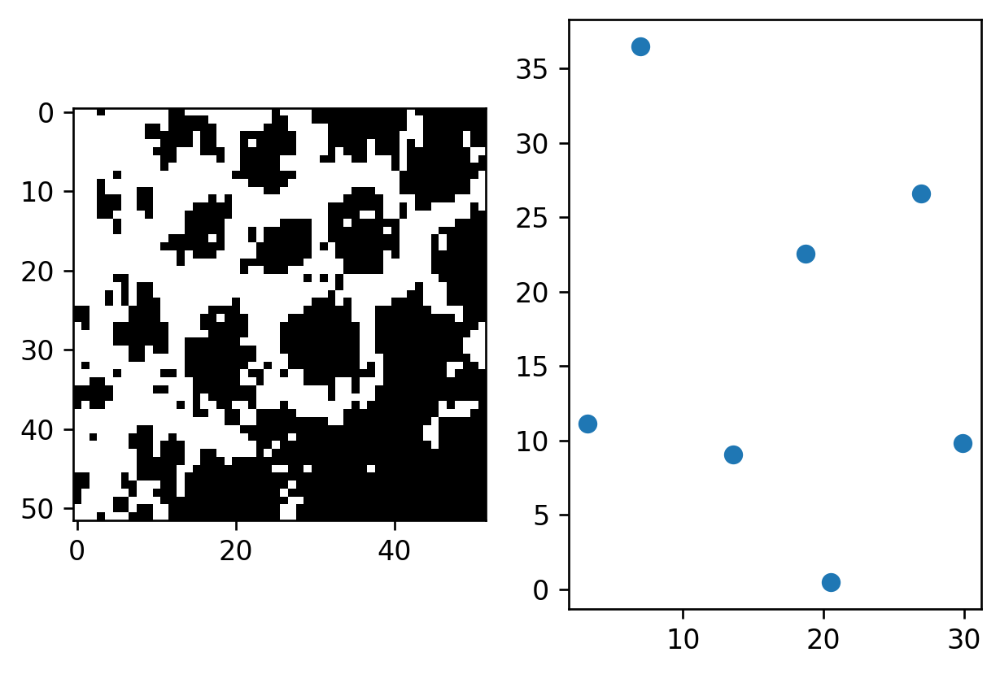

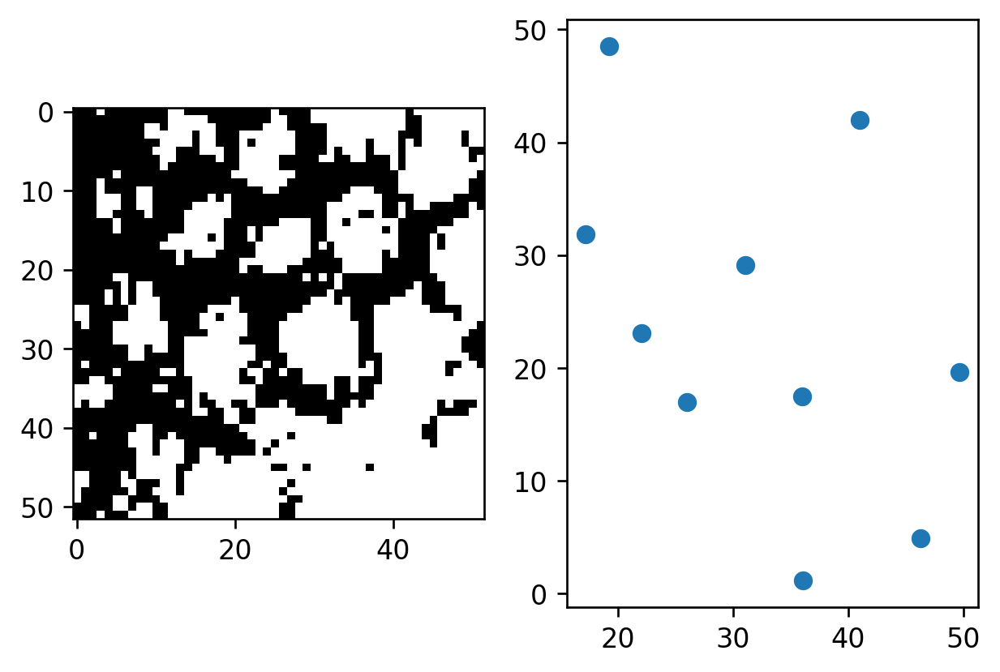

2.9316587392148237
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 16.62520539350658, 

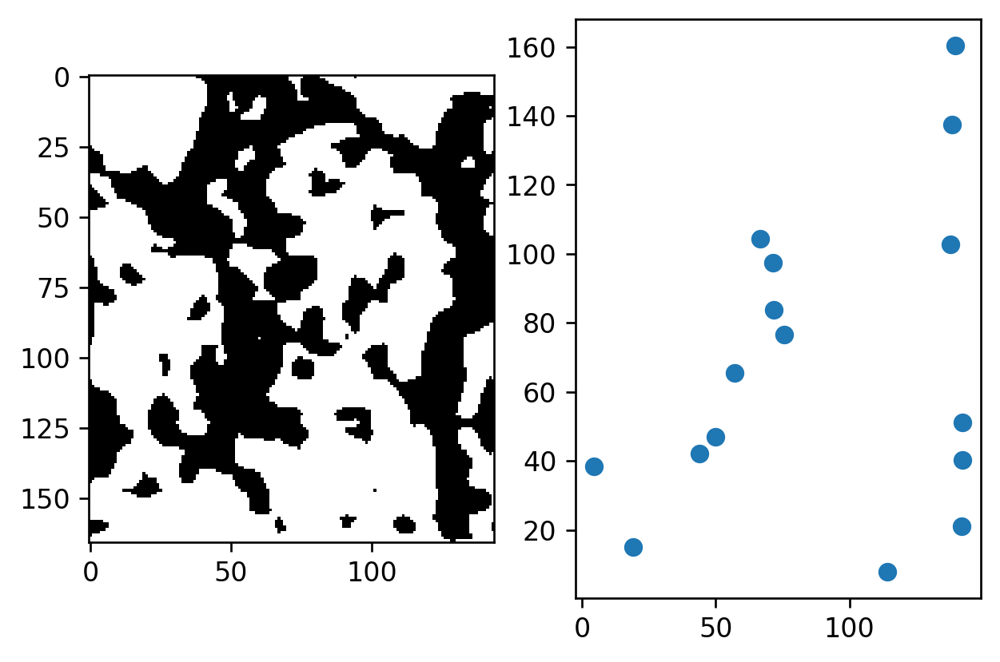

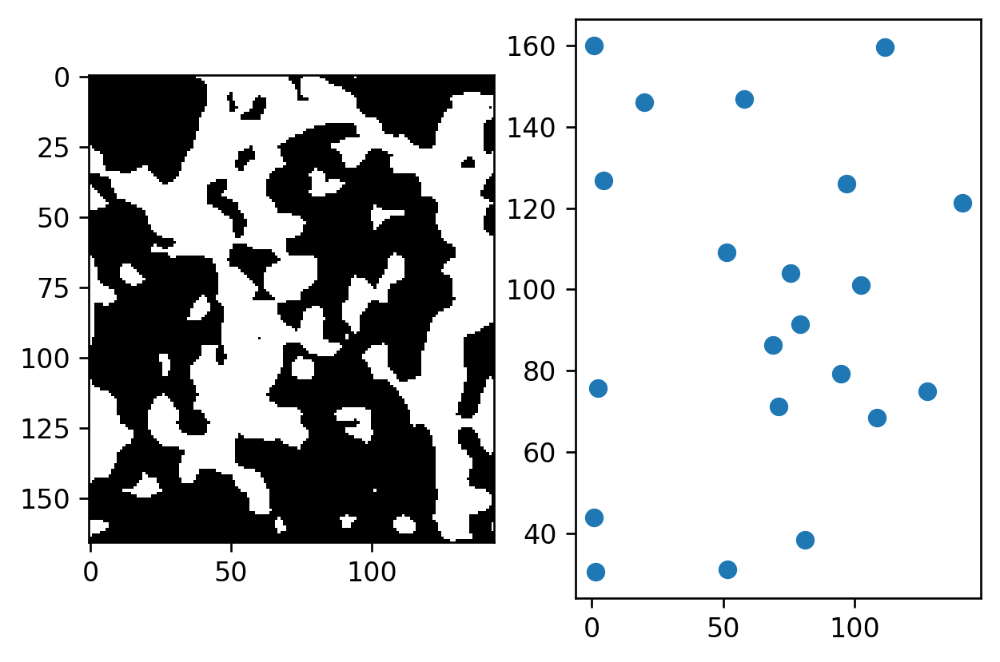

9.189527903744558
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669208, 

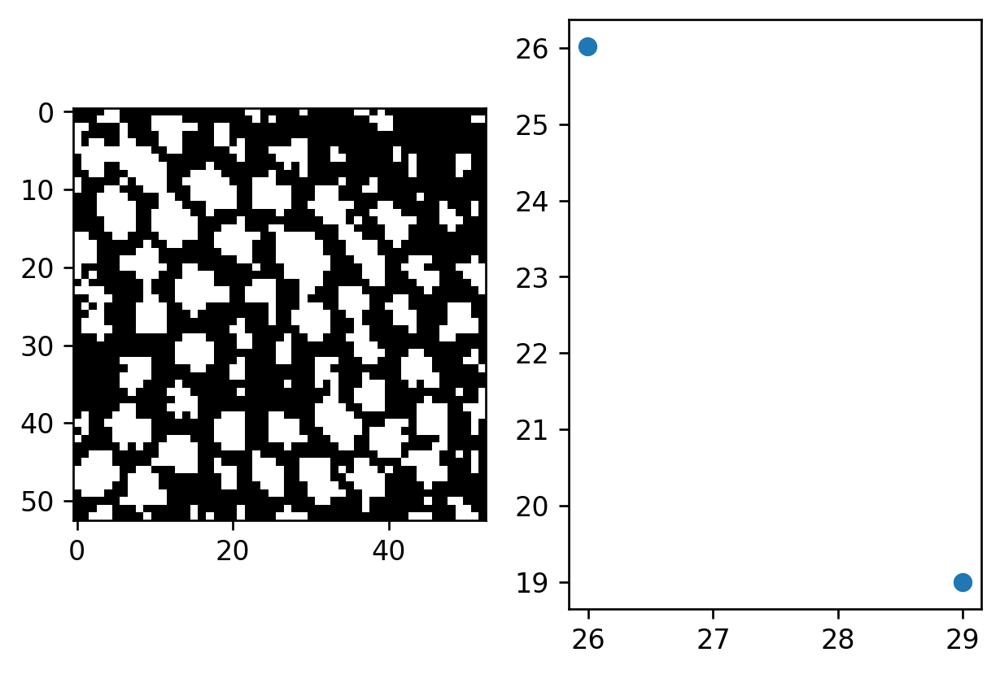

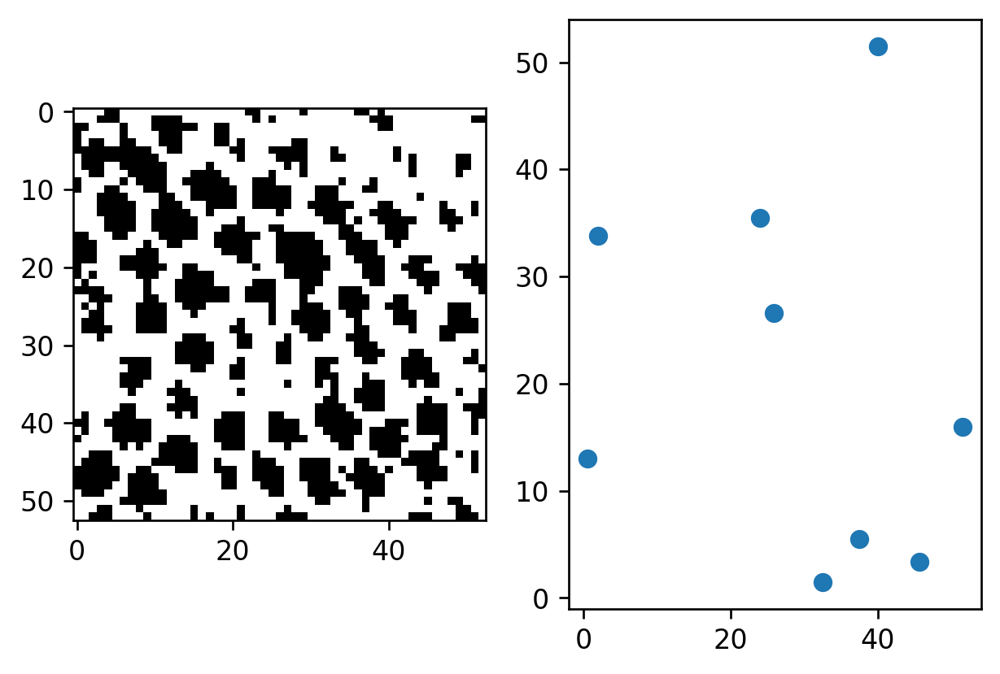

0.0
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 21.616839337764663, 12.20117720669

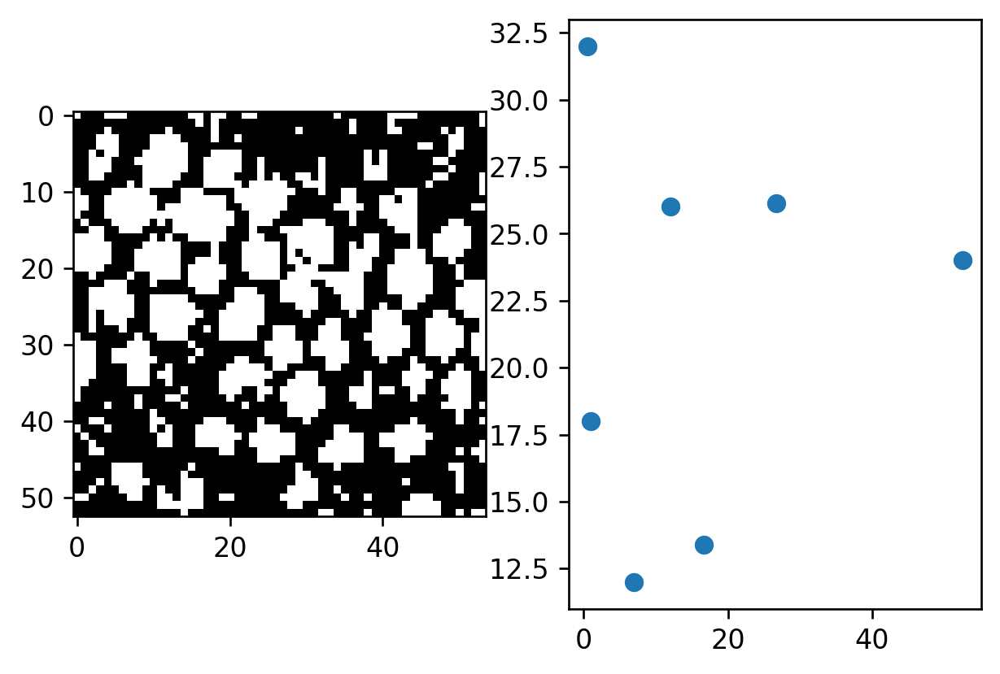

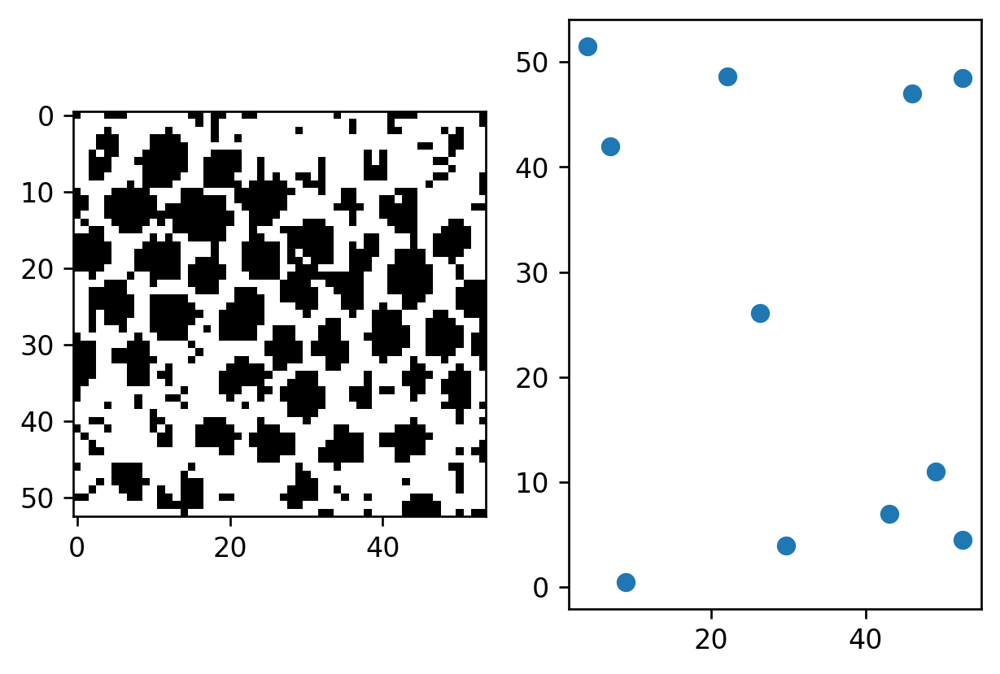

5.592994334595194
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 23.554841027078226, 

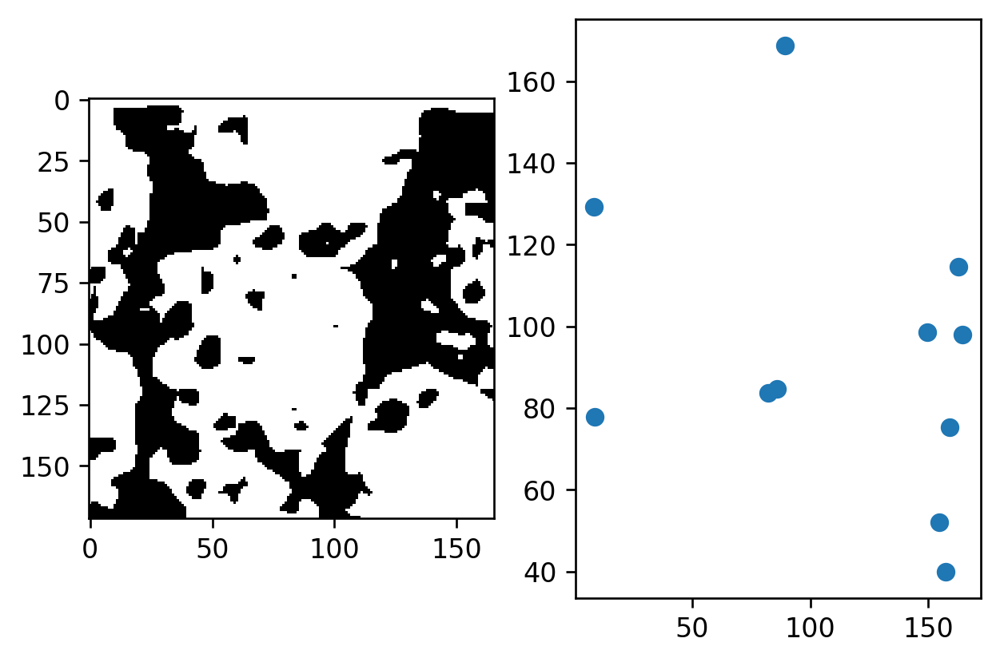

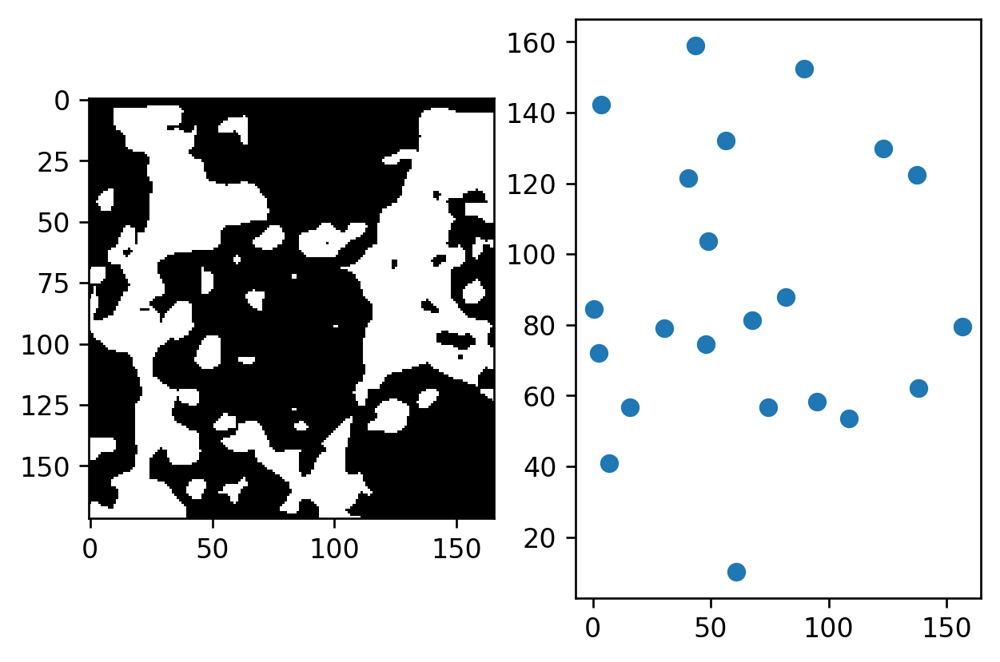

23.997769593224497
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 25.49536730450329, 

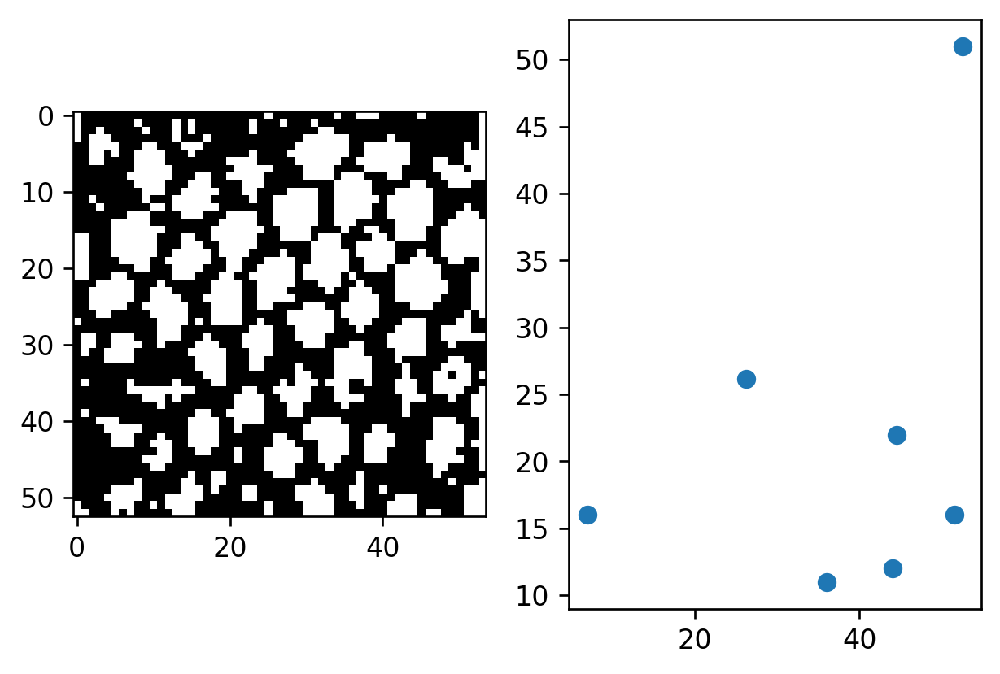

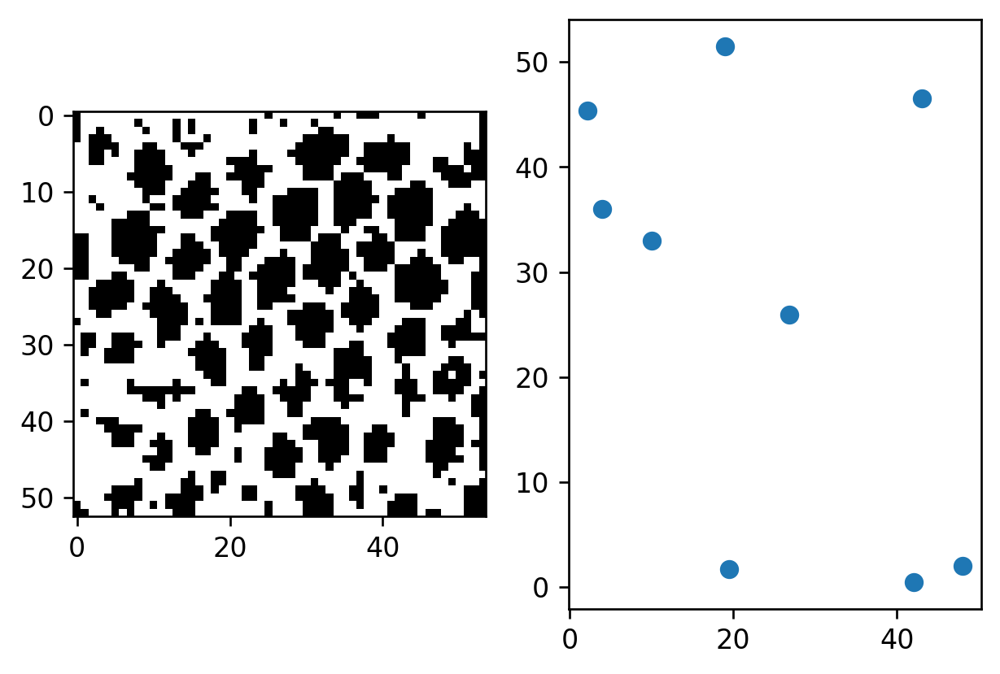

8.050519248319484
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 14.831722694940897, 

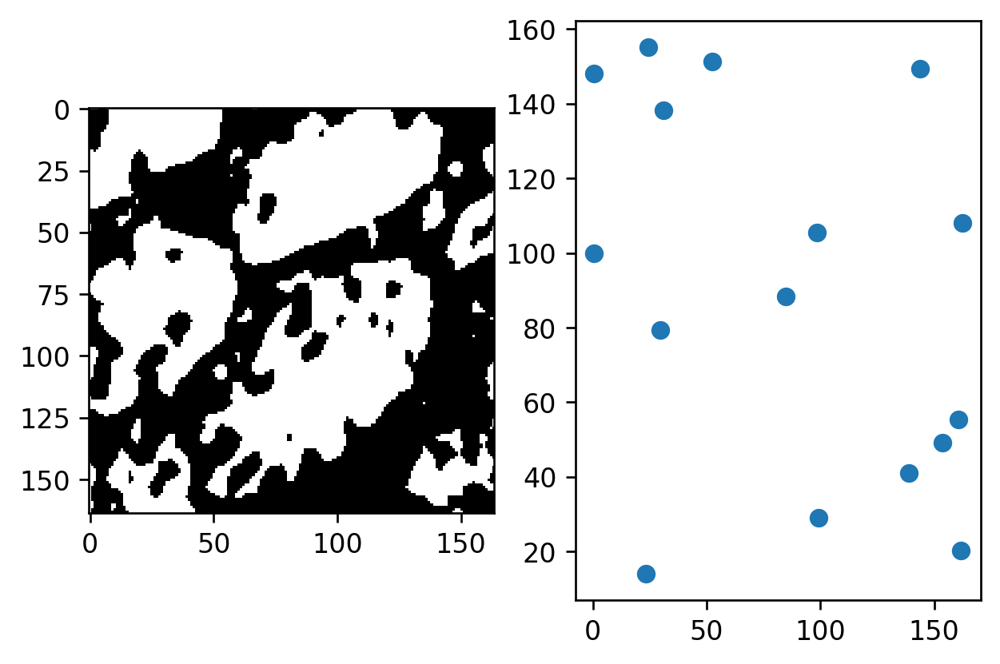

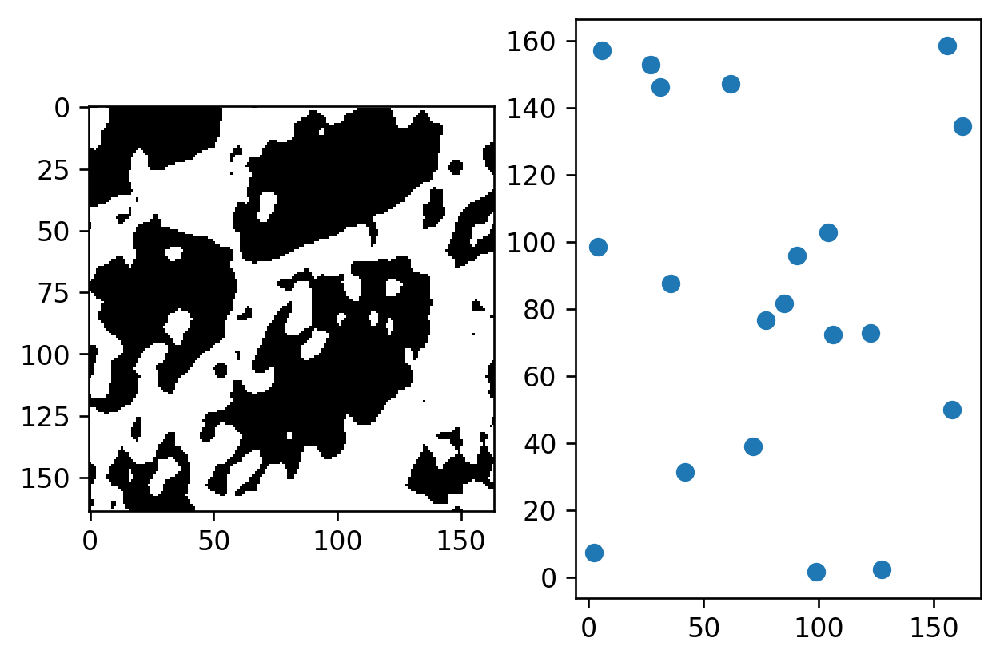

14.592062357188894
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 15.479265932507946, 

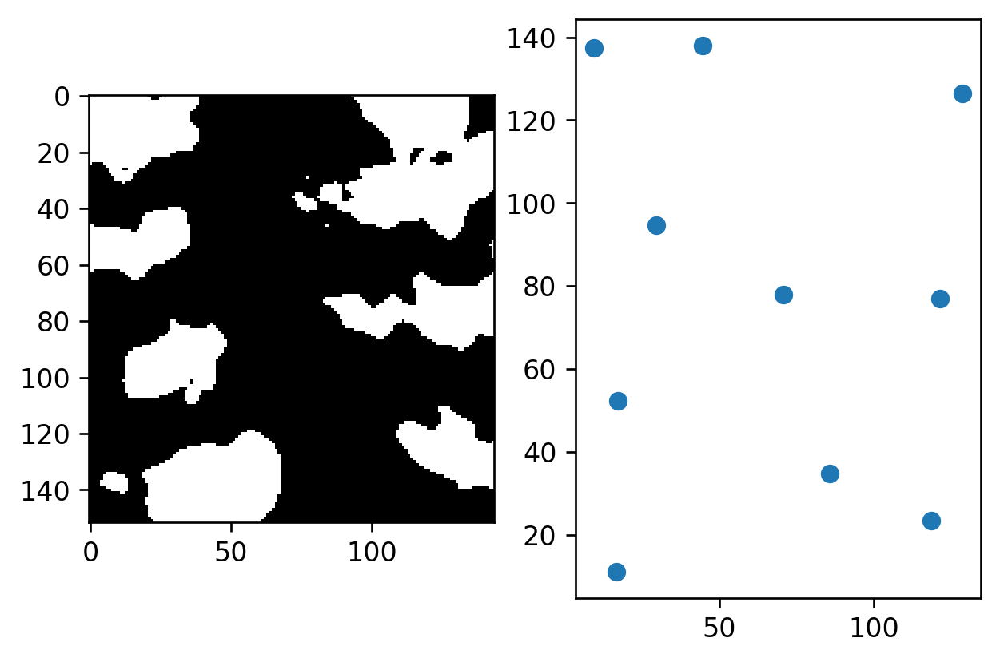

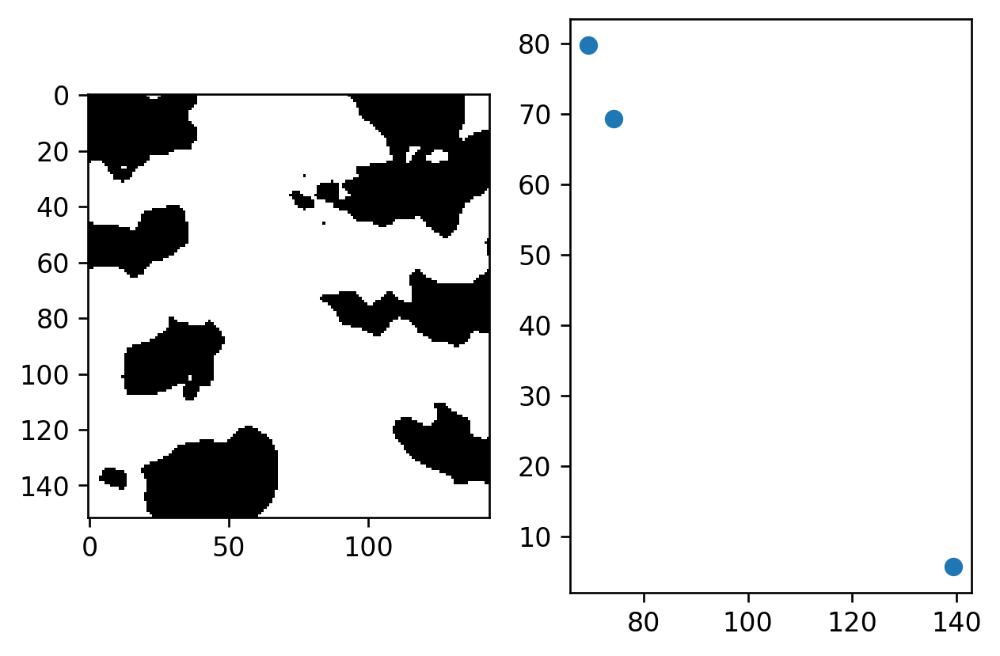

5.6606560420883465
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115]
[9.570454660866675, 16.196749921268434, 23.24440056960923, 

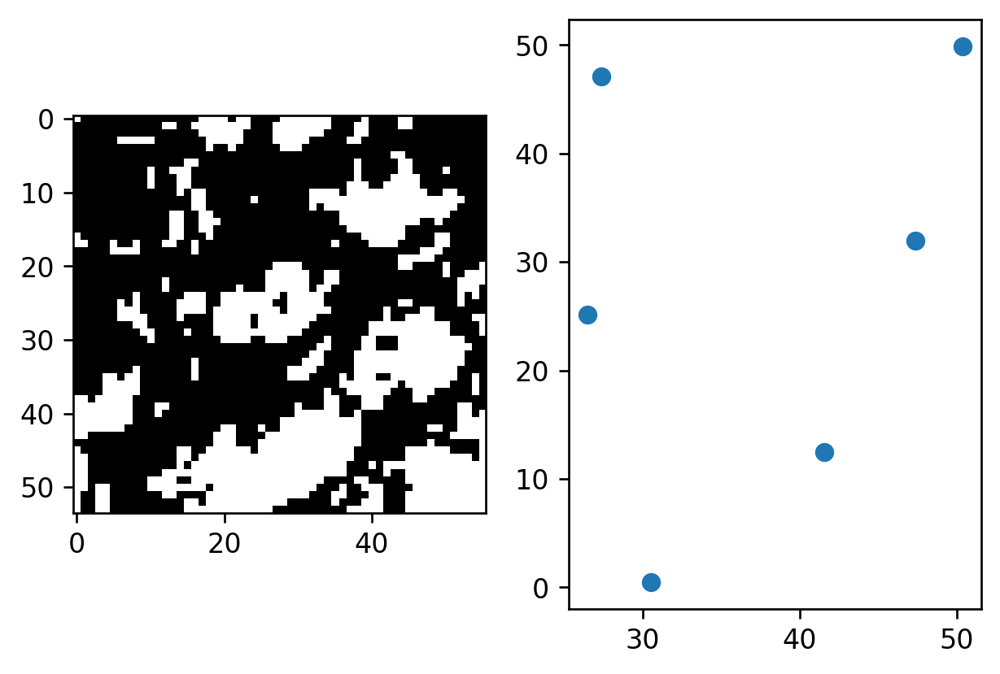

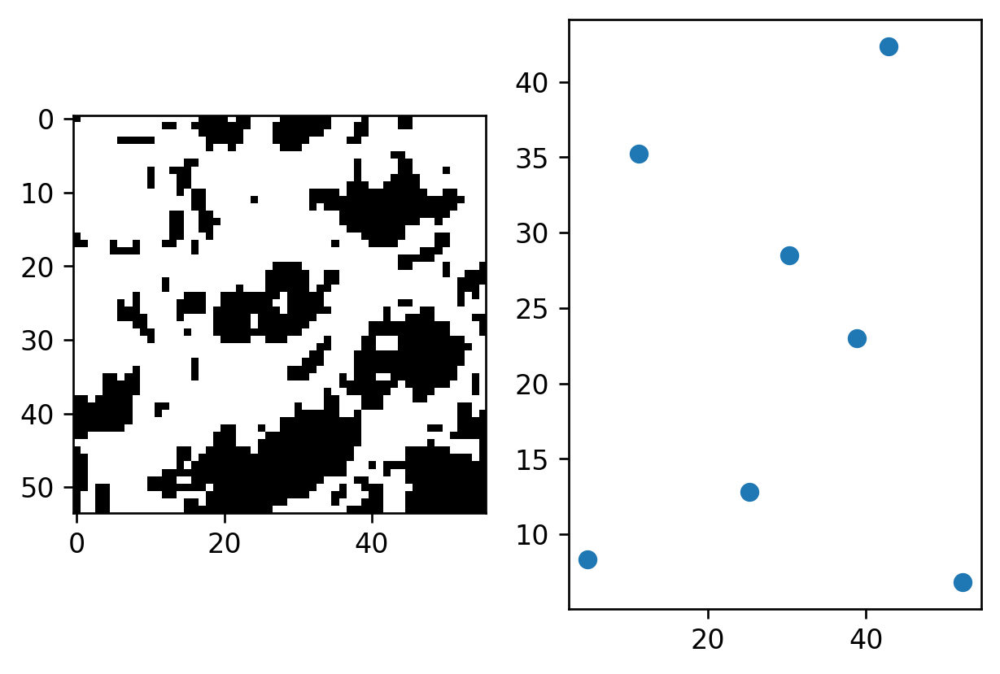

1.9899839030343176
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126]
[9.570454660866675, 16.196749921268434,

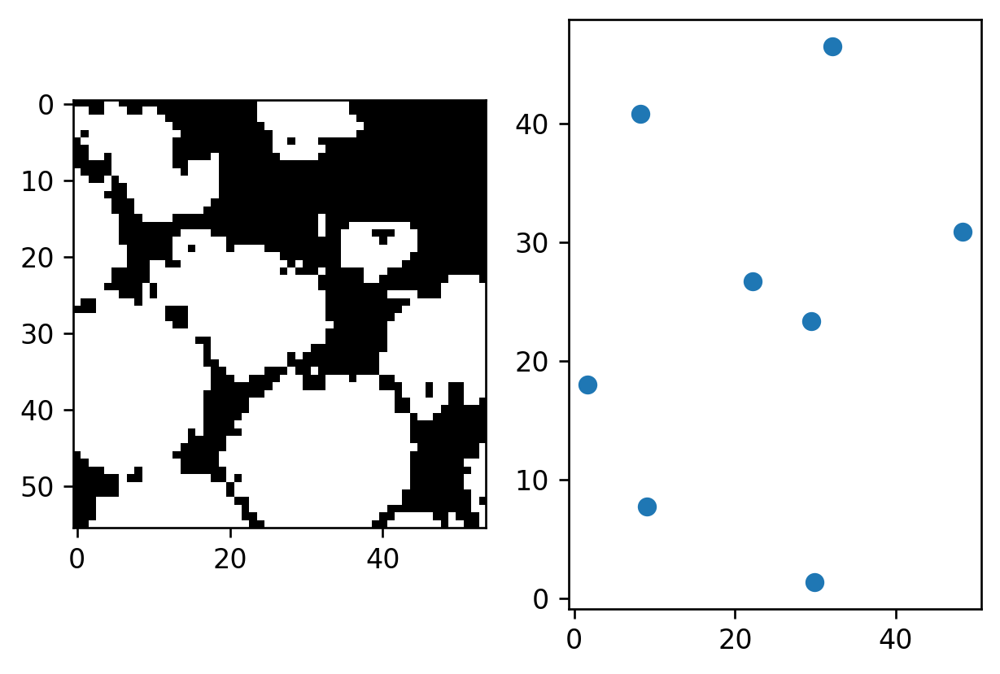

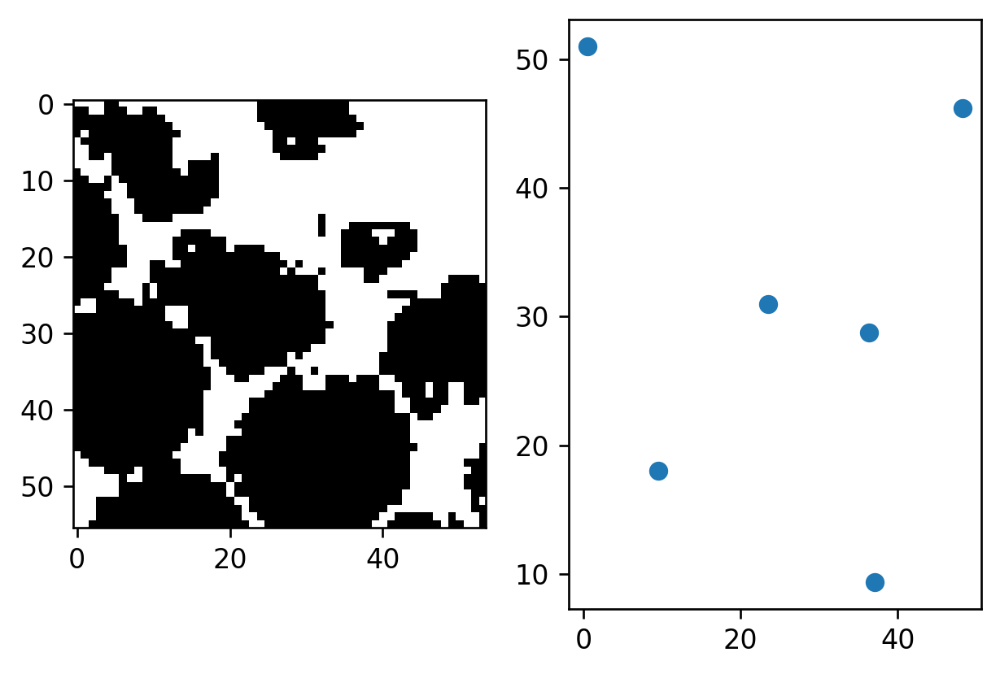

5.640950903369355
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249]
[9.570454660866675, 

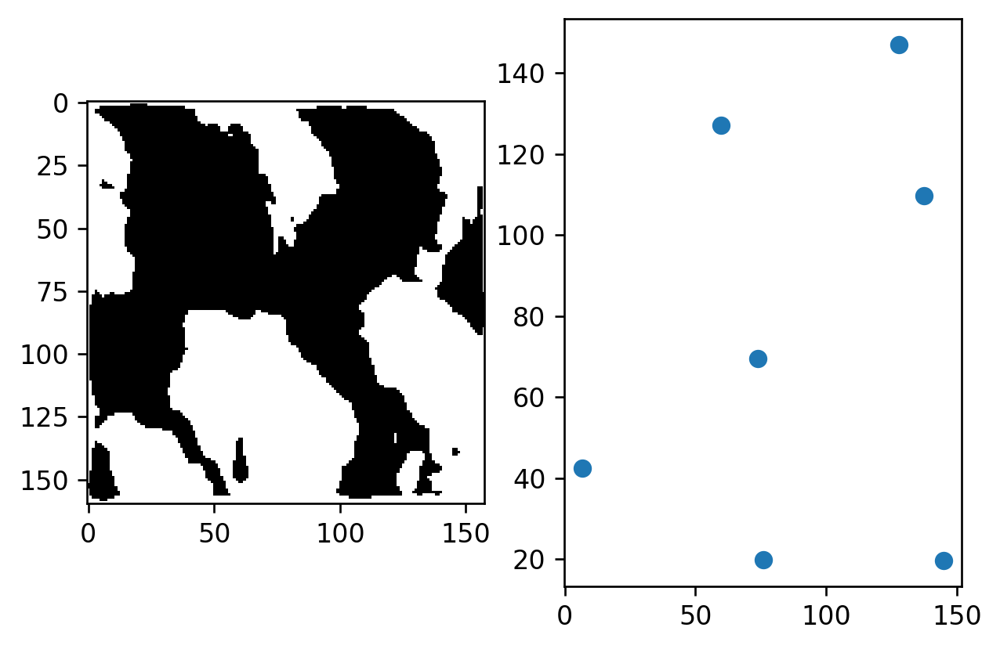

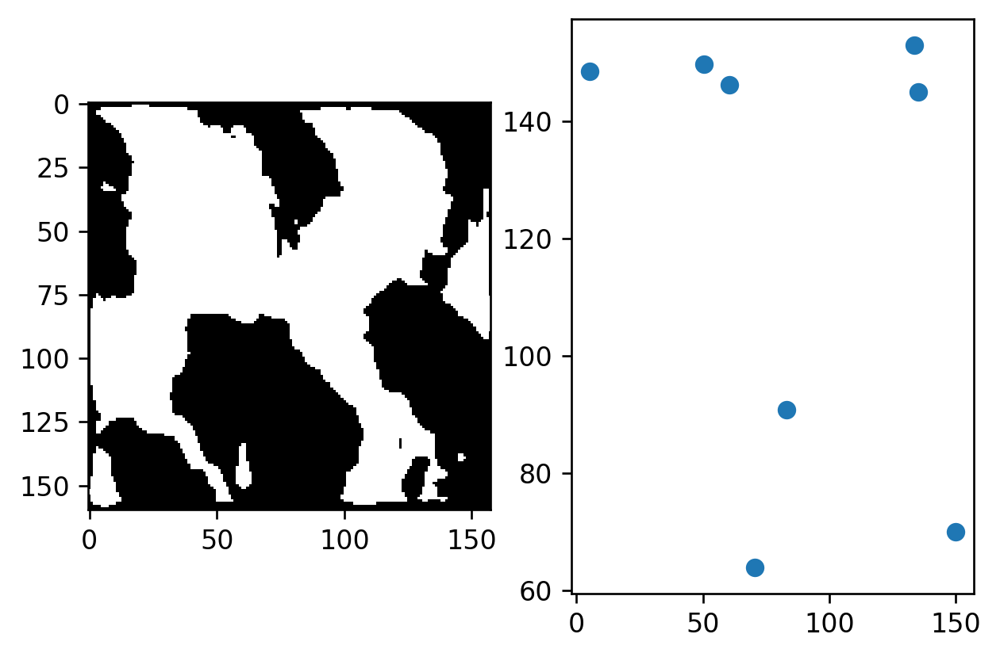

12.553121518263476
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344]

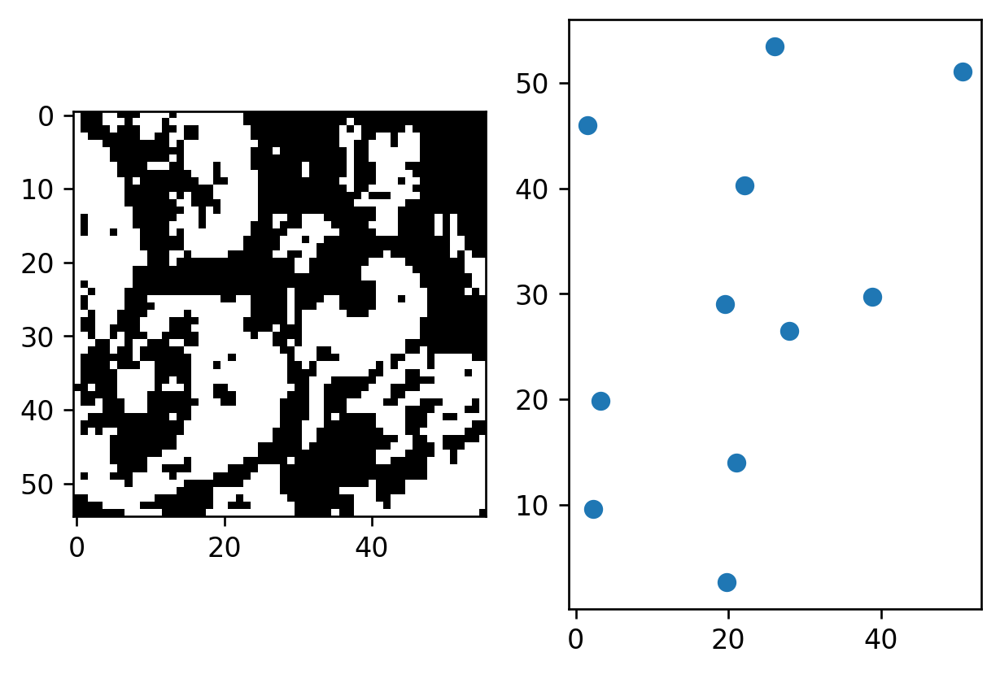

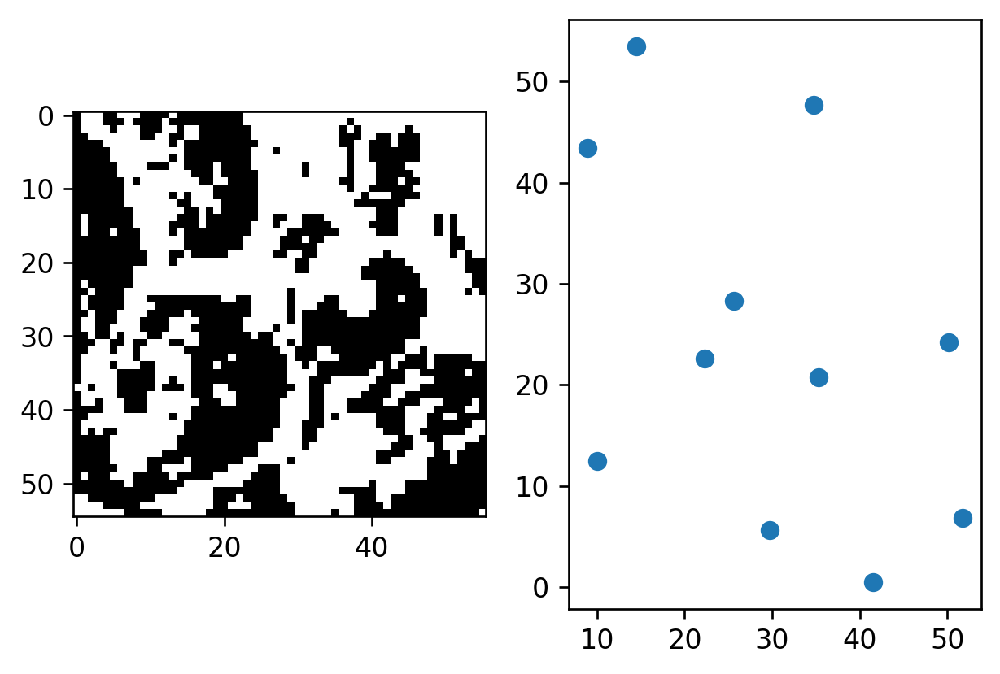

4.885173568002056
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344, 

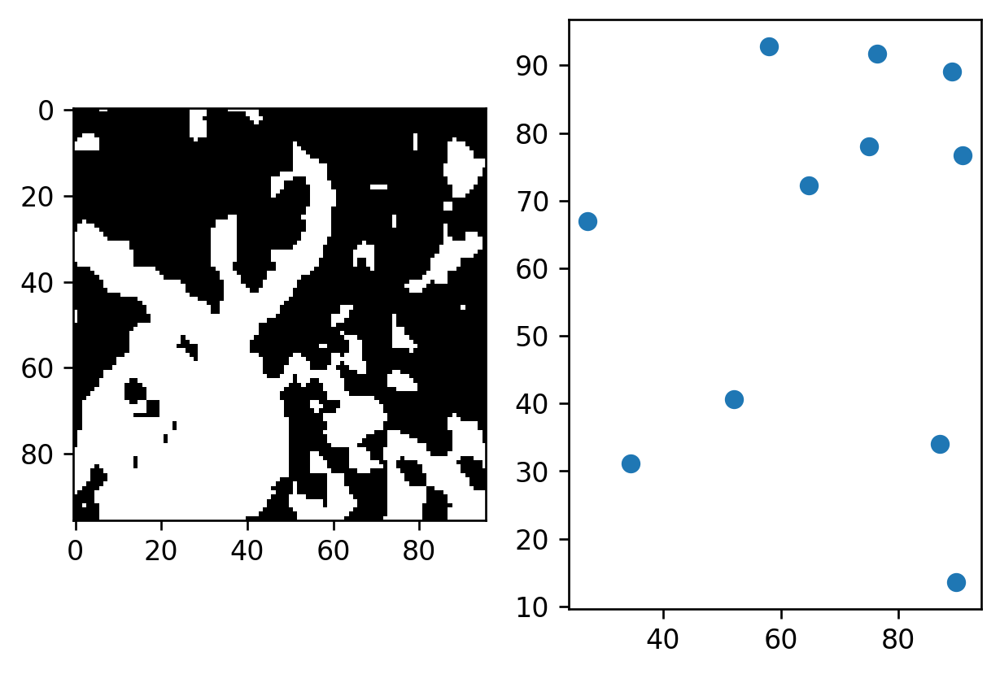

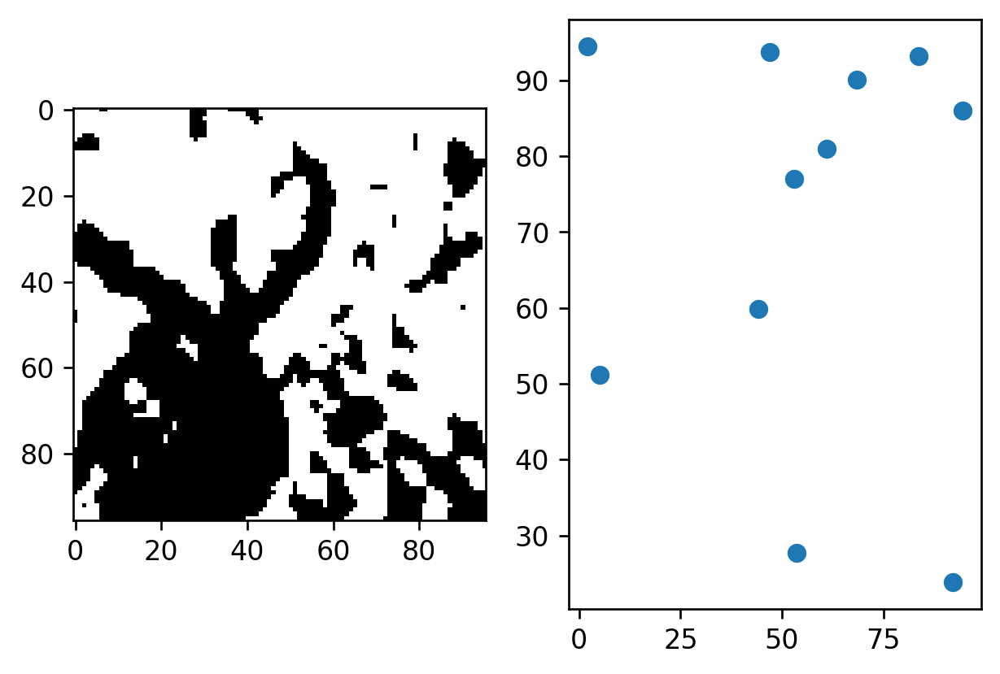

6.866238256579949
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344, 

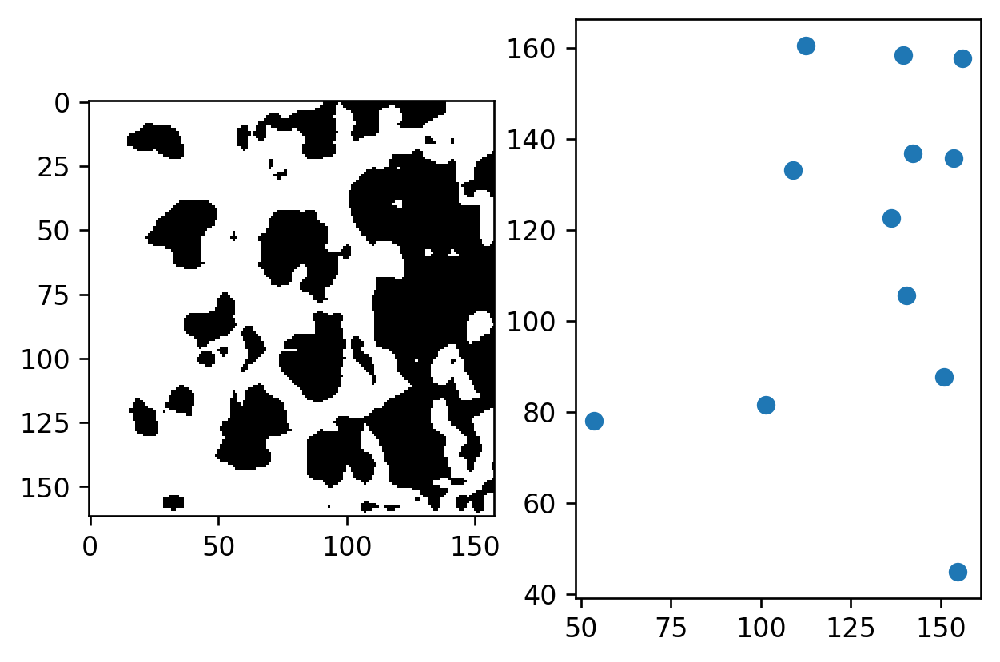

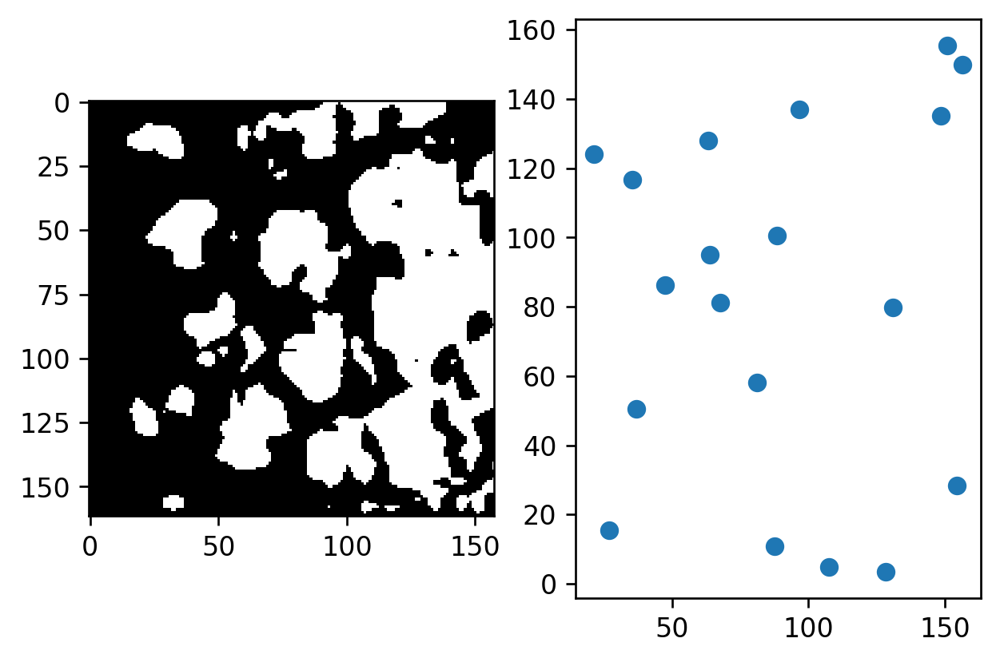

12.816001518091108
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344,

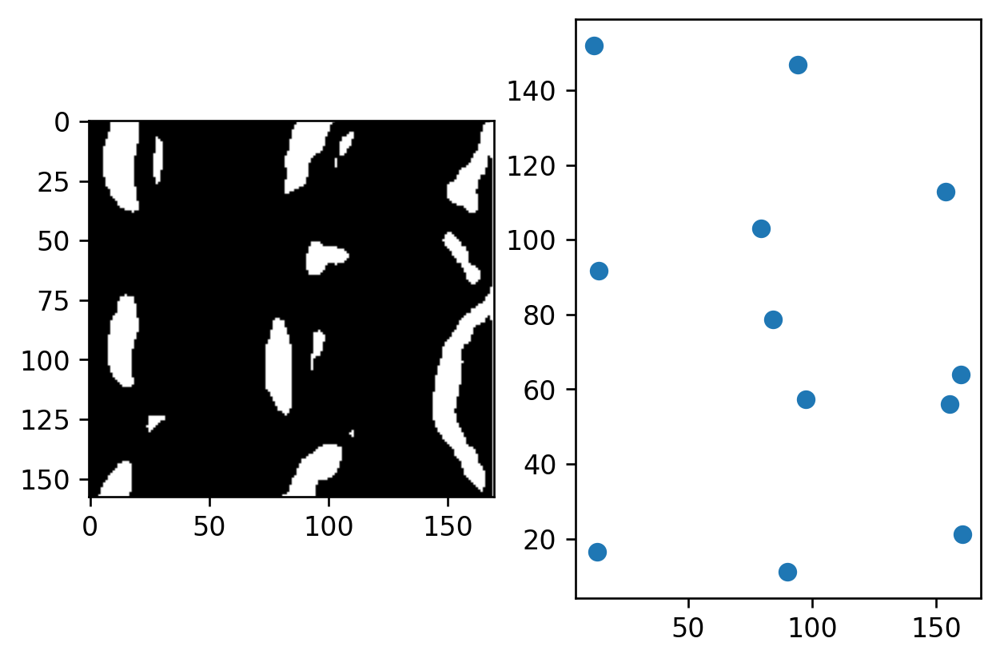

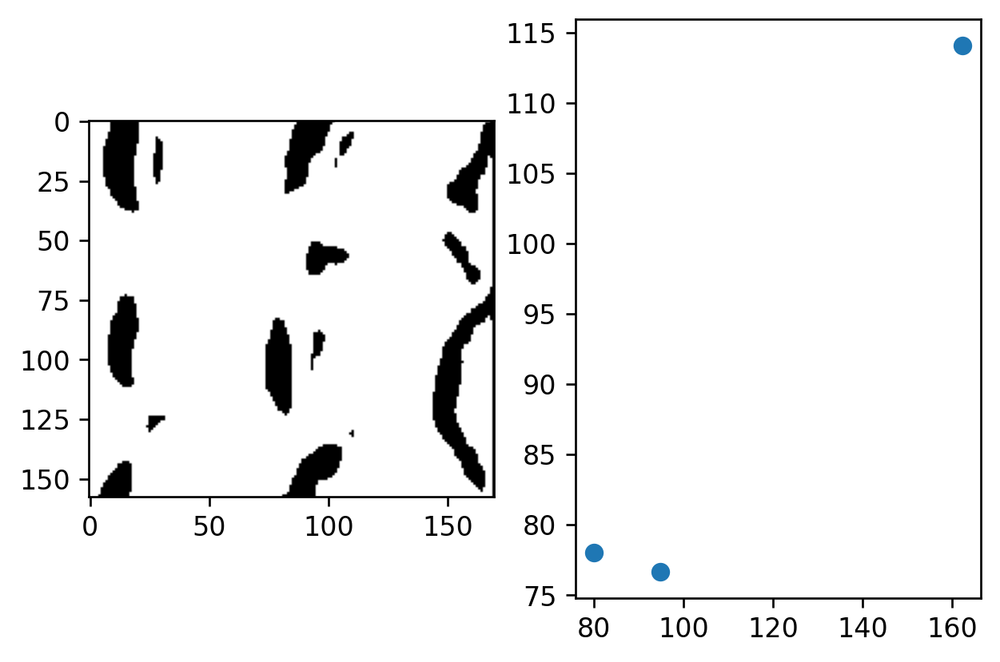

20.057914566040594
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344,

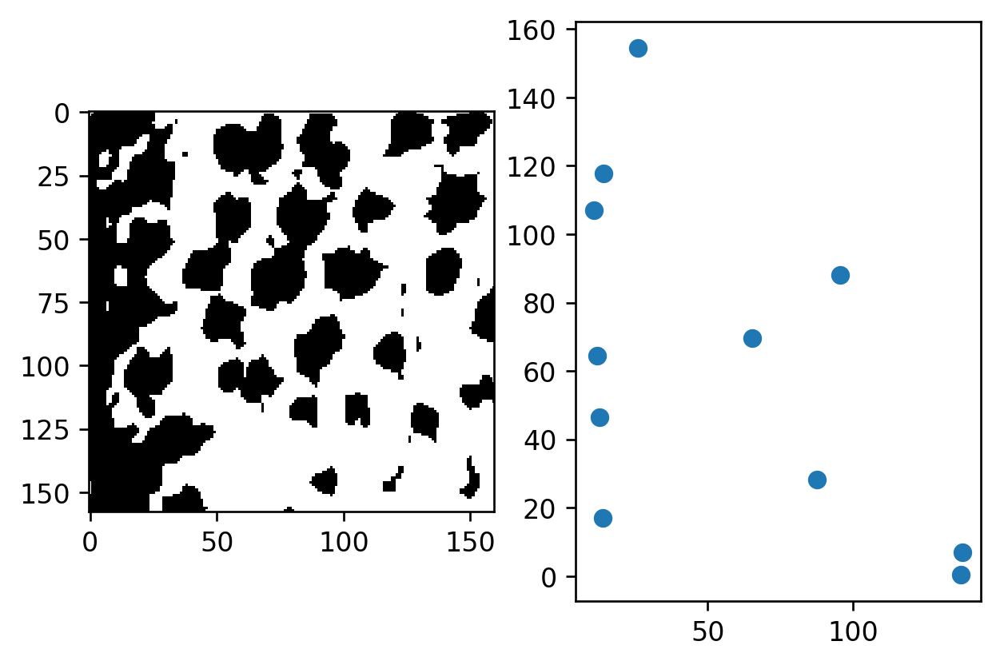

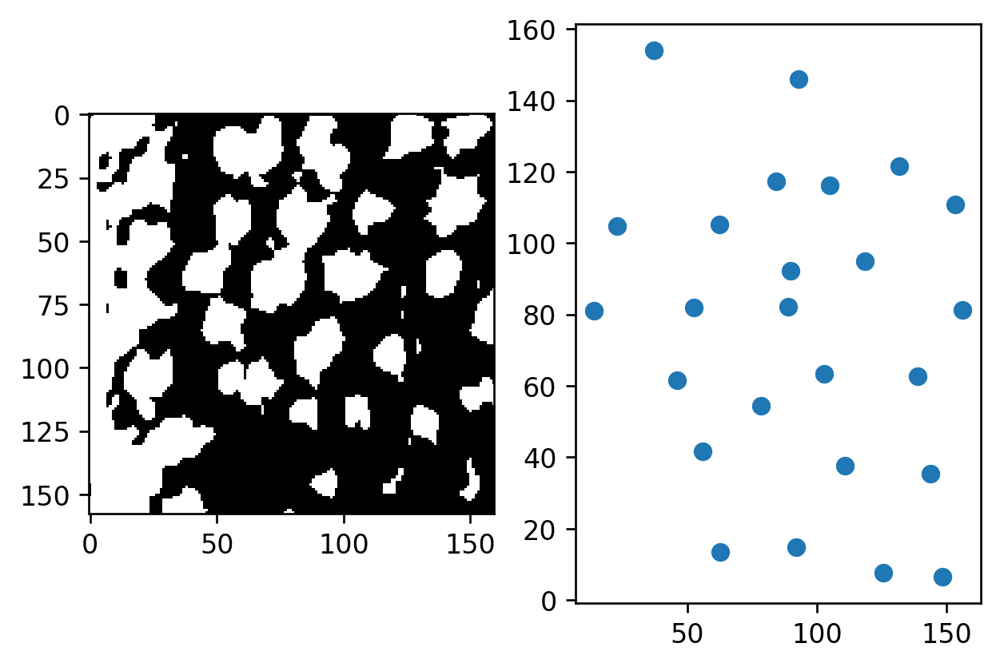

13.582468316340167
[13.247185549746275, 11.788686357456456, 38.59394849705544, 30.32330894793679, 14.87952149019338, 13.508109242037392, 8.164150146980093, 35.05771201458113, 33.18403487060513, 16.18748071809025, 12.746441756514944, 24.80004552076293, 21.877605217060104, 20.192345720523914, 14.560798841985976, 28.288336581696708, 25.431268876596498, 13.746509506116112, 18.16865025988747, 20.036766799060448, 17.991187607382184, 20.61919199254177, 17.52946404688742, 23.650964529758063, 33.13024238183553, 23.512965005384242, 12.077355838693652, 22.216533423607974, 20.829649449359014, 13.932074361236582, 28.857166210694057, 10.20182998137205, 22.69888857400598, 26.744881502769154, 22.922268368246108, 10.49047800312395, 11.00199463333826, 21.195836836180682, 11.261284629393991, 11.712749163217508, 17.304951712625304, 7.640252376561329, 13.314683225302222, 26.30609705419583, 14.810963174780056, 29.09921106504406, 41.055670133584115, 18.440301336349126, 15.658015666574249, 53.922896452655344,

In [22]:
standard_deviations = []
inverted_standard_deviations = []

def shortest_distance(n):
    min_dis = np.inf
    for i in c:
        if i[0] != n[0] and i[1] != n[1] and sum((n - i)**2)**.5 < min_dis :
             min_dis = sum((n - i)**2)**.5
                
    return min_dis
            
count = 0 

average_shortest_distance_squared = []
inverted_average_shortest_distance_squared = []

block_size = []
for i in np.arange(0, len(centers)):
    c = centers[i]
    inverted_c = inverted_centers[i]
    plt.subplot(1,2,1), plt.imshow(thr_images[i], 'gray')
    plt.subplot(1,2,2), plt.scatter(c[:,0], c[:, 1])
    
    plt.show()
    plt.subplot(1,2,1), plt.imshow(inverted_thr_images[i], 'gray')
    plt.subplot(1,2,2), plt.scatter(inverted_c[:,0], inverted_c[:, 1])

    plt.show()
    shortest_dis = []
    inverted_shortest_dis = []

    for i in c:
        shortest_dis.append(shortest_distance(i))
    for i in inverted_c:
        inverted_shortest_dis.append(shortest_distance(i))
        
    print(np.std(shortest_dis))
    standard_deviations.append(np.std(shortest_dis))
    average_shortest_distance_squared.append(np.mean(shortest_dis))
    inverted_standard_deviations.append(np.std(inverted_shortest_dis))
    inverted_average_shortest_distance_squared.append(np.mean(inverted_shortest_dis))
    
    print(average_shortest_distance_squared)
    #print(np.sqrt(average_size[index]))
    print(inverted_average_shortest_distance_squared)
    #print(np.sqrt(inverted_average_size[index]))
    count = count +1

-----------SD-------------------------
55 55
55 55
[[0.02294197 0.02464081 0.00280642 ... 0.00291211 0.00277507 0.00294852]
 [0.00357033 0.00383471 0.00043675 ... 0.0004532  0.00043187 0.00045886]
 [0.26600492 0.28570248 0.03253953 ... 0.03376504 0.0321761  0.0341871 ]
 ...
 [0.37317776 0.40081142 0.04564964 ... 0.04736891 0.04513978 0.04796102]
 [0.06357201 0.06827949 0.00777656 ... 0.00806944 0.0076897  0.00817031]
 [0.37836257 0.40638017 0.04628389 ... 0.04802704 0.04576694 0.04862737]]


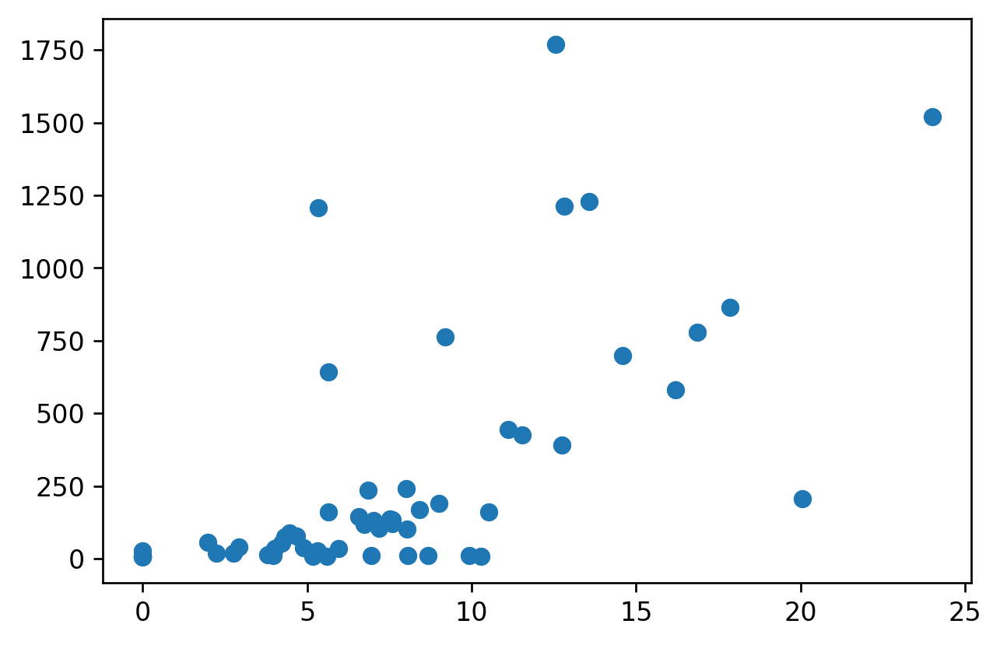

In [23]:
#print(average_size)



print("-----------SD-------------------------")

print(len(standard_deviations), len(average_sizes))
plt.scatter(standard_deviations, average_sizes)


#large average size, but huge SD indicates small scales are either being lumped together, while some small scales remain
#or that large scales are being broken apart into small scales: which is more likly?

#the ideal would be to get low SD: evenly spread out, rather than choose an arbitary value we can perhaps use machine learning
#to choose blocksize corresponding to the lowest value


#can block size be the ratio of the average size of the scale to the size of the entire image?

dimensions = []
for i in thr_images:
    dimensions.append(i.shape[0] * i.shape[1])
    
print(len(average_sizes), len(dimensions))
print(np.array(average_sizes)/np.array(dimensions))

55
[13.247185549746275, 13.0, 38.59394849705544, 31.0, 14.87952149019338, 15.0, 9.0, 35.05771201458113, 33.18403487060513, 17.0, 12.746441756514944, 24.80004552076293, 23.0, 21.0, 14.560798841985976, 29.0, 25.431268876596498, 15.0, 19.0, 21.0, 19.0, 20.61919199254177, 19.0, 25.0, 33.13024238183553, 25.0, 13.0, 23.0, 20.829649449359014, 15.0, 28.857166210694057, 11.0, 22.69888857400598, 26.744881502769154, 22.922268368246108, 11.0, 11.00199463333826, 21.195836836180682, 11.261284629393991, 13.0, 17.304951712625304, 9.0, 13.314683225302222, 27.0, 14.810963174780056, 29.09921106504406, 41.055670133584115, 19.0, 17.0, 55.0, 13.048289359947278, 19.0, 25.067618548595288, 38.847110024482255, 23.429520520703417]
bs 13.0
it 1.0


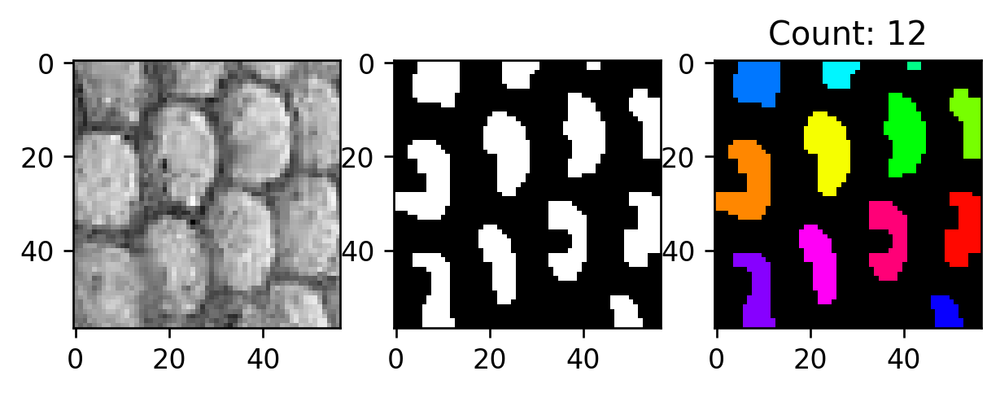

bs 13.0
it 1.0


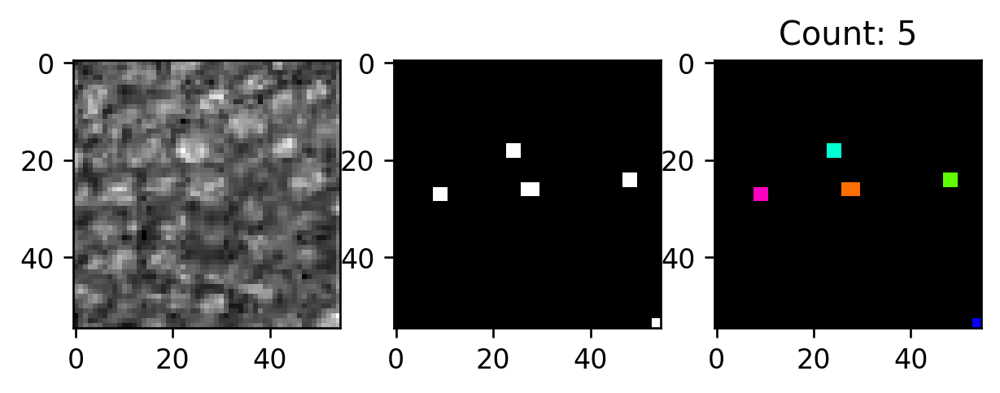

bs 39.0
it 2.0


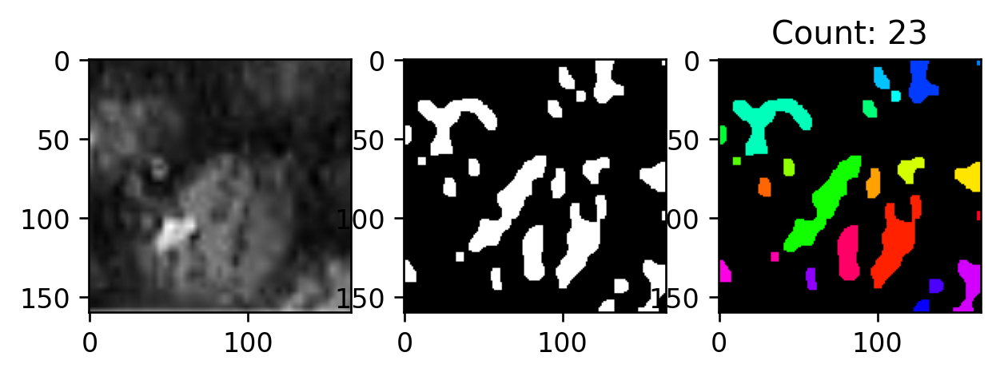

bs 31.0
it 2.0


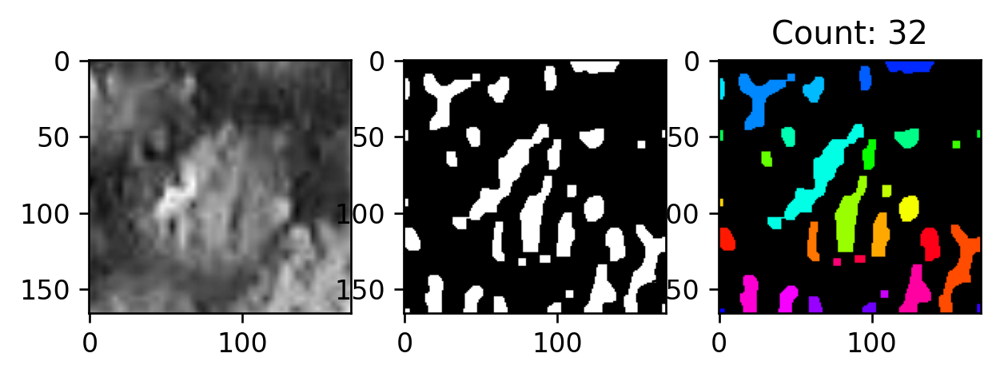

bs 15.0
it 1.0


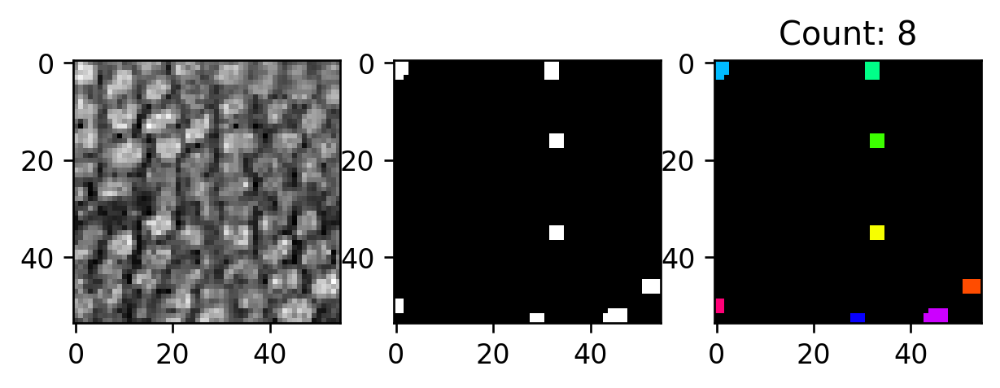

bs 15.0
it 1.0


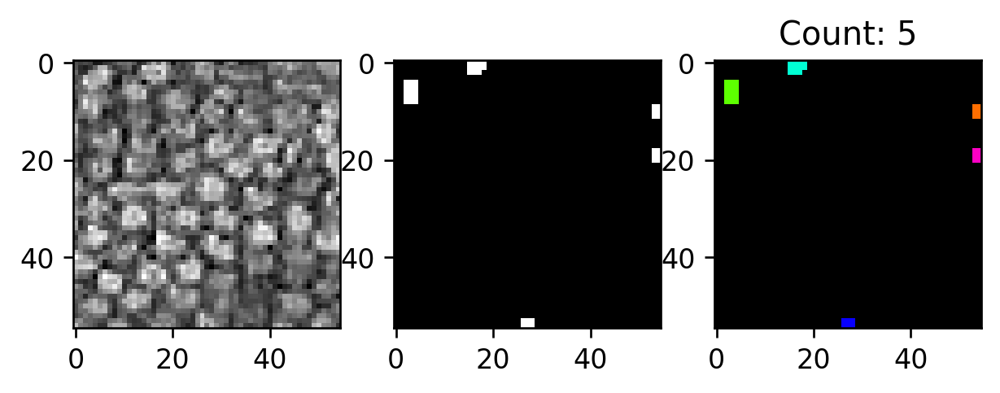

bs 9.0
it 0.0


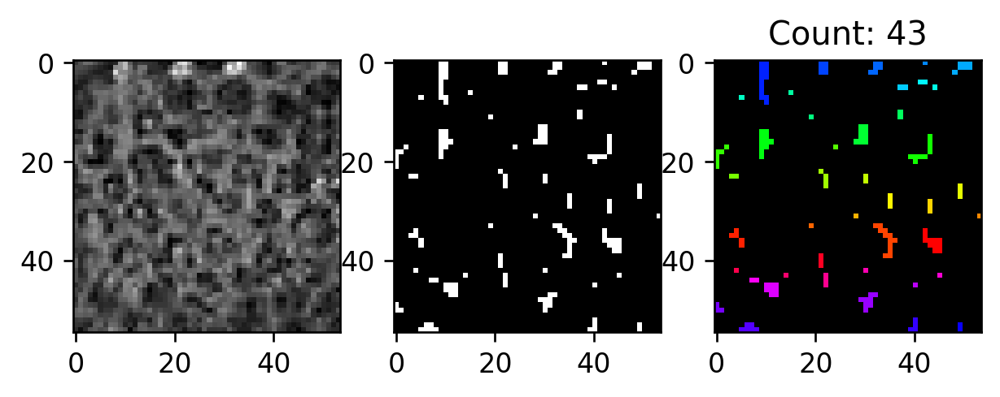

bs 35.0
it 2.0


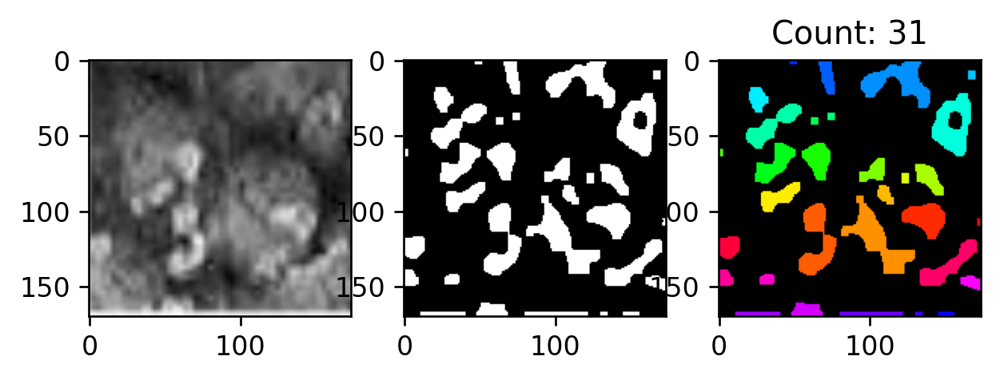

bs 33.0
it 2.0


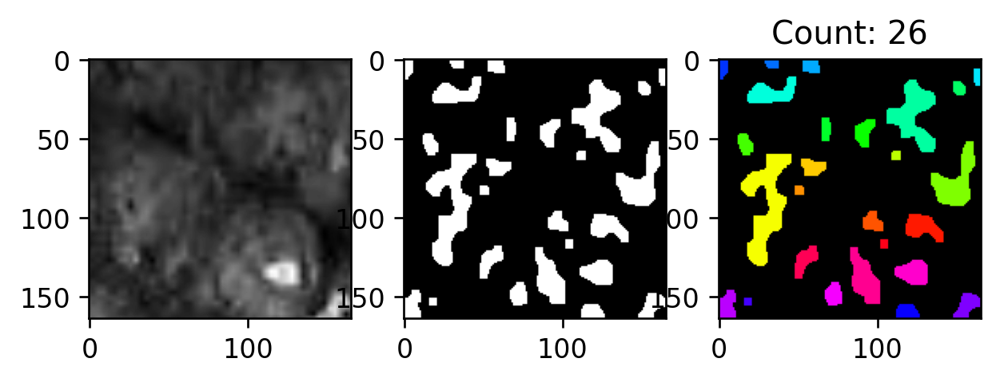

bs 17.0
it 1.0


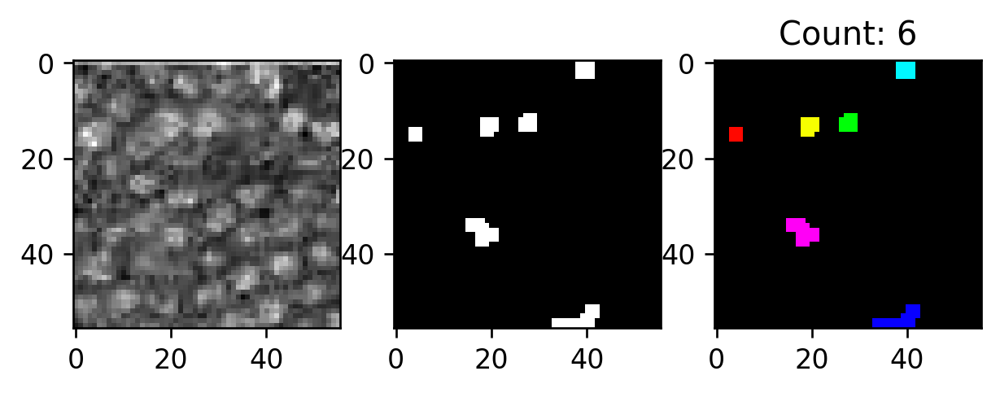

bs 13.0
it 1.0


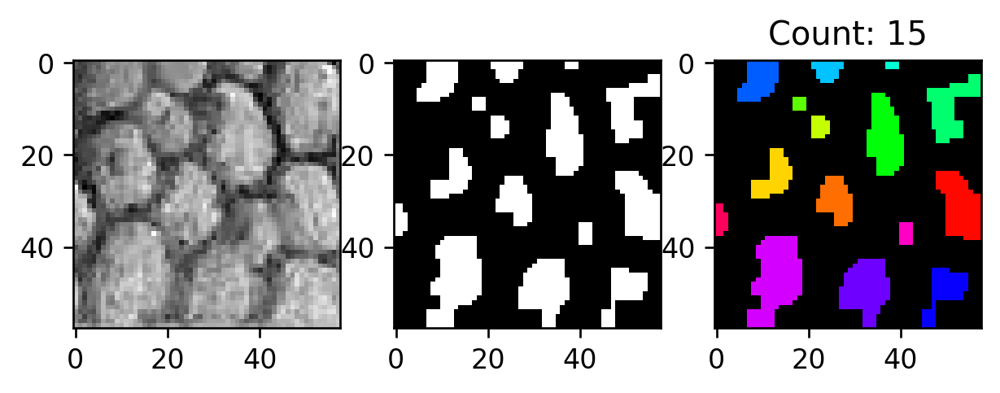

bs 25.0
it 1.0


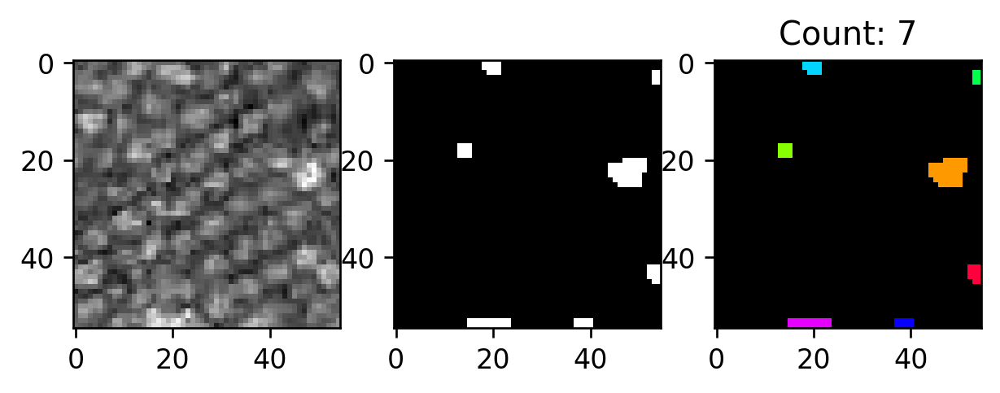

bs 23.0
it 1.0


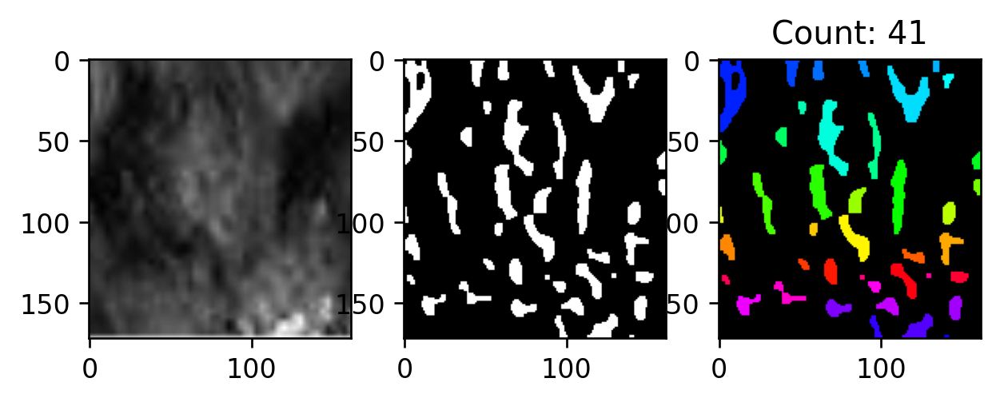

bs 21.0
it 1.0


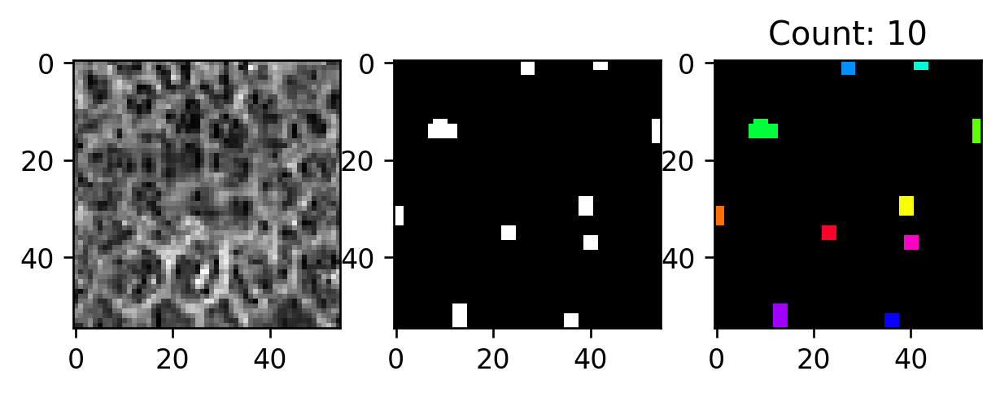

bs 15.0
it 1.0


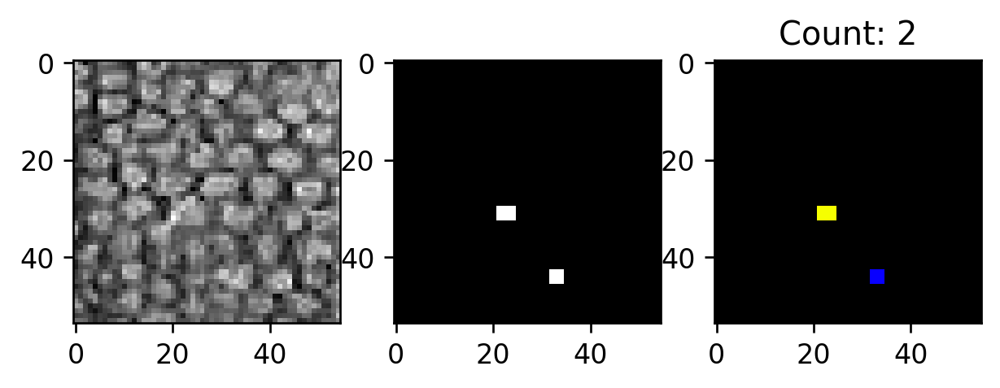

bs 29.0
it 1.0


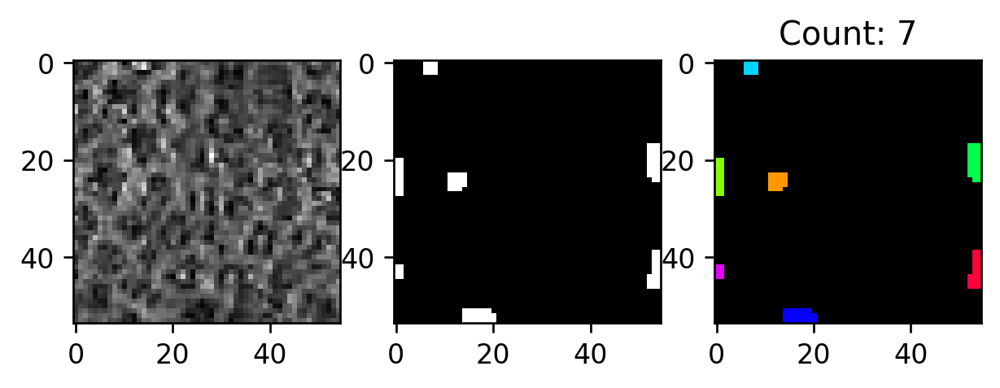

bs 25.0
it 1.0


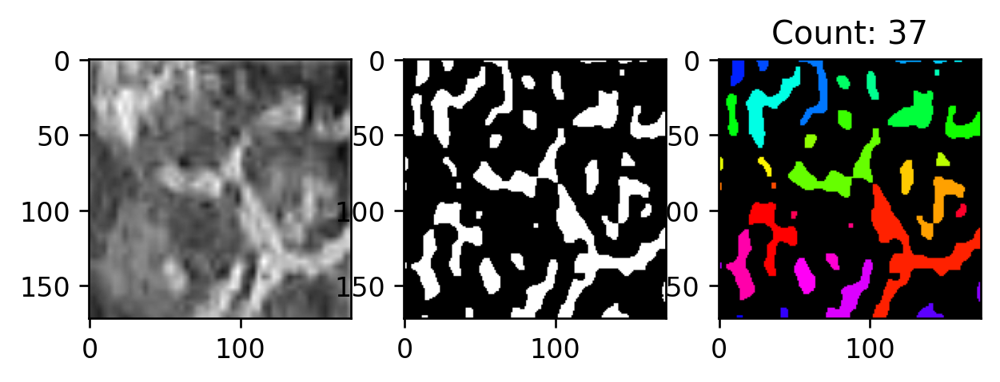

bs 15.0
it 1.0


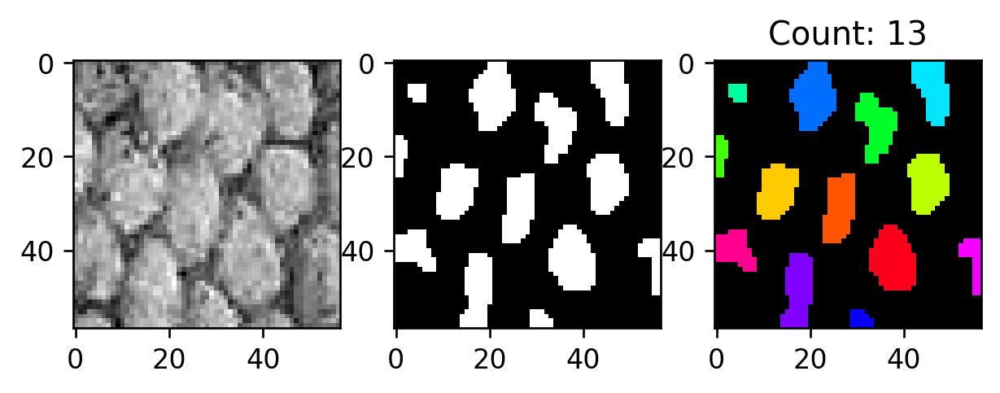

bs 19.0
it 1.0


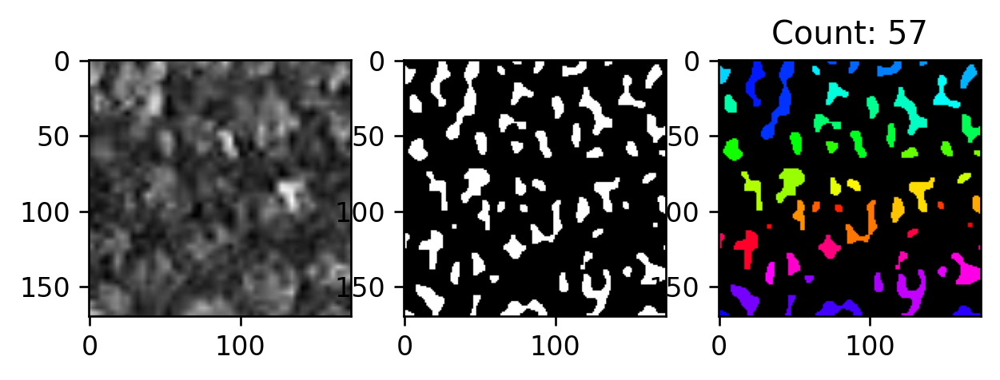

bs 21.0
it 1.0


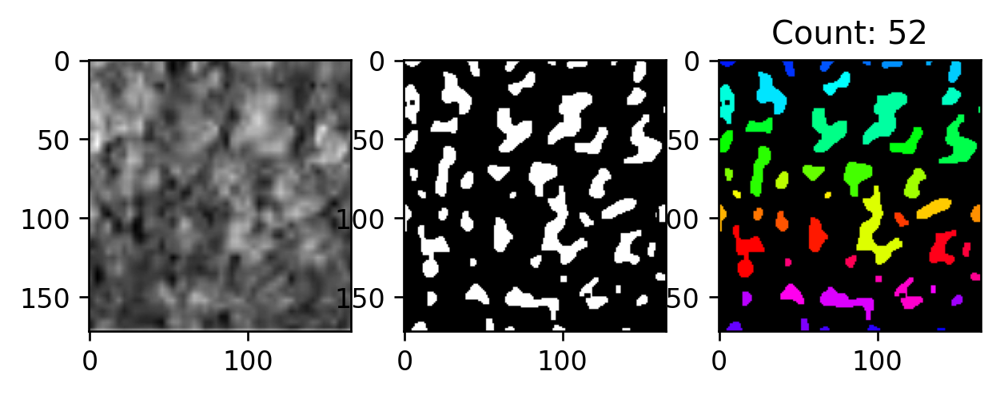

bs 19.0
it 1.0


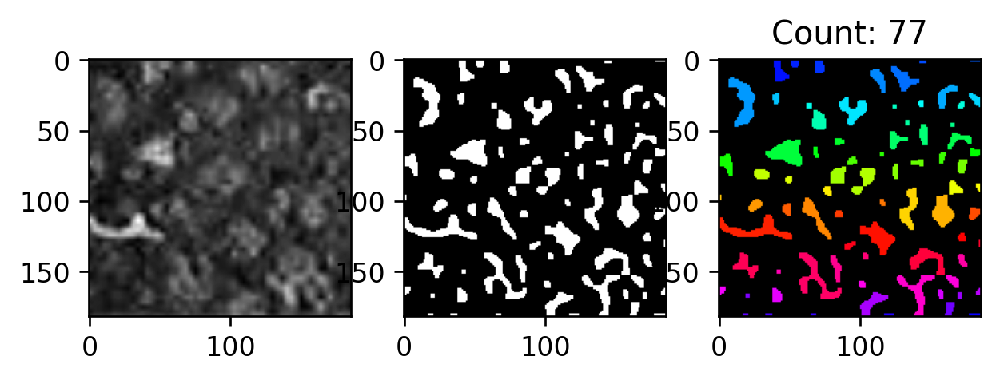

bs 21.0
it 1.0


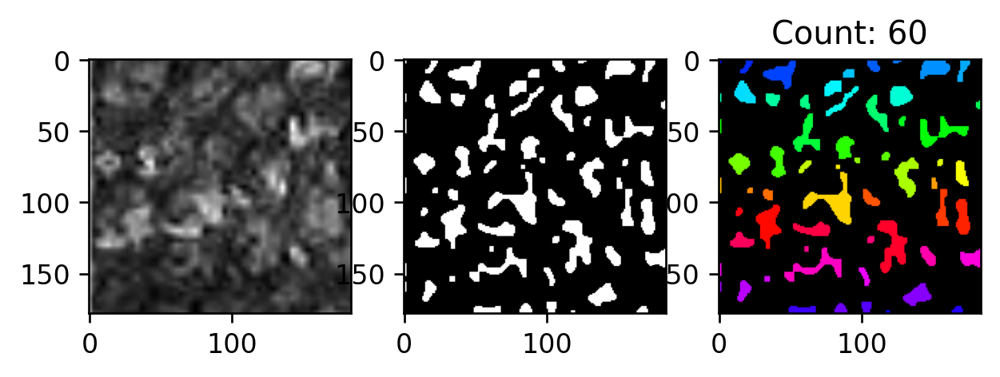

bs 19.0
it 1.0


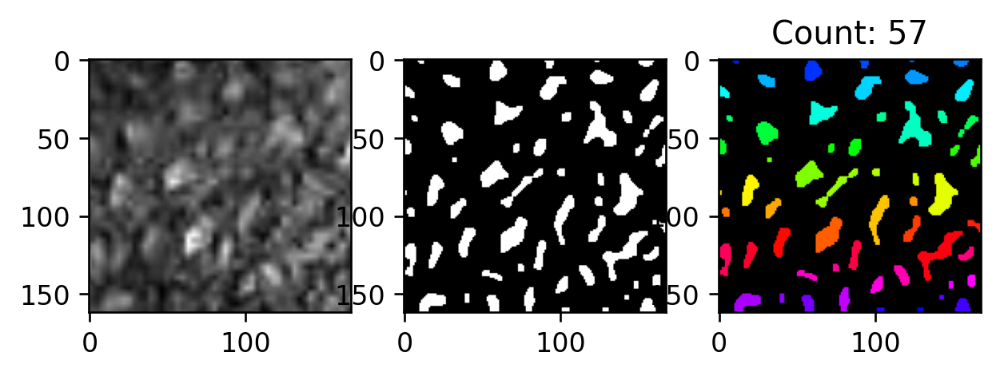

bs 25.0
it 1.0


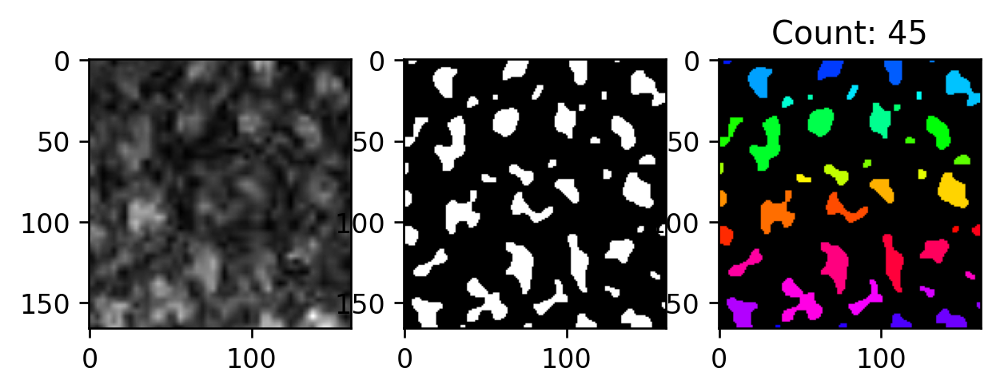

bs 33.0
it 2.0


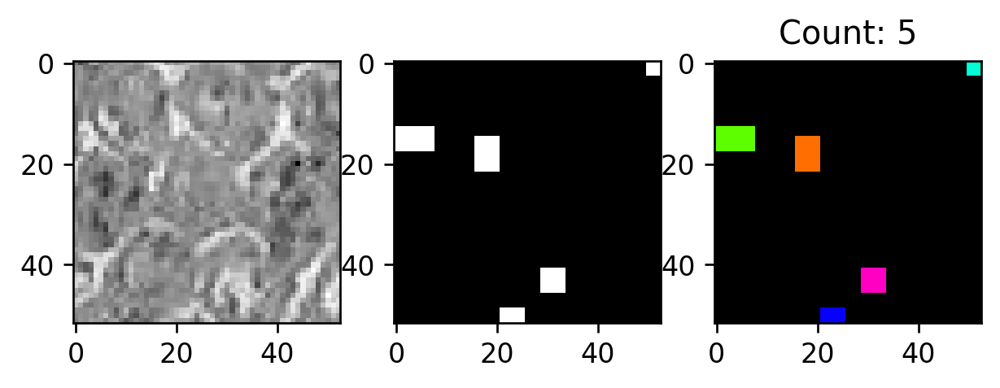

bs 25.0
it 1.0


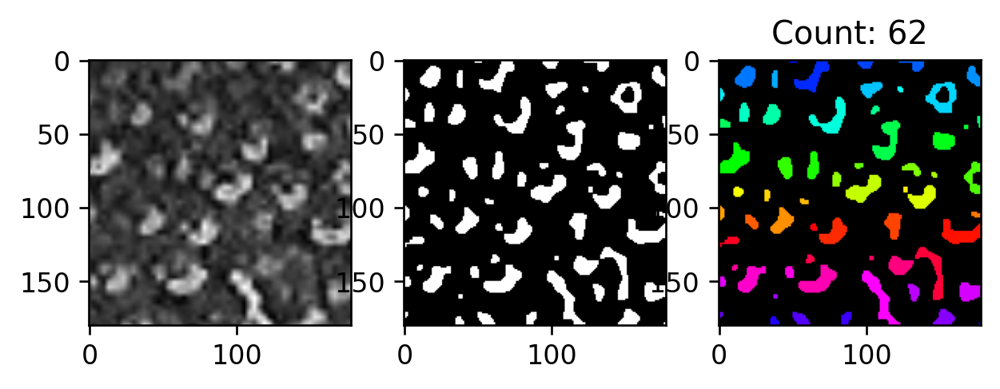

bs 13.0
it 1.0


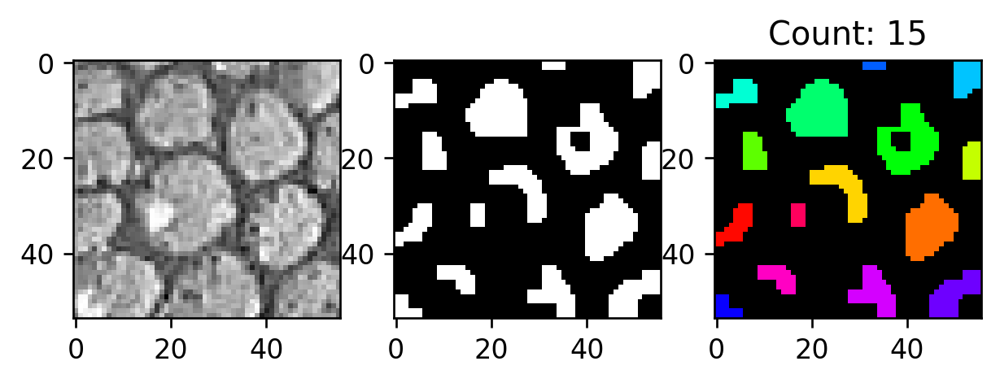

bs 23.0
it 1.0


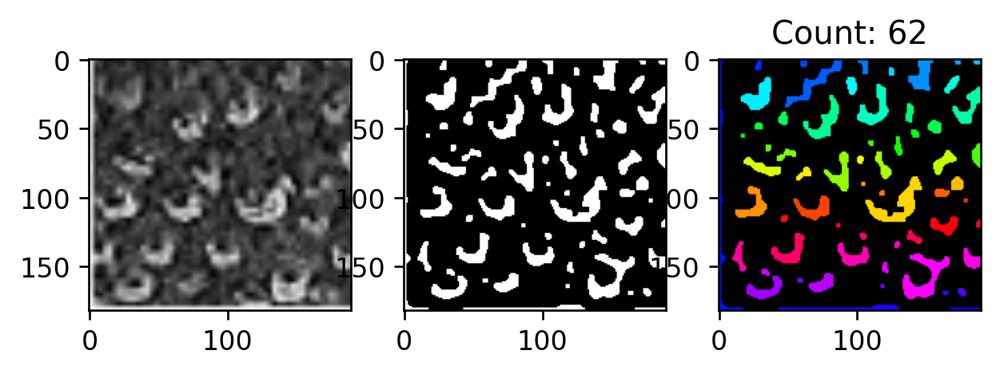

bs 21.0
it 1.0


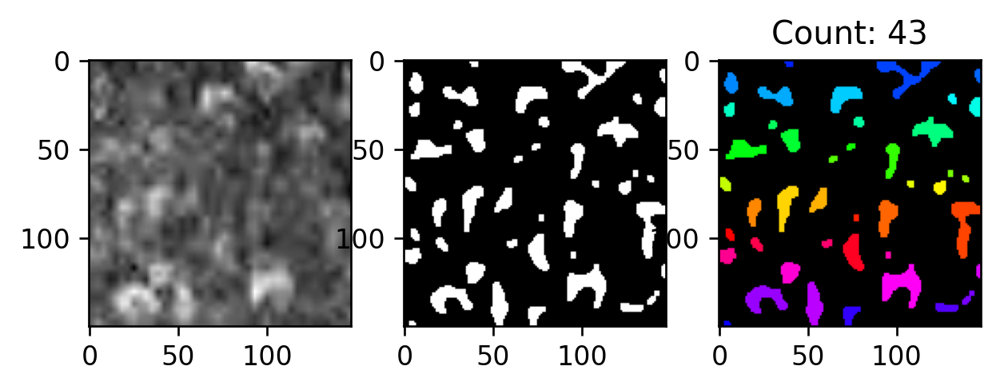

bs 15.0
it 1.0


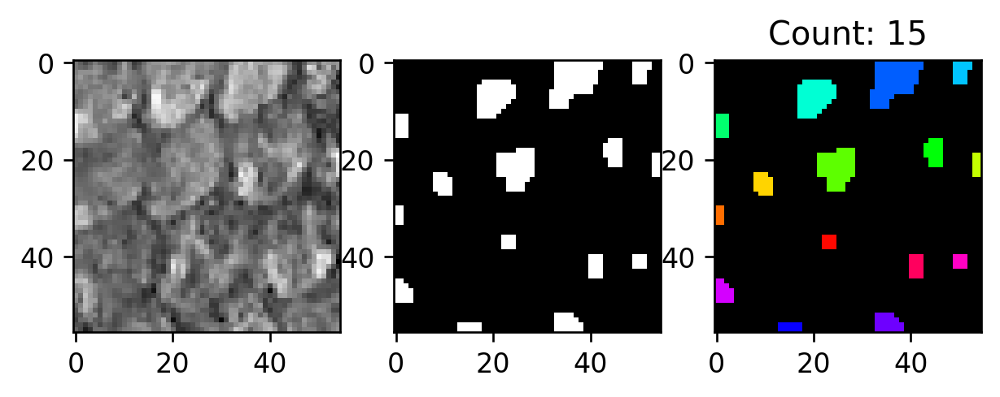

bs 29.0
it 1.0


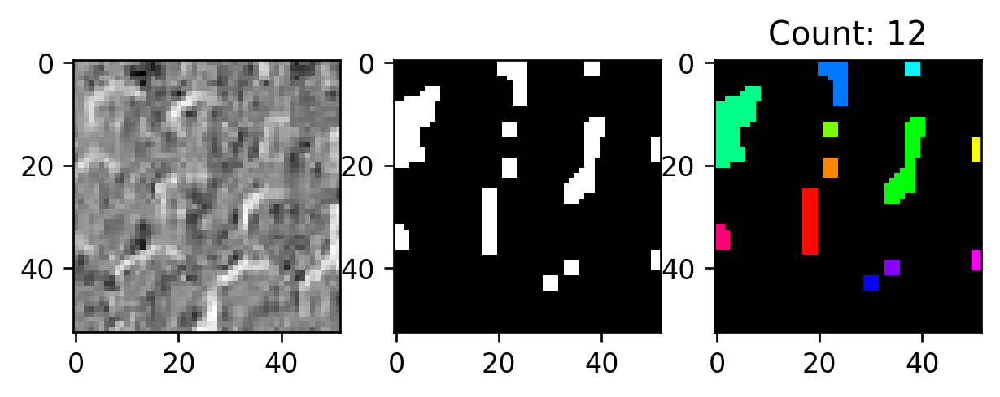

bs 11.0
it 1.0


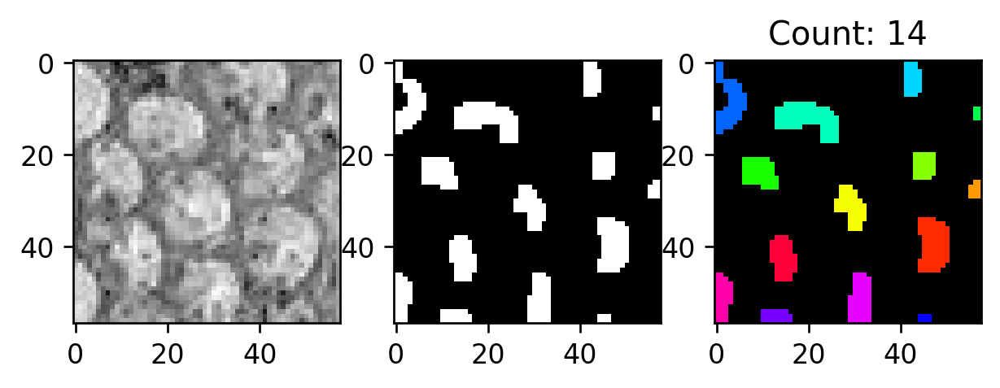

bs 23.0
it 1.0


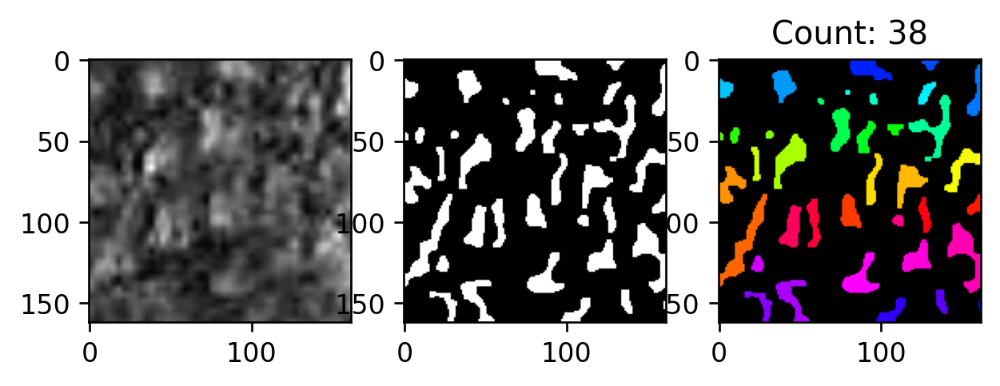

bs 27.0
it 1.0


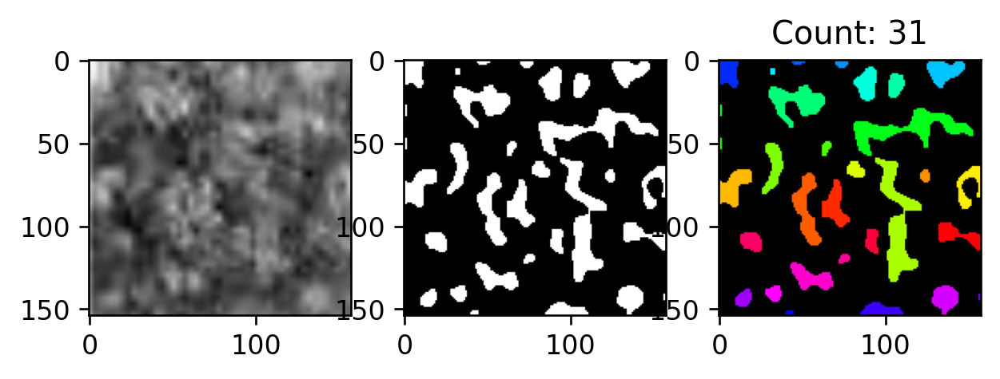

bs 23.0
it 1.0


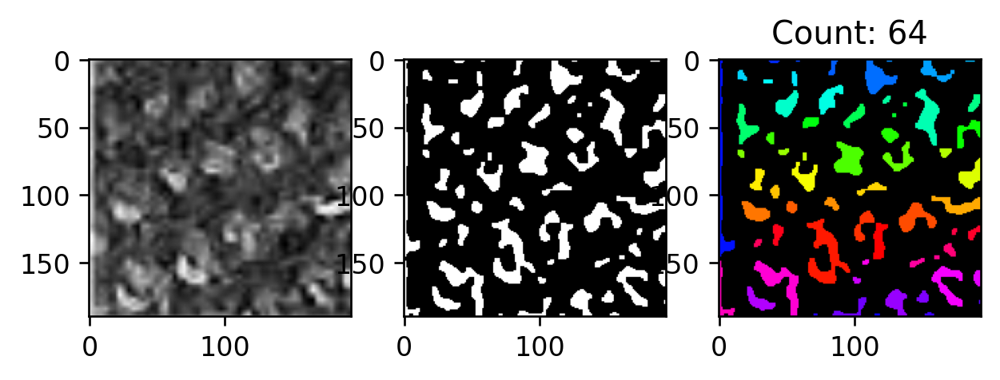

bs 11.0
it 1.0


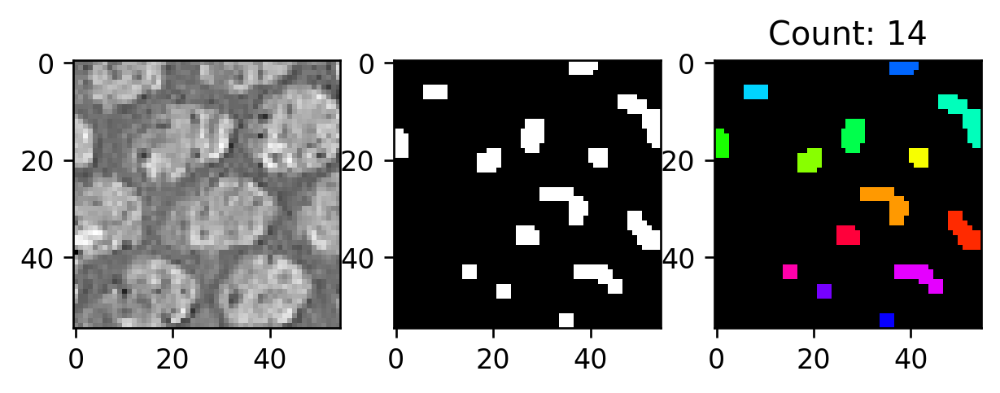

bs 11.0
it 1.0


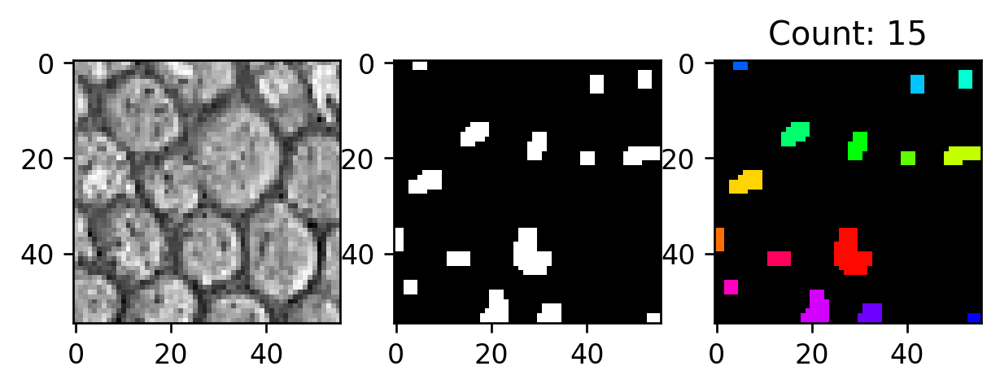

bs 21.0
it 1.0


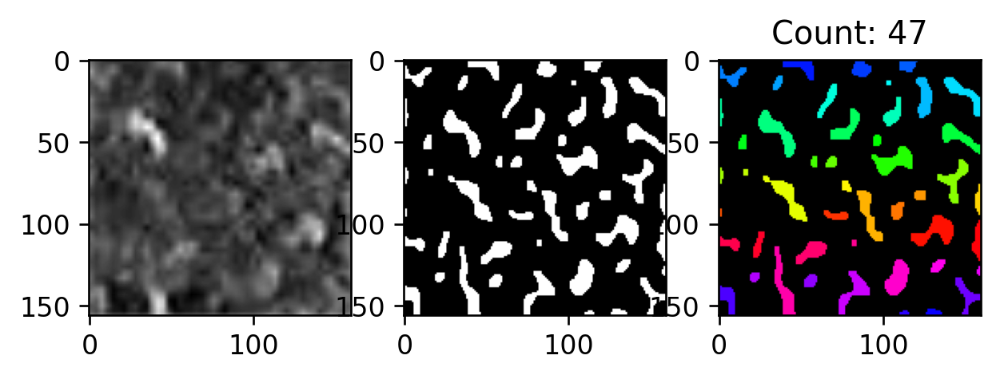

bs 11.0
it 1.0


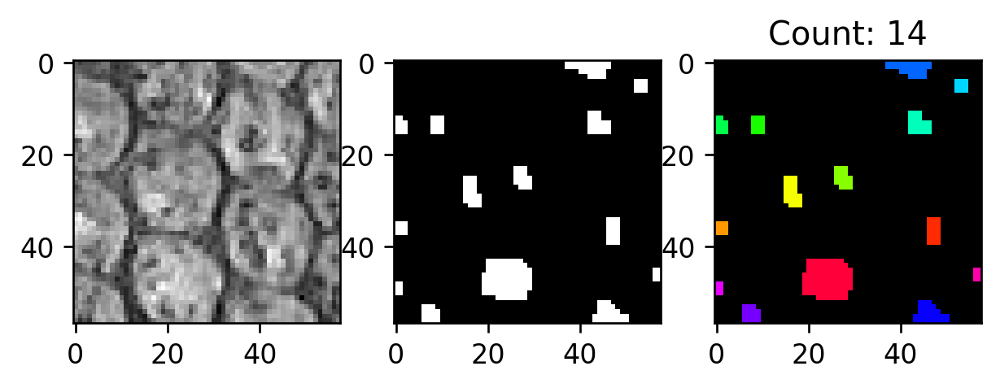

bs 13.0
it 1.0


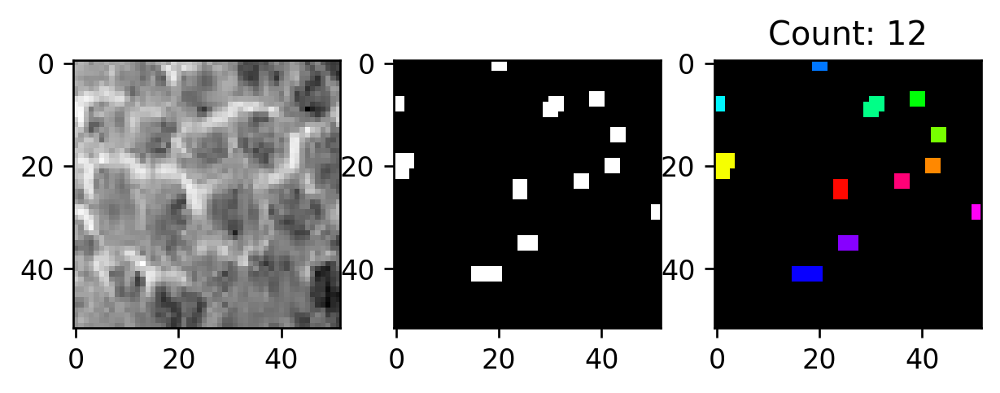

bs 17.0
it 1.0


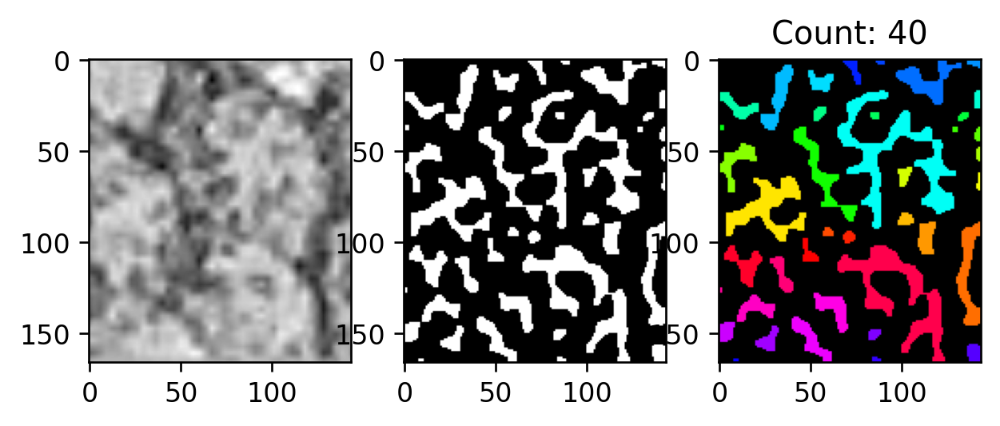

bs 9.0
it 0.0


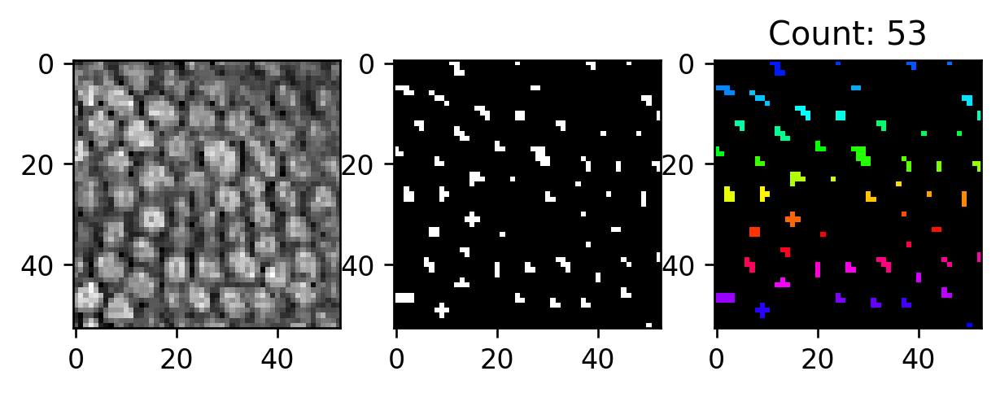

bs 13.0
it 1.0


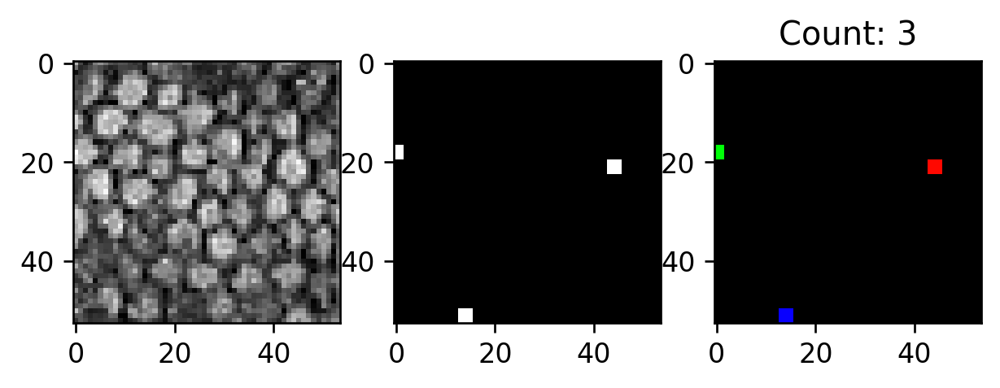

bs 27.0
it 1.0


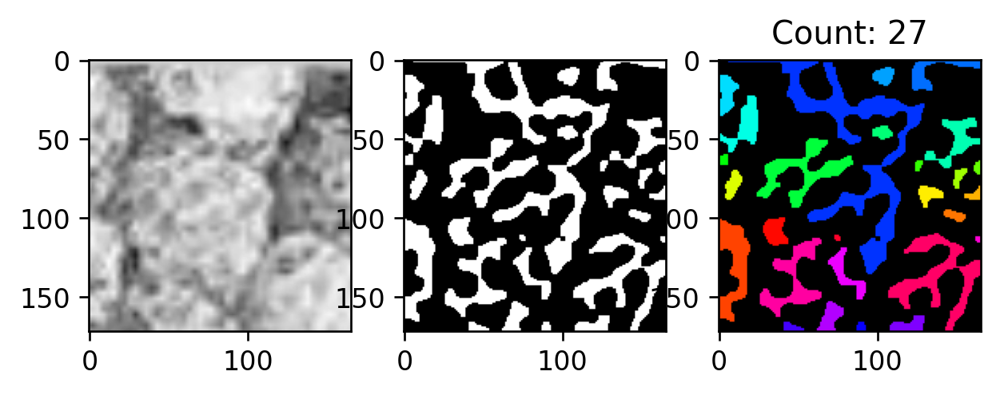

bs 15.0
it 1.0


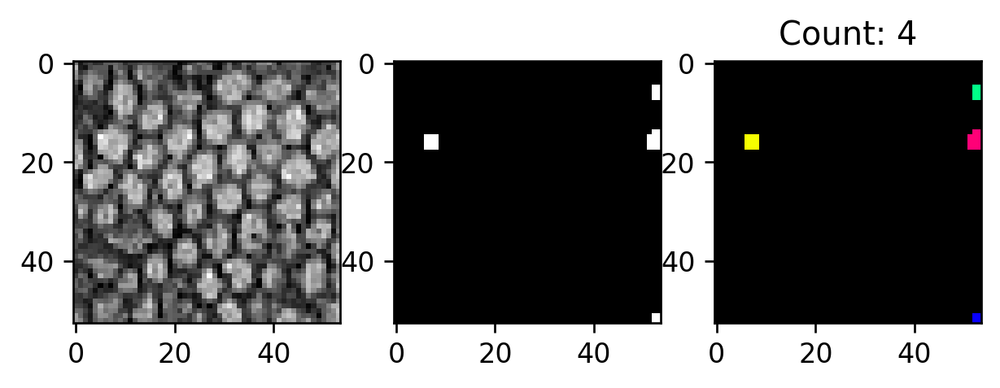

bs 29.0
it 1.0


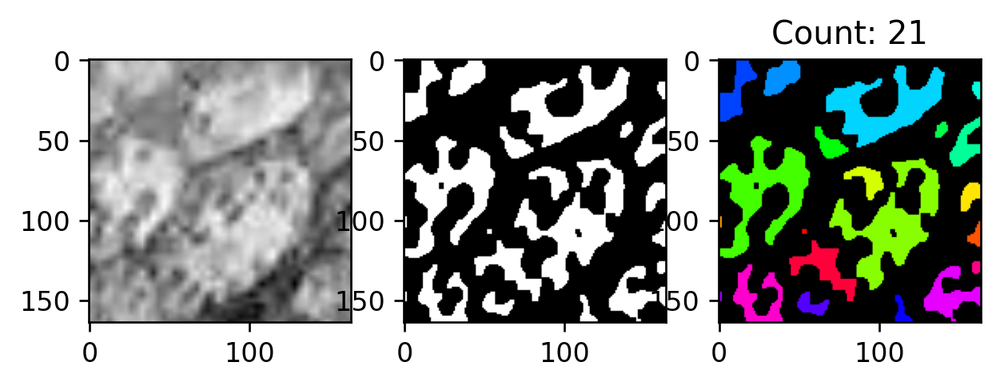

bs 41.0
it 2.0


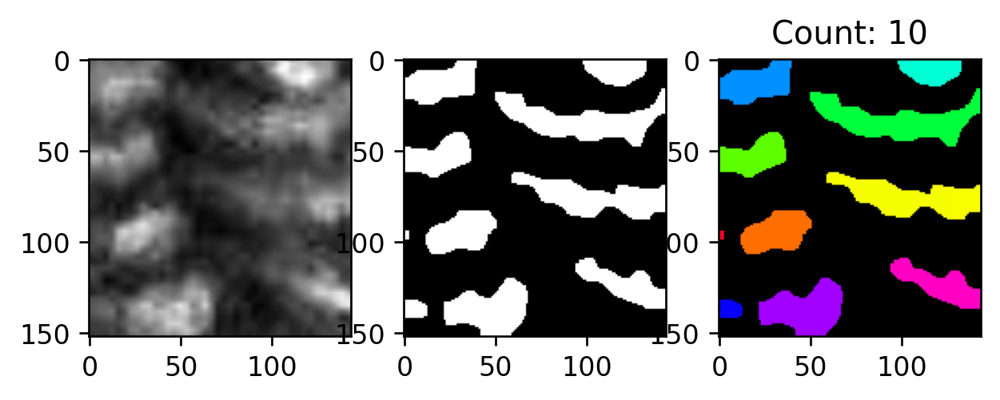

bs 19.0
it 1.0


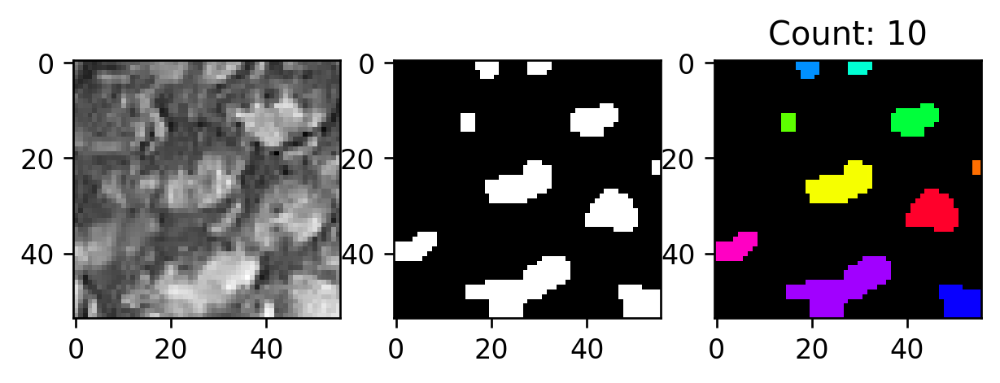

bs 17.0
it 1.0


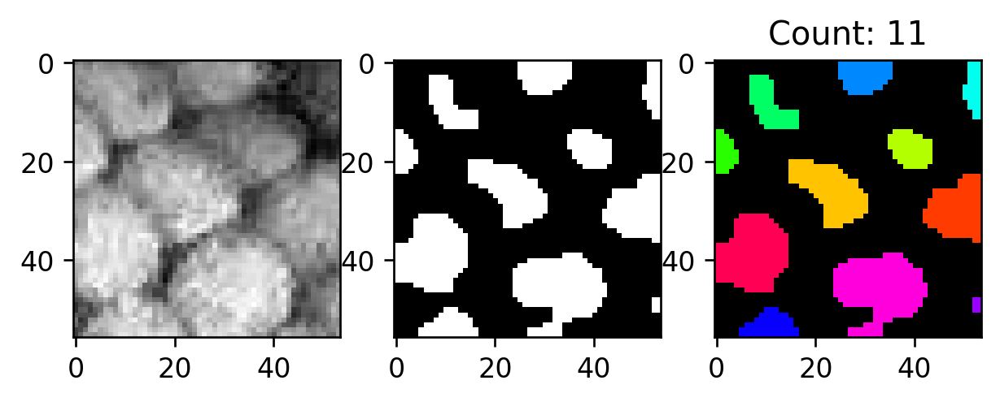

bs 55.0
it 3.0


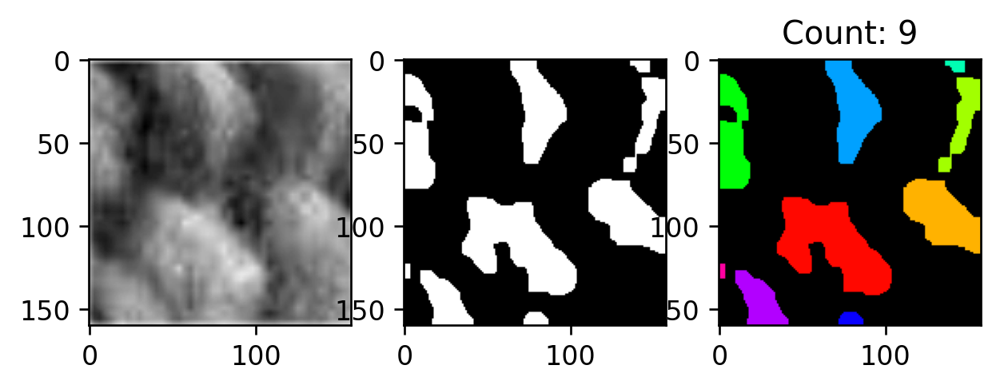

bs 13.0
it 1.0


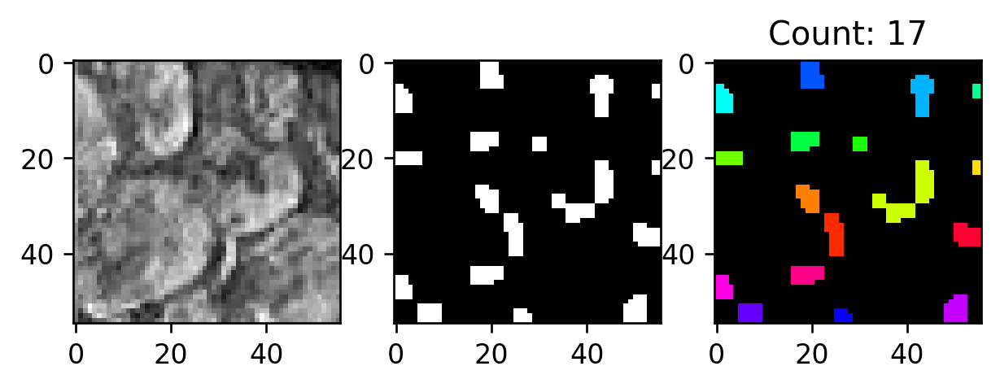

bs 19.0
it 1.0


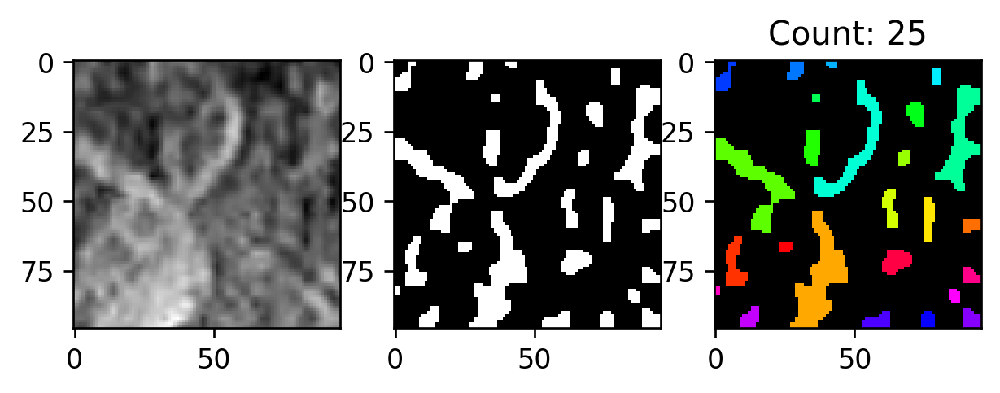

bs 25.0
it 1.0


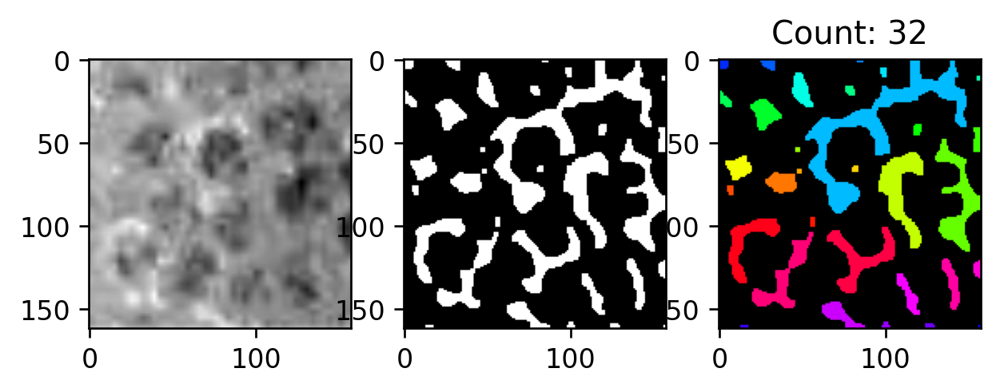

bs 39.0
it 2.0


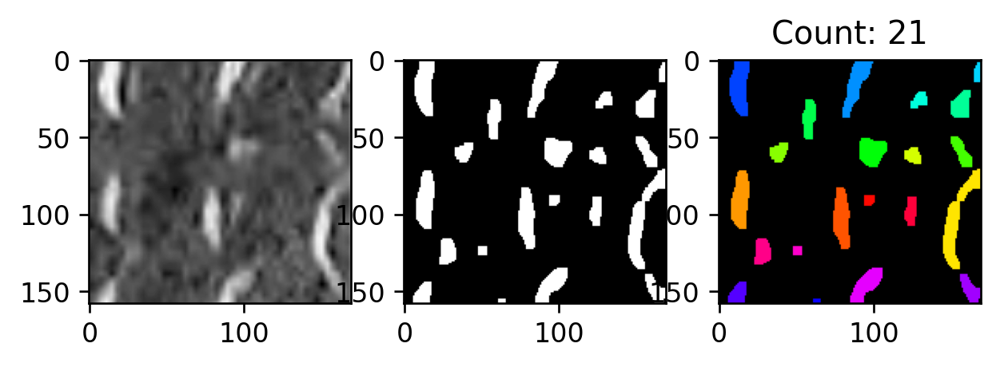

bs 23.0
it 1.0


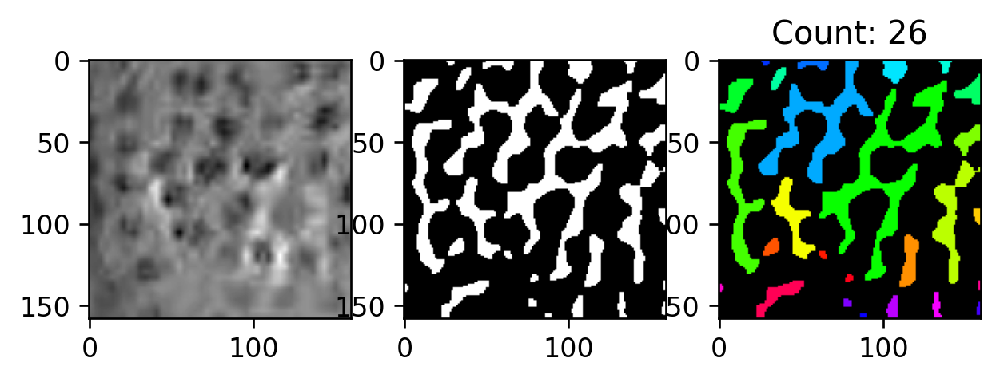

In [29]:
#to do this plotting method, should determine which factors are important: features will be the dimentionality of the array


#uniformity seems important, average size important

print(len(inverted_standard_deviations))
#maybe chooses either uniforminty ort the other
dirname = 'Anolis_cristatellus_images/'
directory = os.scandir(dirname)

block_size =  average_shortest_distance_squared
print(block_size)
thr = []

index = 0
customized = [2,3]
for img in directory:
    img_name = img.name
    if (img_name != '.ipynb_checkpoints'):
        if(len(customized) > 0):
            image_names.append(img.name)
            
            #read the image, convert to grayscale add to array and title + blur
            
           
            img = cv2.imread(dirname + "" + img_name)
            if inverted_standard_deviations[index] + inverted_size_stds[index] < standard_deviations[index] + size_stds[index]:
                print("inverted")
                img = invert(img)
                
            original_img1.append(img)
            
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            original_img.append(gray)
            title = img_name
            
            
            img = gray

            blur = cv2.GaussianBlur(img,(5,5),0)
            blur = cv2.bilateralFilter(blur,10,10,100)
            
            filter_img.append(blur)
     
                
            #if customed block size has been determined
            
            if np.round(block_size[index]) % 2 != 1:
                block_size[index] = np.round(block_size[index]) + 1
            
            print("bs", np.round(block_size[index]))
            print("it", np.round(block_size[index]/20))
       
            thresh = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, np.round(block_size[index]).astype(int), -2)
                
            kernel = np.ones((3,3),np.uint8)

            #if customized array is greater than size 0 iteration number has been determined
            opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations=np.round(block_size[index]/20 + 1).astype(int))

            
            # sure background area
            sure_bg = cv2.dilate(opening,kernel,iterations=1)

            # Finding sure foreground area: What does cv2.DIST do?
            dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
            ret, sure_fg = cv2.threshold(dist_transform, 1.5, 255, 0) 

            # Finding unknown region
            sure_fg = np.uint8(sure_fg)
            unknown = cv2.subtract(sure_bg,sure_fg)
            
            #adding sure_fg binarization to list of images
            images.append(sure_fg)

            plt.subplot(1,3,1), plt.imshow(gray, 'gray')
            plt.subplot(1,3,2), plt.imshow(sure_fg, 'gray')
            
            
            # Label and count (taken from maggie's code)
            # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
            count, labels = cv2.connectedComponents(sure_fg)                
            count = count - 1 # background doesn't count as a scale
            label_hue = np.uint8(179 * labels / np.max(labels))
            blank_ch = 255 * np.ones_like(label_hue)
            labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
            labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
            labeled_img[label_hue == 0] = 0
            
            if(len(customized) != 0):
                labeled_imgs.append(labeled_img)

            plt.subplot(1, 3, 3), plt.imshow(labeled_img, 'gray')
            plt.title('Count: ' + str(count))
            plt.show()
            index += 1
            thr.append(sure_fg)
            
            
    

In [25]:
#https://stackoverflow.com/questions/13391073/adaptive-threshold-of-blurry-image

In [26]:
#maybe blocksize should be calculated from the average area around the specific point: the surrounding block
#the smallest? distance
average_size = []
scale_num_per_img = []
sizes_of_scales = []
total_stats = []
averages = []

print(len(images))
#iterates through images to determine average size and count of scales in␣initial binarization
for i in np.arange(len(thr)):    
    img = thr[i]
    #plt.imshow(img)
    #plt.show()
    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S)
    num_labels = output[0]
    # The second cell is the label matrix
    labels = output[1]
    # The third cell is the stat matrix
    stats = output[2]
    # The fourth cell is the centroid matrix
    centroids = output[3]
    #print("Sizes of all scales:", stats[1:,-1])
    #print("Number of scales detected (including noise)", num_labels - 1)
    #print("Average size of scales: ", np.average(stats[1:,-1]))
    #print("\n")
    sizes_of_scales.append((stats[1:,-1]))
    average_size.append(([num_labels, np.average(stats[1:,-1])]))
    averages.append(np.average(stats[1:,-1]))
    total_stats.append([num_labels,stats[1:,-1], stats[1:,-1]])

165


In [27]:
def overlay(bw_img, color_mask, w1=0.2, w2=0.95):
    a = cv2.cvtColor(bw_img, cv2.COLOR_GRAY2RGB)
    a -= np.min(a)
    a = a/np.max(a)*255
    a = np.clip(a, a_min=0, a_max=255).astype(int)
    #a = np.array([[i.tolist()+[0] if np.max(i)==0 else i.tolist()+[255] for i␣,in j] for j in a])
    b = np.clip(color_mask, a_min=0, a_max=255).astype(int)
    #b = np.array([[i.tolist()+[255] for i in j] for j in b])
    c = cv2.addWeighted(b,w1,a,w2,0)
    return c

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TRYING TO CLEAN UP THE IMAGES AND REMOVE SMALL SPECKELS: SHOULD TAKE INTO ACCOUNT DISTANCE AND SIZE
Images 165
2
scales: 12
n,a [13, 82.0]
82.0


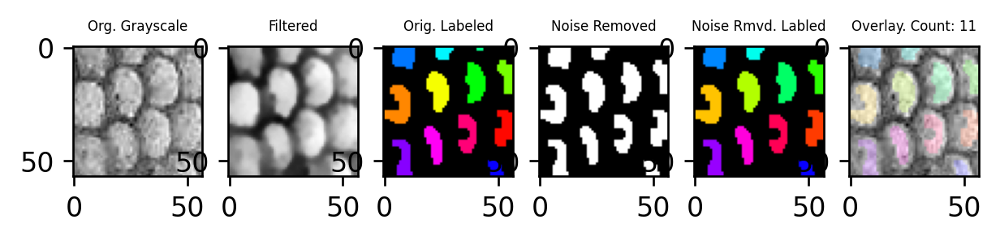

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 5
n,a [6, 8.6]
8.6


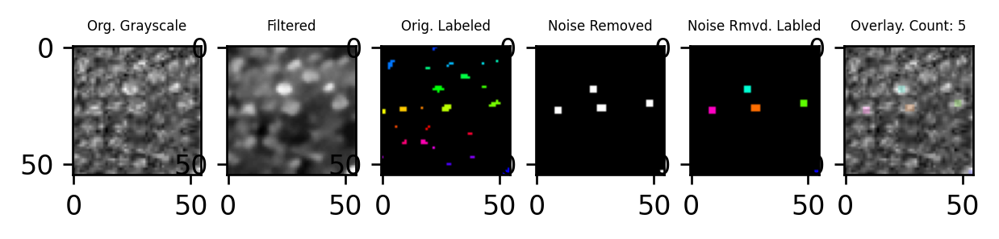

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 23
n,a [24, 216.95652173913044]
216.95652173913044


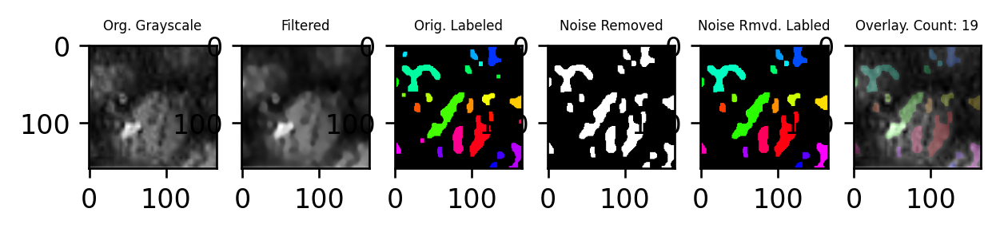

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 32
n,a [33, 176.9375]
176.9375


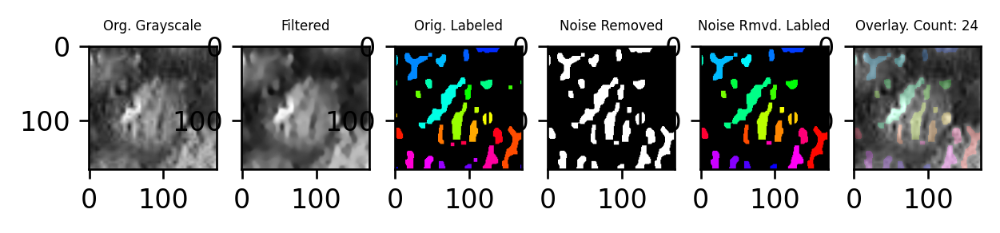

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 8
n,a [9, 9.875]
9.875


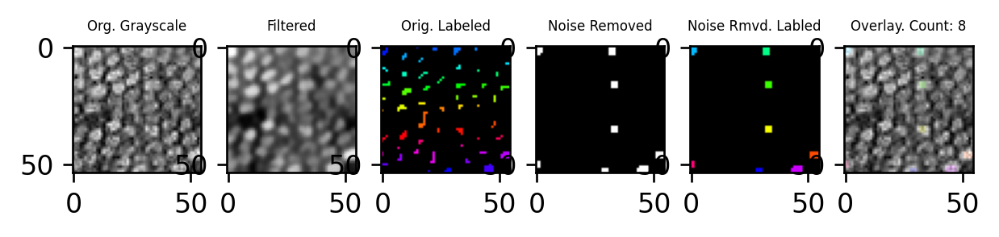

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 5
n,a [6, 8.8]
8.8


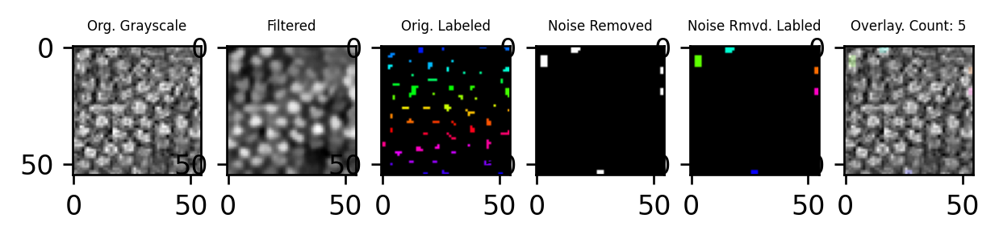

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 43
n,a [44, 4.0]
4.0


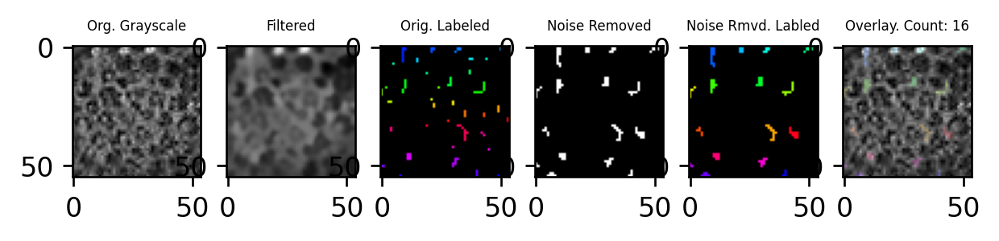

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 31
n,a [32, 221.48387096774192]
221.48387096774192


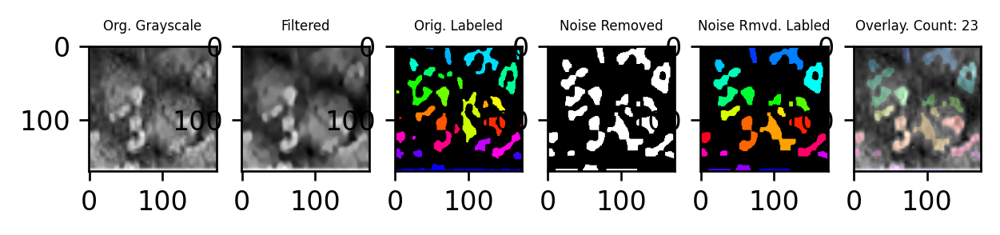

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 26
n,a [27, 207.15384615384616]
207.15384615384616


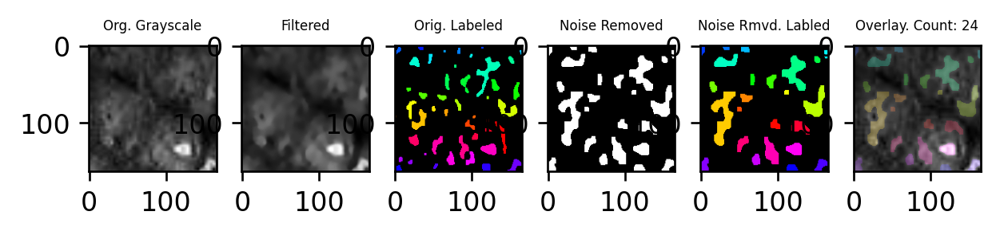

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 6
n,a [7, 18.666666666666668]
18.666666666666668


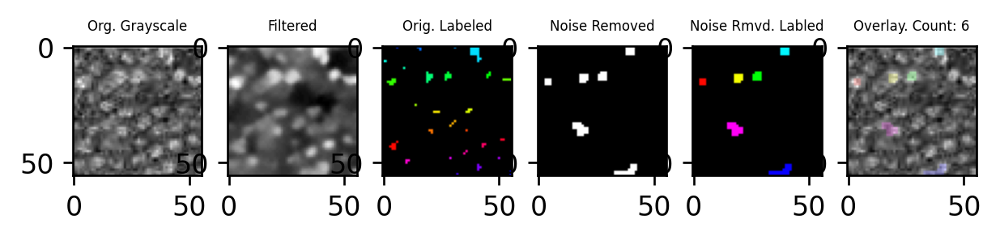

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 15
n,a [16, 61.53333333333333]
61.53333333333333


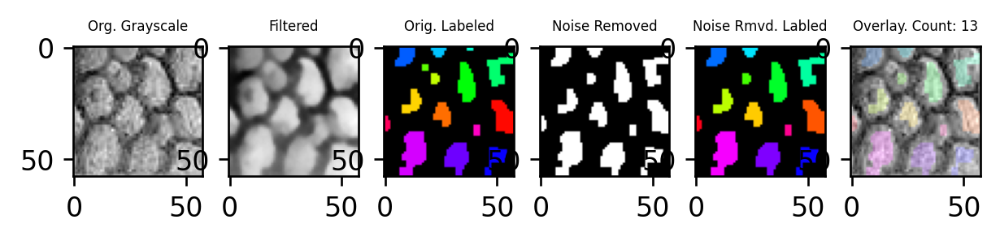

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 7
n,a [8, 14.571428571428571]
14.571428571428571


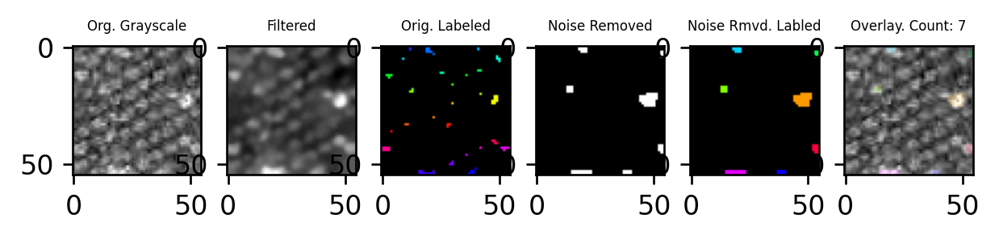

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 41
n,a [42, 113.95121951219512]
113.95121951219512


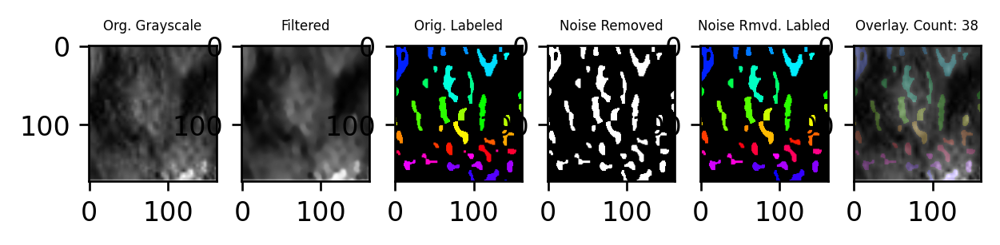

2
scales: 10
n,a [11, 10.8]
10.8


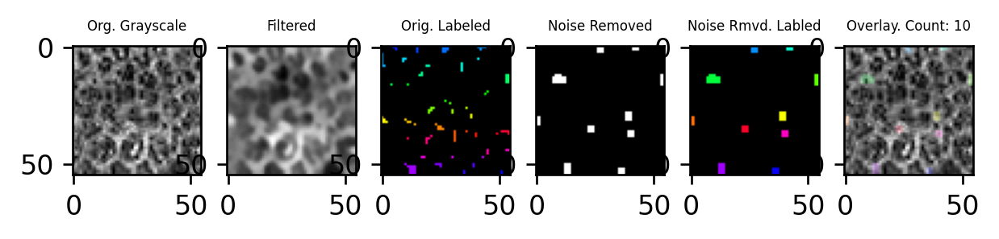

2
scales: 2
n,a [3, 10.5]
10.5


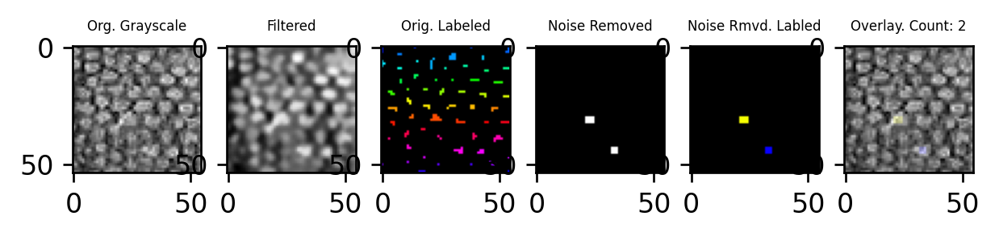

2
scales: 7
n,a [8, 15.428571428571429]
15.428571428571429


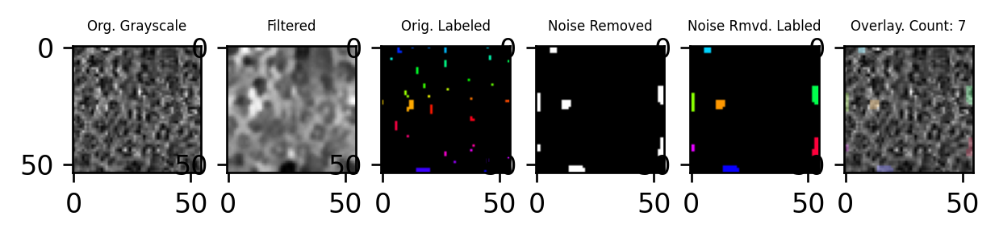

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 37
n,a [38, 196.9189189189189]
196.9189189189189


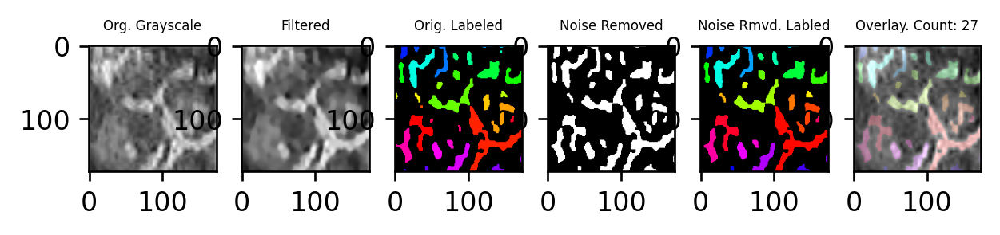

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 13
n,a [14, 66.76923076923077]
66.76923076923077


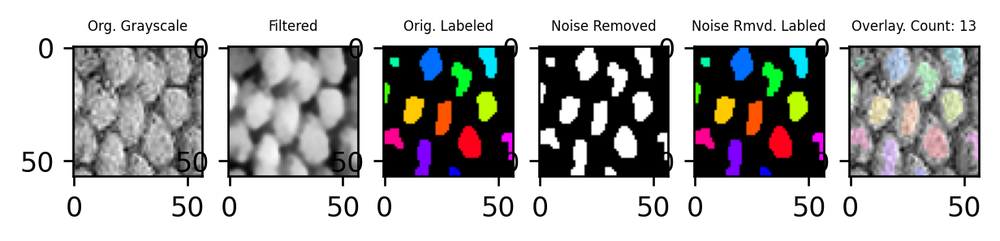

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 57
n,a [58, 96.29824561403508]
96.29824561403508


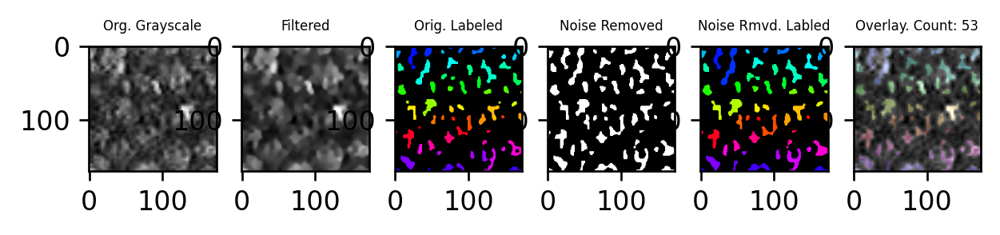

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 52
n,a [53, 115.03846153846153]
115.03846153846153


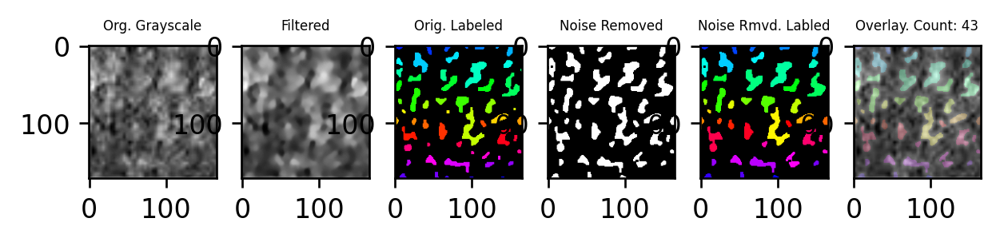

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 77
n,a [78, 76.88311688311688]
76.88311688311688


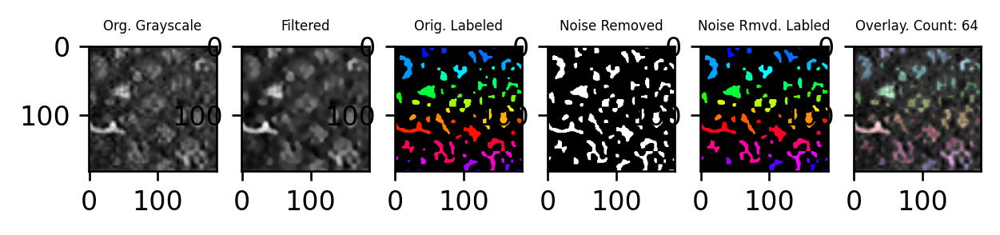

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 60
n,a [61, 103.15]
103.15


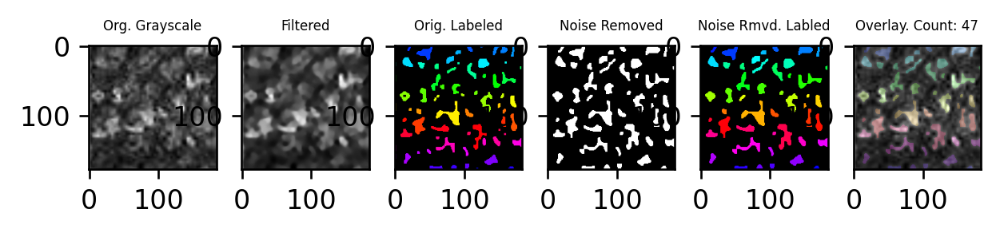

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 57
n,a [58, 78.85964912280701]
78.85964912280701


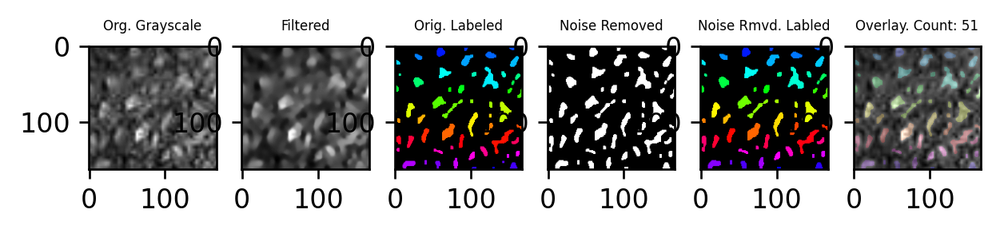

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 45
n,a [46, 115.37777777777778]
115.37777777777778


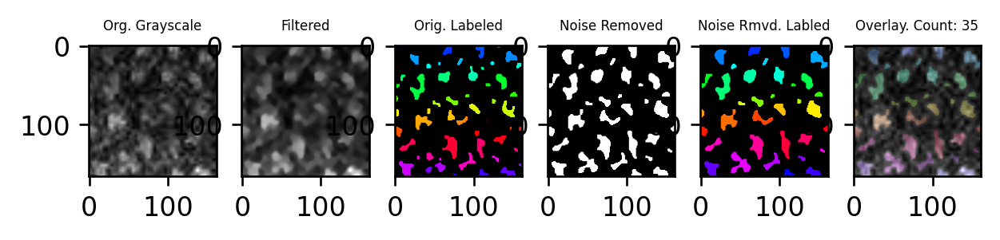

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 5
n,a [6, 24.8]
24.8


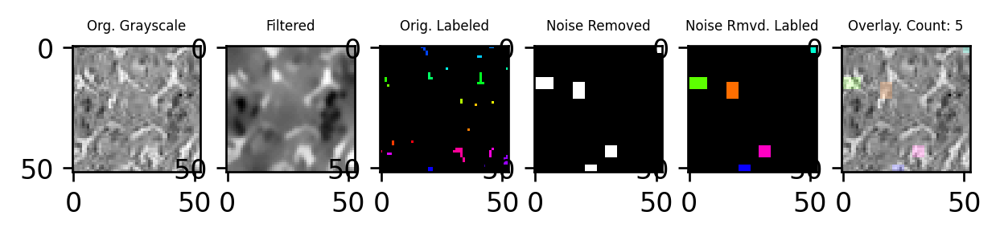

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 62
n,a [63, 96.20967741935483]
96.20967741935483


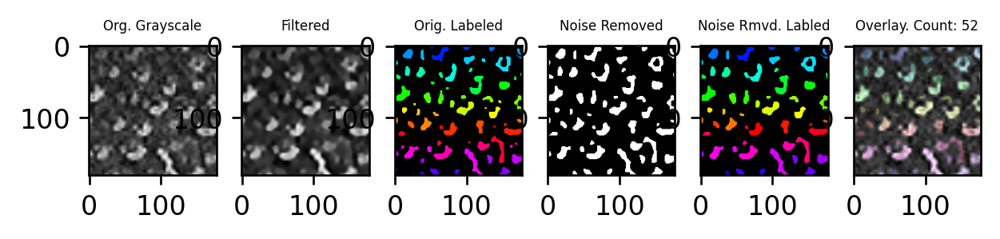

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 15
n,a [16, 53.86666666666667]
53.86666666666667


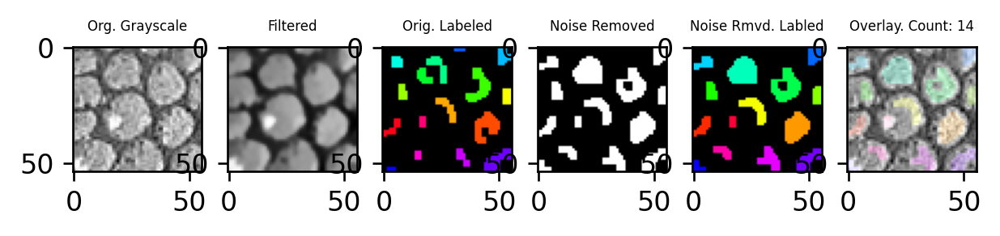

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 62
n,a [63, 112.19354838709677]
112.19354838709677


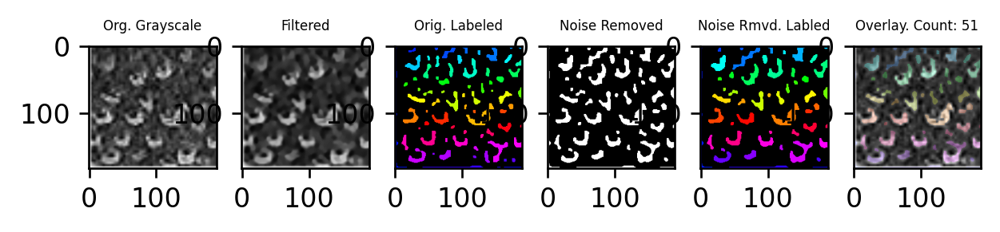

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 43
n,a [44, 83.72093023255815]
83.72093023255815


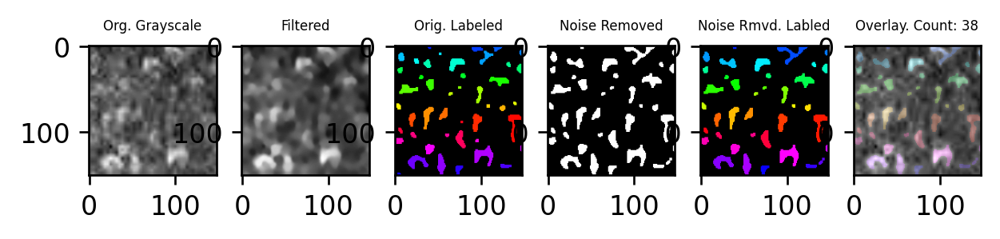

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 15
n,a [16, 23.733333333333334]
23.733333333333334


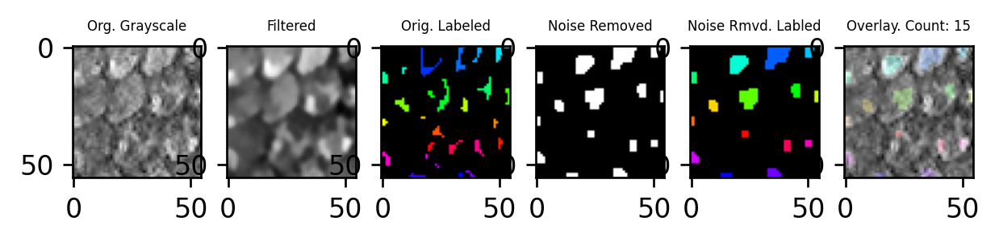

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 12
n,a [13, 26.0]
26.0


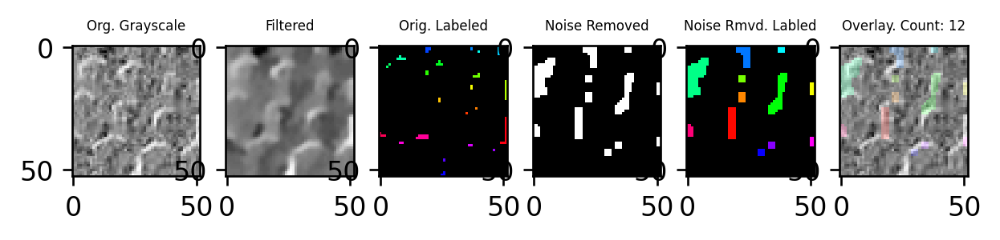

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 14
n,a [15, 38.714285714285715]
38.714285714285715


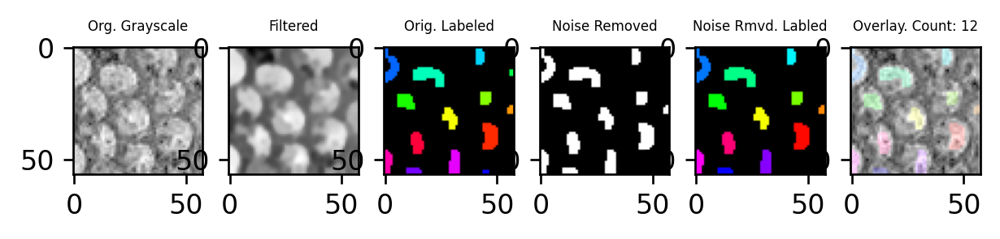

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 38
n,a [39, 143.3421052631579]
143.3421052631579


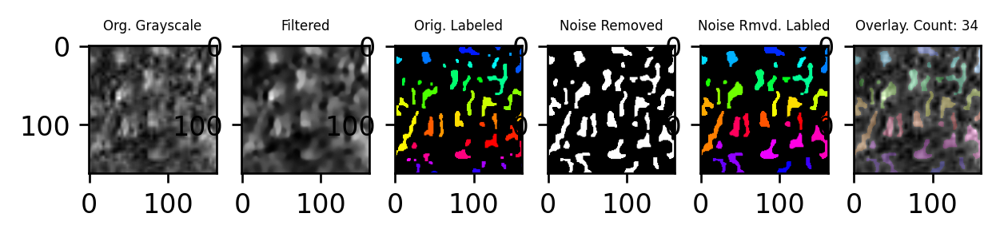

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 31
n,a [32, 173.51612903225808]
173.51612903225808


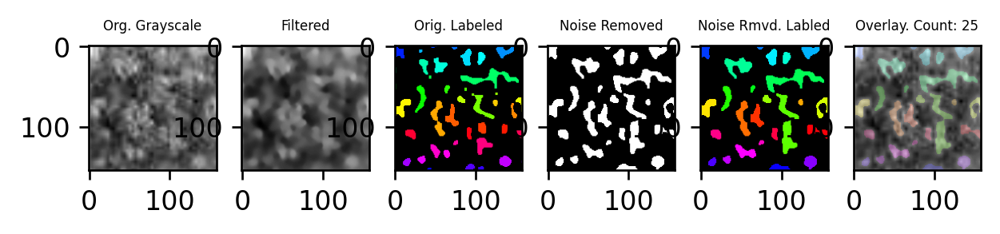

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 64
n,a [65, 121.359375]
121.359375


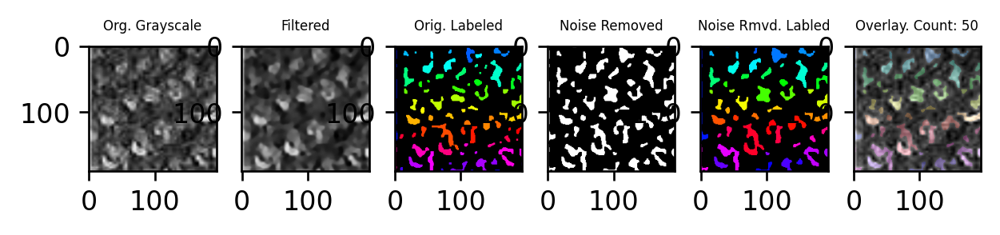

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 14
n,a [15, 22.714285714285715]
22.714285714285715


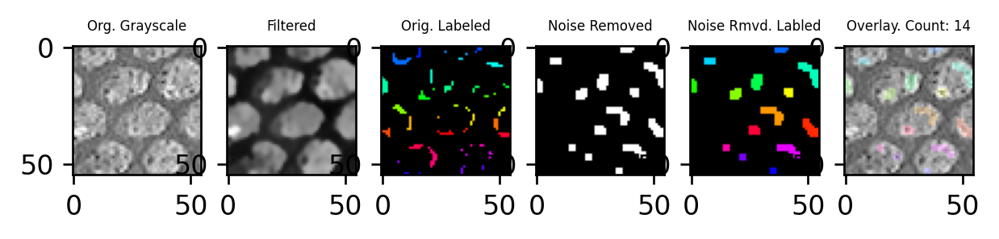

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 15
n,a [16, 18.8]
18.8


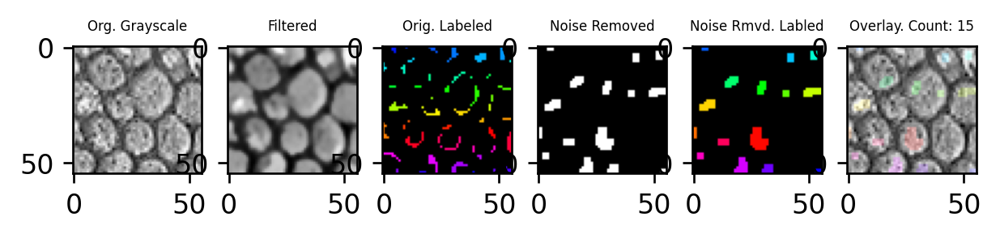

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 47
n,a [48, 98.25531914893617]
98.25531914893617


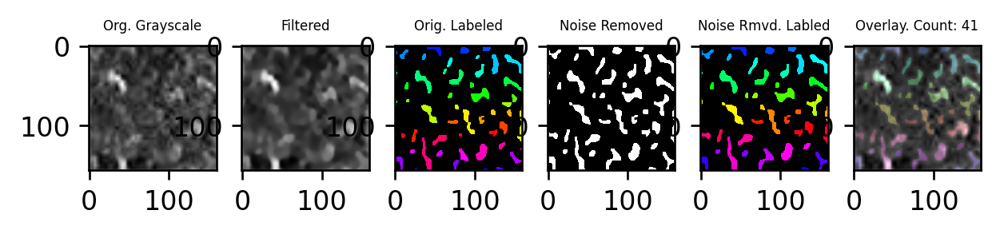

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 14
n,a [15, 20.928571428571427]
20.928571428571427


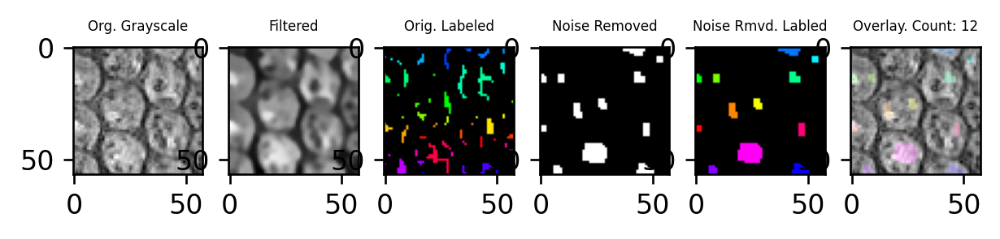

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 12
n,a [13, 10.666666666666666]
10.666666666666666


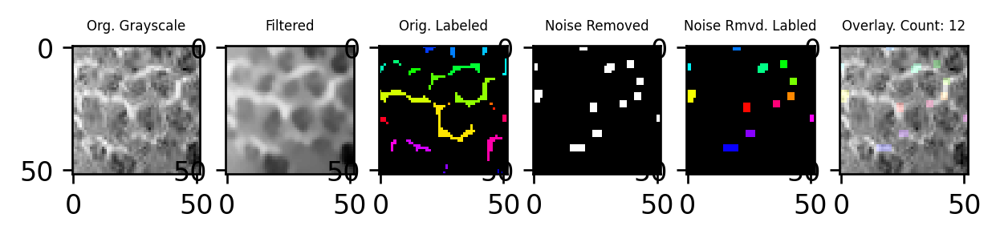

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 40
n,a [41, 166.125]
166.125


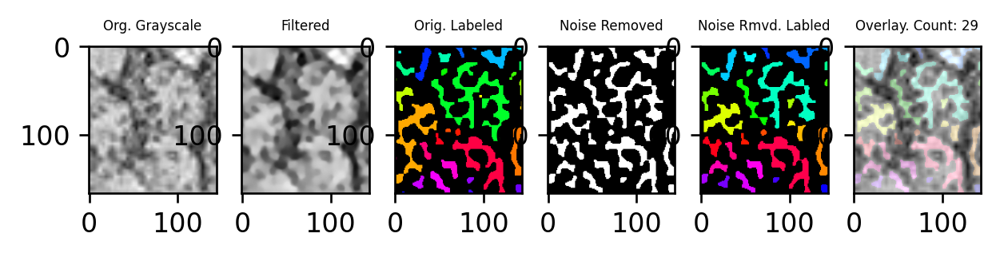

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 53
n,a [54, 3.150943396226415]
3.150943396226415


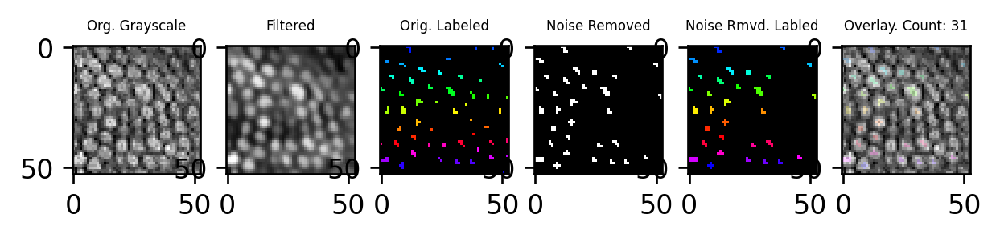

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 3
n,a [4, 8.0]
8.0


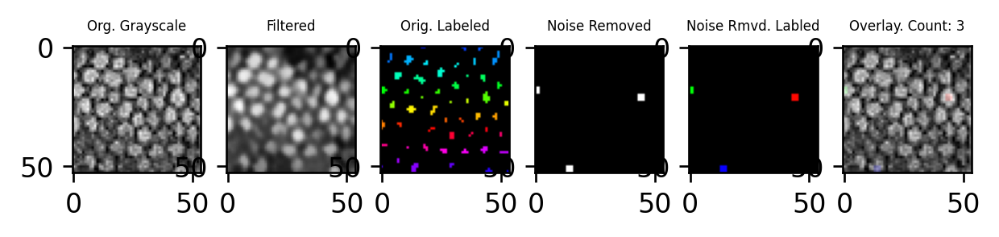

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 27
n,a [28, 327.0740740740741]
327.0740740740741


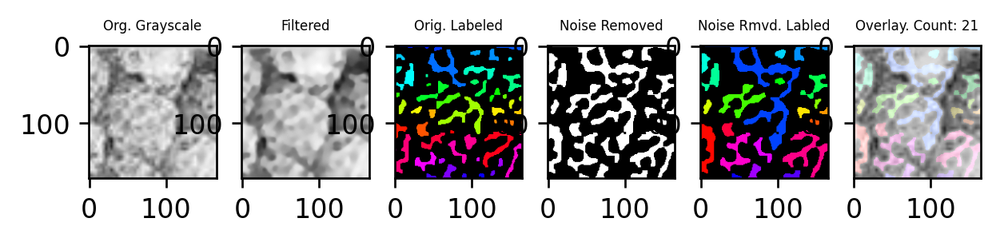

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 4
n,a [5, 7.5]
7.5


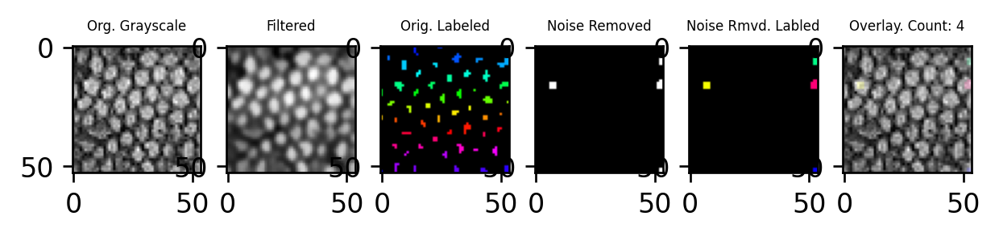

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 21
n,a [22, 424.4761904761905]
424.4761904761905


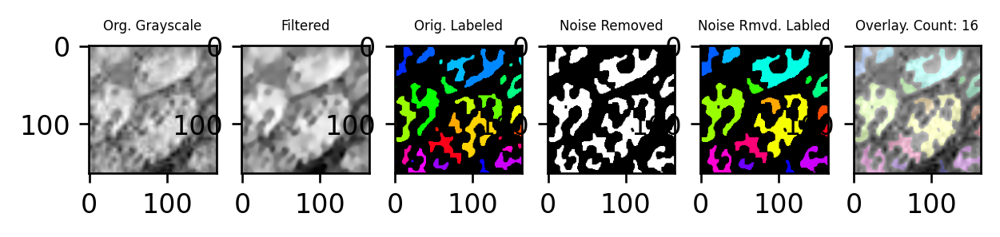

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 10
n,a [11, 646.0]
646.0


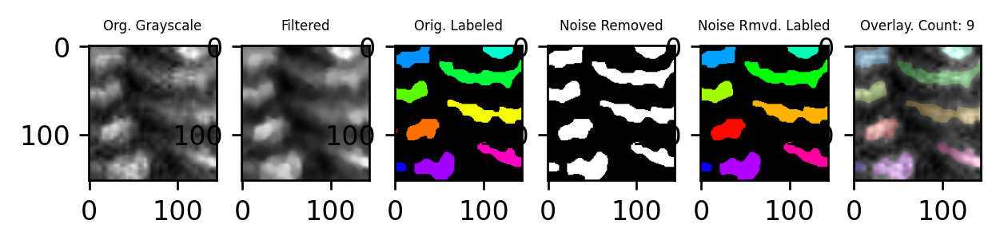

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 10
n,a [11, 49.3]
49.3


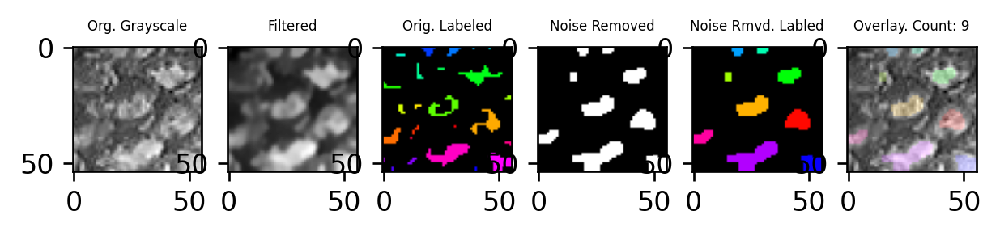

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 11
n,a [12, 88.18181818181819]
88.18181818181819


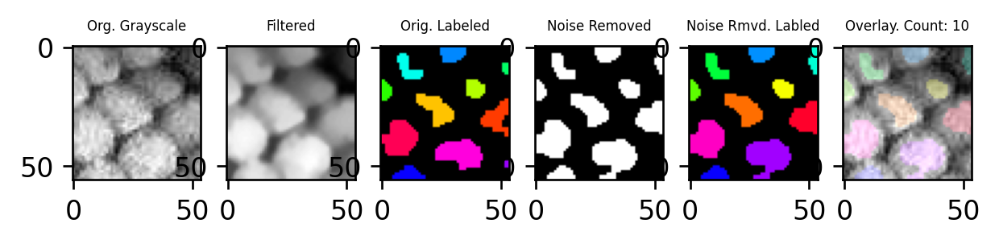

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 9
n,a [10, 796.6666666666666]
796.6666666666666


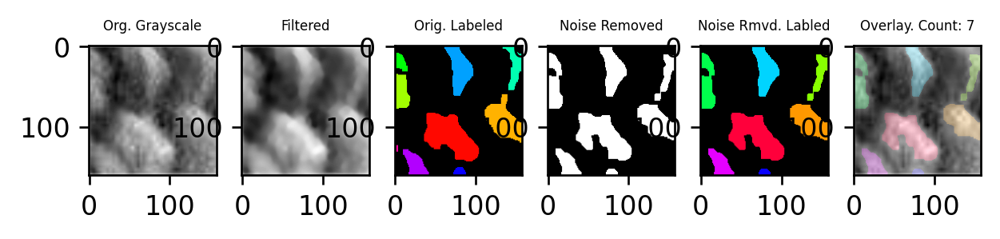

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 17
n,a [18, 22.705882352941178]
22.705882352941178


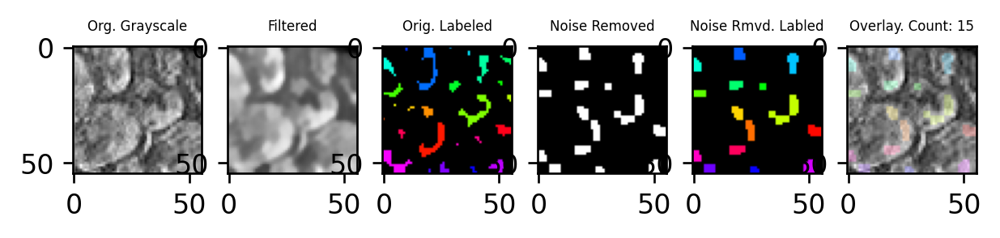

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 25
n,a [26, 76.76]
76.76


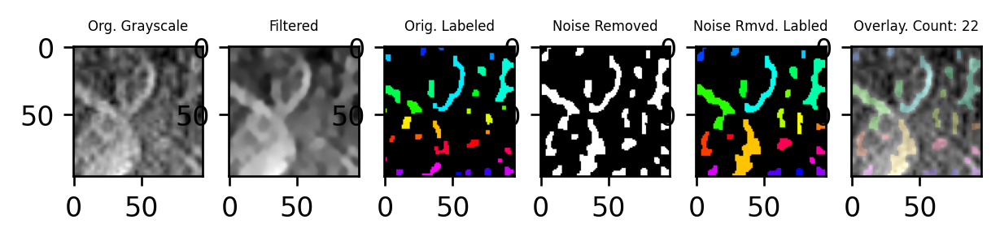

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 32
n,a [33, 194.9375]
194.9375


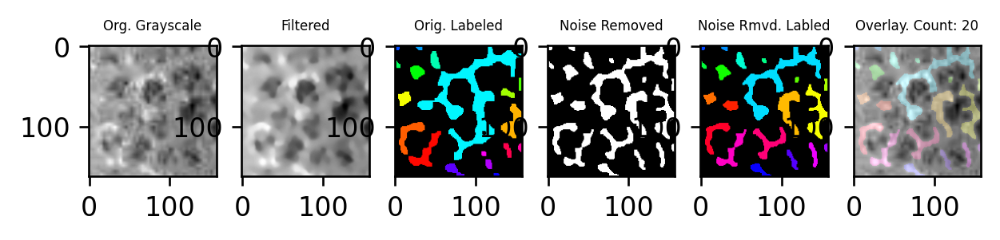

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 21
n,a [22, 188.95238095238096]
188.95238095238096


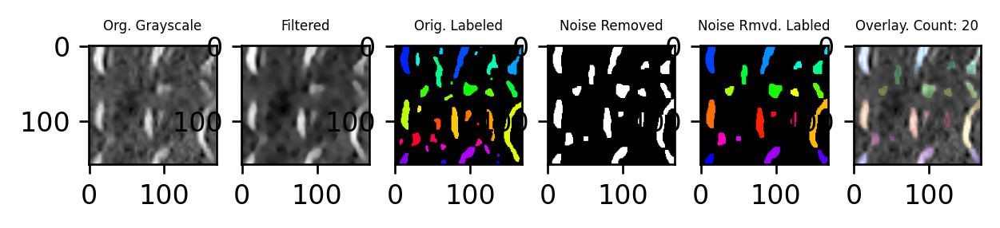

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
scales: 26
n,a [27, 275.5]
275.5


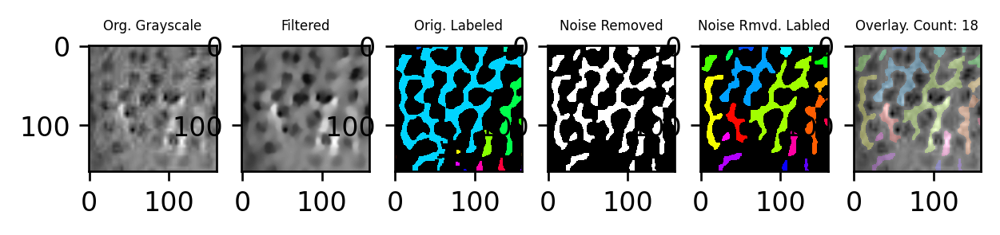

In [28]:
without_r = []
#find a way to draw the contors to see what is detected
#use a different thing????

print("TRYING TO CLEAN UP THE IMAGES AND REMOVE SMALL SPECKELS: SHOULD TAKE INTO ACCOUNT DISTANCE AND SIZE")

index = 0;
final_counts = []

print("Images", len(images))
for img in thr:
    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S)
    stats = output[2]


    kernel = np.ones((3,3),np.uint8)
    #opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel, iterations=1)
    #closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations = 1)

    
    #review: what exactly does this do?
    cnts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    print(len(cnts))
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]

    
    print("scales:", len(cnts))
    print("n,a", average_size[index])
    
    
    for c in cnts:
        area = cv2.contourArea(c)
        if area < (averages[index]/10):
            img = cv2.drawContours(img, [c], -1, (0,0,0), -1)
            
    print(averages[index])



    plt.subplot(1,6,1), plt.imshow(original_img[index], 'gray')
    plt.title("Org. Grayscale", fontsize=5)
    plt.subplot(1,6,2), plt.imshow(filter_img[index], 'gray')
    plt.title("Filtered", fontsize=5)
    plt.subplot(1,6,3), plt.imshow(labeled_imgs[index], 'gray')
    plt.title("Orig. Labeled", fontsize=5)
    plt.subplot(1,6,4), plt.imshow(img, 'gray')
    plt.title("Noise Removed", fontsize=5)


    # Label and count (taken from maggie's code)
    # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
    count, labels = cv2.connectedComponents(img)                
    count = count - 1 # background doesn't count as a scale
    label_hue = np.uint8(179 * labels / np.max(labels))
    blank_ch = 255 * np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
    labeled_img[label_hue == 0] = 0
    without_r.append(labeled_img)

    plt.subplot(1, 6, 5), plt.imshow(labeled_img, 'gray')
    plt.title("Noise Rmvd. Labled", fontsize=5)
    plt.subplot(1, 6, 6), plt.imshow(overlay(original_img[index], labeled_img))
    
    final_counts.append(count)
    plt.title("Overlay. Count: " + str(count), fontsize=5)
    
    

    plt.show()
    index = index + 1





In [ ]:
#thoughtss
#average shortest distance works when not super big and super small: everything is roughtly the same size, or there are
#some lumps that otsu did not catch: where things are unfortunatley smushed together: it is better at preserving scales that
#multiple big clumps = scales, and not noise: one big clump = probably noise